In [2]:
import pandas as pd
pd.set_option('display.max_columns', None)

import plotly.express as px
import plotly.graph_objects as go
from datetime import datetime
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import warnings
warnings.filterwarnings("ignore")

sns.set(rc={'figure.figsize':(15,8)})

path_to_catalog=r'C:\Users\kgrzebien\Desktop\python_tasks\kupony\fast_kpi\\'

# slownik rozmiar si

In [2]:
df_slownik=pd.read_csv('../../słowniki/slownikid.csv',#slownikid.csv',
                       encoding='Cp1250',
                        sep="|",
                      low_memory=False)

In [111]:
for i in df_slownik.columns:
    if "ROZ" in i:
        print(i)


NR_ROZP_UE
TOLER_ROZM
ROZMIARSI
ROZM_KALK


In [10]:
df_kod_tema_with_rozmiar_si=df_slownik.merge(df[['KOD_TEMA']].drop_duplicates(), how='inner', on='KOD_TEMA')[['ROZMIARSI','KOD_TEMA']].drop_duplicates()

In [13]:
df_kod_tema_with_rozmiar_si.loc[df_kod_tema_with_rozmiar_si['ROZMIARSI']==' '].count()

ROZMIARSI    56
KOD_TEMA     56
dtype: int64

In [65]:
df_kod_tema_with_rozmiar_si['KOD_TEMA'].nunique()

11595

In [66]:
df['KOD_TEMA'].nunique()

11596

In [15]:
print(df_kod_tema_with_rozmiar_si.groupby(['ROZMIARSI']).agg({'KOD_TEMA':'nunique'})['KOD_TEMA'].sum())
print(2227/11595*100)

7996
19.20655454937473


In [23]:
33/7955*100

0.41483343808925205

In [16]:
##########
#########
###########
#df=df.merge(df_slownik[['KOD_TEMA','TYP_TOWARU']].drop_duplicates(), how='left', on='KOD_TEMA')
##########
#########
###########

In [60]:
242/293889*100

0.0823440142366676

In [114]:
df_kod_tema_with_rozmiar_si.groupby(['ROZMIARSI']).agg({'KOD_TEMA':'nunique'}).sort_values(by='KOD_TEMA')[-50:]

,KOD_TEMA
ROZMIARSI,
300 x 250 cm,2
305,2
360 cm,2
285,2
280cm,2
45 cm,3
260,3
295 x 160 cm,4
135 x 245 cm,4


In [20]:
df_kod_tema_with_rozmiar_si.groupby(['ROZMIARSI']).agg({'KOD_TEMA':'nunique'}).sort_values(by='KOD_TEMA')[:25]

,KOD_TEMA
ROZMIARSI,
"szerokość 8 cm, marszczenie 1:2",1
325 cm,1
40 cm,1
305 cm,1
5 cm,1
297 cm,1
295,1
"szerokość 10 cm, marszczenie 1:3",1
50 cm,1


In [44]:
def func_rozmiar_si(str_x):
    if str_x=='':
        return 0
    
    if 'cm' in str_x:
        return str_x.split('cm')[0]
    elif str_x[0]=='0':
        return str(float(str_x.replace(',','.'))*100)
    else: return str_x

df_kod_tema_with_rozmiar_si['ROZMIARSI_short']=df_kod_tema_with_rozmiar_si['ROZMIARSI'].apply(lambda x: x.split(' ')[1] if x[0]=='s' else (x.split(' ')[0]))
df_kod_tema_with_rozmiar_si['ROZMIARSI_short']=df_kod_tema_with_rozmiar_si['ROZMIARSI_short'].apply(lambda x: func_rozmiar_si(x))
df_kod_tema_with_rozmiar_si['ROZMIARSI_short']=df_kod_tema_with_rozmiar_si['ROZMIARSI_short'].astype(float)

In [23]:
df_kod_tema_with_rozmiar_si['ROZMIARSI'].nunique()

75

In [32]:
df_kod_tema_with_rozmiar_si['ROZMIARSI_short'].nunique()

45

In [45]:
df_kod_tema_with_rozmiar_si['ROZMIARSI_short'].unique()

array([280., 290., 300., 140., 180.,   0., 320., 145.,  45.,  60.,  90.,
       150., 310., 265., 250., 330., 170.,   4., 295., 305., 270., 260.,
       160.,   1., 340., 147., 135., 285.,   8., 120.,  30., 325., 315.,
         5., 335., 175.,  10.,  70.,  50.,  40., 230., 360., 297.])

In [51]:
df_kod_tema_with_rozmiar_si['KOD_TEMA'].nunique()

7996

In [52]:
df['KOD_TEMA'].nunique()

7996

In [49]:
56/df_kod_tema_with_rozmiar_si['KOD_TEMA'].nunique()*100

0.7003501750875438

# func preprocessing

In [3]:
def func_str_to_float(s):
    s=s.astype(str)
    s=s.apply(lambda x: x.replace(',','.'))
    s=s.astype(float)
    return s



def func_date(df, min_date):
    df['date_start']=df['Z_DNIA']+' '+df['CZAS_POCZ']
    df['date_start']=pd.to_datetime(df['date_start'], format='%y/%m/%d %H:%M:%S')
    df['date_start']=df['date_start'].dt.floor('Min')
    df['date_finish']=df['Z_DNIA']+' '+df['CZAS_KON']
    df['date_finish']=pd.to_datetime(df['date_finish'], format='%y/%m/%d %H:%M:%S')
    df['date_finish']=df['date_finish'].dt.floor('Min')
    df['Z_DNIA']=pd.to_datetime(df['Z_DNIA'], format='%y/%m/%d')
    
    df=df.loc[df['Z_DNIA']>=np.datetime64(min_date)].reset_index().drop('index', axis=1)
    df['year']=df['Z_DNIA'].apply(lambda x: x.year)
    df['month']=df['Z_DNIA'].apply(lambda x: x.month)
    df['day_of_year']=df['Z_DNIA'].apply(lambda x: x.timetuple().tm_yday)
    df['week']=df['Z_DNIA'].apply(lambda x: x.isocalendar()[1])
    df['week_day']=df['Z_DNIA'].apply(lambda x: x.isocalendar()[2])
    df['year_month']=df['year'].astype(str)+'-'+df['month'].astype(str)+'-'+'01'
    df['year_month']=df['year_month'].apply(lambda x: x[:5]+'0'+x[5:] if len(x)==9 else x)
    df['year_month']=pd.to_datetime(df['year_month'], format='%Y-%m-%d')
    df['year_week']=df['year'].astype(str)+'--'+df['week'].astype(str)
    df['year_week']=df['year_week'].apply(lambda x: x[:6]+'0'+x[6:] if len(x)==7 else x)
    df['year_day']=df['year'].astype(str)+'--'+df['day_of_year'].astype(str)
    df['year_day']=df['year_day'].apply(lambda x: x[:6]+'0'+x[6:] if len(x)<9 else x)
    
    for i in ['CZAS_POCZ','CZAS_KON']:
        df[i+'_hour']=df[i].str.split(':')
        df[i+'_hour']=df[i+'_hour'].apply(lambda x: x[0])
        df[i+'_minutes']=df[i].str.split(':')
        df[i+'_minutes']=df[i+'_minutes'].apply(lambda x: x[1])
        df[i+'_hour_minutes']=df[i+'_hour']+':'+df[i+'_minutes']
        df[i+'_hour']=df[i+'_hour'].astype(int)
        df[i+'_minutes']=df[i+'_minutes'].astype(int)
        
    df=df.loc[df['CZAS_POCZ_hour']>=4].loc[df['CZAS_POCZ_hour']<=23].loc[df['CZAS_KON_hour']>=5].loc[df['CZAS_KON_hour']<=24].reset_index().drop('index', axis=1)
    #df['zmiana']=df['CZAS_KON'].apply(lambda x: 'pierwsza' if x<='14:00' else 'druga')
    return df

def func_add_name_workers(df, name_of_file_with_workers):
    df_pracownicy=pd.read_excel(name_of_file_with_workers)
    df_pracownicy['NUMER']=df_pracownicy['NUMER']#.astype(str)
    df=df.merge(df_pracownicy, how='left', left_on='TNACA1', right_on='NUMER')
    df=df.drop('NUMER', axis=1)
    df=df.rename(columns={'PELNANAZWA':'TNACA1_NAZWISKO'})
    df=df.merge(df_pracownicy, how='left', left_on='TNACA2', right_on='NUMER')
    df=df.drop('NUMER', axis=1)
    df=df.rename(columns={'PELNANAZWA':'TNACA2_NAZWISKO'})

    df['TNACA1_NAZWISKO']=df['TNACA1_NAZWISKO'].apply(lambda x: x.split(' ')[0][0]+'. '+x.split(' ')[1] if x!='NIEZNANY' else x)
    df['TNACA2_NAZWISKO']=df['TNACA2_NAZWISKO'].apply(lambda x: x.split(' ')[0][0]+'. '+x.split(' ')[1] if x!='NIEZNANY' else x)
    return df

def func_create_table(df):
    df['STOL']=df['TNACA1'].astype(str)+'-'+df['TNACA2'].astype(str)
    df['STOL_NAZWISKO']=df['TNACA1_NAZWISKO'].astype(str)+'-'+df['TNACA2_NAZWISKO'].astype(str)
    return df

def func_name_of_column_with_tnaca(name, ktora_tnaca_nazwisko):
    if ktora_tnaca_nazwisko=='TNACA1_NAZWISKO':
        name=name+'tnaca1'
    else: 
        name=name+'tnaca2'
    return name

def func_add_first_and_last_date_workers_and_unique_days(df, ktora_tnaca_nazwisko):
    for i in ['min','max']:
        name=i+'_dzien_pracy_'
        name=func_name_of_column_with_tnaca(name, ktora_tnaca_nazwisko)
        
        _=df.groupby([ktora_tnaca_nazwisko]).agg({'Z_DNIA':i}).reset_index()
        _=_.rename(columns={'Z_DNIA':name})
        df=df.merge(_, how='left', on=ktora_tnaca_nazwisko)
        
    df_unikatowe_dni_tnaca=df.groupby(ktora_tnaca_nazwisko).\
                            agg(liczba_unikatowych_dni_pracy=('Z_DNIA','nunique'),
                                unikatowe_dni_pracy=('Z_DNIA','unique')).reset_index()    
    
    df_unikatowe_dni_tnaca=df_unikatowe_dni_tnaca.rename(columns={'liczba_unikatowych_dni_pracy':func_name_of_column_with_tnaca('liczba_unikatowych_dni_pracy_',ktora_tnaca_nazwisko),
                                                                  'unikatowe_dni_pracy':func_name_of_column_with_tnaca('unikatowe_dni_pracy_',ktora_tnaca_nazwisko)})
    
    df=df.merge(df_unikatowe_dni_tnaca[[ktora_tnaca_nazwisko, func_name_of_column_with_tnaca('liczba_unikatowych_dni_pracy_',ktora_tnaca_nazwisko)]], 
                how='left', on=ktora_tnaca_nazwisko)
    return df, df_unikatowe_dni_tnaca


def func_time_for_fv(df):
    df_tmp2=df.groupby(list(set(df.columns)-set(['NAZWA', 'RODZAJ', 'KOD_TEMA', 'ILOSC']))).\
                agg({'KOD_TEMA':'count',
                     'ILOSC':'sum'}).reset_index()
    
    df_tmp2['time']=df_tmp2['date_finish']-df_tmp2['date_start']
    df_tmp2=df_tmp2.sort_values(by='time').reset_index().drop('index',axis=1)
    df_tmp2['time']=df_tmp2['time']/np.timedelta64(1,'s')/60
    df_tmp2=df_tmp2.loc[df_tmp2['time'].notnull()]
    return df_tmp2
    
    
def func_add_rozmiarsi(df, path_to_slownikid):
    df_slownik=pd.read_csv(path_to_slownikid, #'../../słowniki/slownikid.csv'
                               encoding='Cp1250',
                                sep="|",
                              low_memory=False)
    df_kod_tema_with_rozmiar_si=df_slownik.merge(df[['KOD_TEMA']].drop_duplicates(), how='inner', on='KOD_TEMA')[['ROZMIARSI','KOD_TEMA']].drop_duplicates()
    
    def func_rozmiar_si(str_x):
        if str_x=='':
            return 0

        if 'cm' in str_x:
            return str_x.split('cm')[0]
        elif str_x[0]=='0':
            return str(float(str_x.replace(',','.'))*100)
        else: return str_x
    df_kod_tema_with_rozmiar_si['ROZMIARSI_short']=df_kod_tema_with_rozmiar_si['ROZMIARSI'].apply(lambda x: x.split(' ')[1] if x[0]=='s' else (x.split(' ')[0]))
    df_kod_tema_with_rozmiar_si['ROZMIARSI_short']=df_kod_tema_with_rozmiar_si['ROZMIARSI_short'].apply(lambda x: func_rozmiar_si(x))
    df_kod_tema_with_rozmiar_si['ROZMIARSI_short']=df_kod_tema_with_rozmiar_si['ROZMIARSI_short'].astype(float)
    df=df.merge(df_kod_tema_with_rozmiar_si[['KOD_TEMA','ROZMIARSI_short']], how='left', on='KOD_TEMA')
    df=df.rename(columns={'ROZMIARSI_short':'ROZMIARSI'})
    return df

# read data

In [4]:
# TO CO PROBNIKI TO NIE BIERZEMY!!!!

In [5]:
df=pd.read_csv('../test_oracle_zamow1_zamow2_20_n13_data_n13_07.csv',#'../test_oracle_zamow1_zamow2_21_n11_n12.csv',#'../test_oracle_zamow1_zamow2_20.csv',
              encoding='Cp1250',
              sep="|")
print(len(df))

350418


In [6]:
df['ILOSC']=func_str_to_float(df['ILOSC'])
df['WARTOSC_B']=func_str_to_float(df['WARTOSC_B'])
df['WARTOSC_N']=func_str_to_float(df['WARTOSC_N'])
df=func_date(df, '2020-01-01')
df=func_add_name_workers(df, '../../pracownicy.xlsx')
df=func_create_table(df)
df, df_unikatowe_dni_tnaca = func_add_first_and_last_date_workers_and_unique_days(df, 'TNACA1_NAZWISKO')

df_with_time_per_fv=func_time_for_fv(df)
df=df.loc[df['STOL']!='0-0'].reset_index().drop('index', axis=1)

df=func_add_rozmiarsi(df, '../../słowniki/slownikid.csv')

In [7]:
df.loc[df.loc[df['TNACA1']==1840].index, 'TNACA1']=595
df.loc[df.loc[df['TNACA1']==2093].index, 'TNACA1']=537
df.loc[df.loc[df['TNACA2']==1840].index, 'TNACA2']=595
df.loc[df.loc[df['TNACA2']==2093].index, 'TNACA2']=537
df.loc[df.loc[df['TNACA2']==318].index, 'TNACA2']=1841

In [7]:
df.loc[df['year']==2021]['ILOSC'].sum()

735339.8

# czas bez zamowien

## RCP

### read data

In [13]:
def func_date_rcp(df):
    
    df=df.loc[df['GODZ_ROZ']!=' '].loc[df['GODZ_ZAK']!=' '].reset_index().drop('index', axis=1)
    
    df['date_start']=df['DATA']+' '+df['GODZ_ROZ']
    df['date_start']=pd.to_datetime(df['date_start'], format='%y/%m/%d %H:%M:%S')
    df['date_start']=df['date_start'].dt.floor('Min')
    df['date_finish']=df['DATA']+' '+df['GODZ_ZAK']
    df['date_finish']=pd.to_datetime(df['date_finish'], format='%y/%m/%d %H:%M:%S')
    df['date_finish']=df['date_finish'].dt.floor('Min')
    df['DATA']=pd.to_datetime(df['DATA'], format='%y/%m/%d')
    
    return df



def func_correct_time(df_ewid_rcp):
    ind=df_ewid_rcp.loc[df_ewid_rcp['GODZ_ROZ']==df_ewid_rcp['GODZ_ZAK']].loc[df_ewid_rcp['ID_ZAD']=='ZP0000003424'].index
    for i in ind:
        new_hour_finish=str(int(df_ewid_rcp.loc[i, 'GODZ_ROZ'][:2])+8)
        df_ewid_rcp.loc[i, 'GODZ_ZAK']=new_hour_finish+':00:00'
    
        
    df_ewid_rcp=df_ewid_rcp.loc[df_ewid_rcp['GODZ_ROZ']<=df_ewid_rcp['GODZ_ZAK']]
    
    ind=df_ewid_rcp.loc[df_ewid_rcp['GODZ_ROZ']==df_ewid_rcp['GODZ_ZAK']].loc[df_ewid_rcp['ID_ZAD']=='ZP0000000996'].index
    for i in ind:
        s=df_ewid_rcp.loc[i, 'GODZ_ROZ']
        df_ewid_rcp.loc[i, 'GODZ_ZAK']=s[:3]+'0'+str(int(s[3:5])+1)+s[5:]
    return df_ewid_rcp

In [14]:
%%time

def func_read_csv(name):
    df=pd.read_csv(name,
                  encoding='Cp1250',
                  sep="|")
    df=df.loc[df['IS_DELETED']=='N']
    return df


df_grup_rcp=func_read_csv('../../RCP_tables/GRUP_RCP.csv')
df_zad_rcp=func_read_csv('../../RCP_tables/ZAD_RCP.csv')
df_ewid_rcp=func_read_csv('../../RCP_tables/EWID_RCP.csv')

df_ewid_rcp=func_correct_time(df_ewid_rcp)
df_ewid_rcp=func_date_rcp(df_ewid_rcp)

df_ewid_rcp_total=df_ewid_rcp.copy()
df_ewid_rcp_total=df_ewid_rcp_total.loc[(df_ewid_rcp_total['DATA']>=df['Z_DNIA'].min()) & (df_ewid_rcp_total['DATA']<=df['Z_DNIA'].max())]

df_ewid_rcp=df_ewid_rcp.loc[(df_ewid_rcp['KOD_OPER'].isin(df['TNACA1'].unique()))|(df_ewid_rcp['KOD_OPER'].isin(df['TNACA2'].unique()))]
df_ewid_rcp=df_ewid_rcp.loc[(df_ewid_rcp['DATA']>=df['Z_DNIA'].min()) & (df_ewid_rcp['DATA']<=df['Z_DNIA'].max())]

df_rcp=df_ewid_rcp[['ID_ZAD','DATA','ROZ_DNIA','ZAK_DNIA','GODZ_PL','DATA_ROZ','GODZ_ROZ','DATA_ZAK','GODZ_ZAK','KOD_OPER', 'date_start', 'date_finish']].\
                merge(df_zad_rcp[['ID_ZAD','ZADANIE']].drop_duplicates(),
                      how='left', on='ID_ZAD')
df_rcp_total=df_ewid_rcp_total[['ID_ZAD','DATA','ROZ_DNIA','ZAK_DNIA','GODZ_PL','DATA_ROZ','GODZ_ROZ','DATA_ZAK','GODZ_ZAK','KOD_OPER', 'date_start', 'date_finish']].\
                merge(df_zad_rcp[['ID_ZAD','ZADANIE']].drop_duplicates(),
                      how='left', on='ID_ZAD')

CPU times: total: 9.23 s
Wall time: 9.55 s


In [15]:
df_operatorzy_do_usuniecia_z_rcp=df_ewid_rcp.loc[df_ewid_rcp['KOD_OPER'].isin(np.sort(df['TNACA1'].unique()))].\
                                            groupby(['KOD_OPER','DATA']).agg(KOD_GR_RCP_unique=('KOD_GR_RCP','unique'),
                                                                            KOD_GR_RCP_nunique=('KOD_GR_RCP','nunique')).reset_index().\
                                            merge(df[['TNACA1','TNACA1_NAZWISKO']].drop_duplicates(), how='left', left_on='KOD_OPER', right_on='TNACA1')#.to_excel(path_to_catalog+'usun_operator_czy_caly_dzien.xlsx')

df_operatorzy_do_usuniecia_z_rcp['KOD_GR_RCP_unique_str']=df_operatorzy_do_usuniecia_z_rcp['KOD_GR_RCP_unique'].apply(lambda x: ','.join(x))
df_operatorzy_do_usuniecia_z_rcp=df_operatorzy_do_usuniecia_z_rcp.loc[df_operatorzy_do_usuniecia_z_rcp['KOD_GR_RCP_nunique']==1].\
                                                                loc[~((df_operatorzy_do_usuniecia_z_rcp['KOD_GR_RCP_unique_str'].str.contains('KUP')) | (df_operatorzy_do_usuniecia_z_rcp['KOD_GR_RCP_unique_str'].str.contains('L4')))]\
                                    [['KOD_OPER','TNACA1_NAZWISKO']].drop_duplicates().sort_values(by='TNACA1_NAZWISKO').reset_index()

In [28]:
# df_ewid_rcp.loc[df_ewid_rcp['KOD_OPER'].isin(np.sort(df['TNACA1'].unique()))].\
#     sort_values(by=['DATA','GODZ_ROZ']).\
#     groupby(['KOD_OPER','DATA']).agg(KOD_GR_RCP_first=('KOD_GR_RCP','first'),
#                                     KOD_GR_RCP_unique=('KOD_GR_RCP','unique')).reset_index().\
# merge(df[['TNACA1','TNACA1_NAZWISKO']].drop_duplicates(), how='left', left_on='KOD_OPER', right_on='TNACA1').to_excel(path_to_catalog+'usun_operator_co_pierwsze.xlsx')

In [16]:
df_rcp['zadanie_group']=df_rcp['ZADANIE'].apply(lambda x: 'KUPONY-REALIZACJA ZAMÓWIENIA' if x=='KUPONY-REALIZACJA ZAMÓWIENIA' \
                                                                                       else ('kupony_inne' if x[:6]=='KUPONY'\
                                                                                                            else 'pomoc' if x[-5:]=='POMOC' \
                                                                                                                         else ('nieobecnosc' if x in ['CHOROBOWE', 'NIEOBECNOŚĆ CAŁODNIOWA USPRAWI', 'OPIEKA', 'URLOP'] else 'inne')))
df_rcp_total['zadanie_group']=df_rcp_total['ZADANIE']


### zmiany per day

In [11]:
def func_zmiany_wedlug_rcp(df_rcp,
                           ile_zmian=2, plot=False):
    _=df_rcp.groupby(['DATA','KOD_OPER']).agg({'GODZ_ROZ':'min',
                                              'GODZ_ZAK':'max'}).reset_index()
    _['hour_start']=_['GODZ_ROZ'].apply(lambda x: float(x[:2])+float(x[3:5])/60)
    _['hour_finish']=_['GODZ_ZAK'].apply(lambda x: float(x[:2])+float(x[3:5])/60)
    if plot:
        sns.histplot(_[['hour_start','hour_finish']],
                    kde=True,
                    bins=30,
                    stat='percent')

        # fig=px.histogram(_, x="hour")
        # fig.show()
    if ile_zmian==2:
        _['zmiana']=_['hour_start'].apply(lambda x: 'pierwsza' if x<11 else 'druga')
    else:
        _['zmiana']=_['hour_start'].apply(lambda x: 'pierwsza' if x<6.3 else ('inny_stol' if x<11 else 'druga'))
        
    return _[['DATA','KOD_OPER','zmiana']].drop_duplicates()

,DATA,KOD_OPER,zmiana
0,2020-01-02,119,pierwsza
1,2020-01-02,152,pierwsza
2,2020-01-02,191,pierwsza
3,2020-01-02,196,pierwsza
4,2020-01-02,199,pierwsza
...,...,...,...
30763,2022-06-30,1918,pierwsza
30764,2022-06-30,1919,pierwsza
30765,2022-06-30,1938,pierwsza
30766,2022-06-30,1948,pierwsza


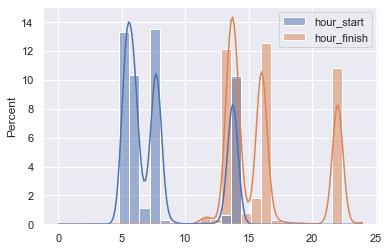

In [12]:
func_zmiany_wedlug_rcp(df_rcp, ile_zmian=2, plot=True)

### calculate

In [285]:
def func_minutes_in_work_day_rcp(df, tnaca1_numer):
    step=np.datetime64('2000-01-01 00:02:00')-np.datetime64('2000-01-01 00:01:00')
    
    df_with_minutes=pd.DataFrame(columns=['KOD_OPER', 'DATA', 'ile_minut_czynnosc', 'ile_minut_dzien', 'procent_wykorzystania', 'zadanie','zadanie_group'])
    
    for day in (df.loc[df['KOD_OPER']==tnaca1_numer]['DATA'].unique()):
        arr_time_day=np.array([], dtype='datetime64')
        arr_time_activity=np.array([], dtype='int')
        arr_zadanie=[]
        arr_zadanie_group=[]
        try:
            for i in (df.loc[df['KOD_OPER']==tnaca1_numer].loc[df['DATA']==day].index):
                arr_tmp=np.arange(df.loc[i,'date_start'],
                                  df.loc[i,'date_finish'],
                                 step)
                arr_time_day=np.append(arr_time_day, arr_tmp)
                arr_time_activity=np.append(arr_time_activity, [len(arr_tmp)])
                arr_zadanie=np.append(arr_zadanie, [df.loc[i,'ZADANIE']])
                arr_zadanie_group=np.append(arr_zadanie_group, [df.loc[i,'zadanie_group']])

            if len(arr_time_day)==0:
                display(day)
            ile_minut_maksymalnie=(arr_time_day.max()-arr_time_day.min())/np.timedelta64(1,'m')+1
            for time_activity, zadanie, zadanie_group in zip(arr_time_activity, arr_zadanie, arr_zadanie_group ):
                df_with_minutes=df_with_minutes.append({'KOD_OPER':tnaca1_numer,
                                                        'DATA':day,
                                                        'ile_minut_czynnosc':time_activity,
                                                        'ile_minut_dzien':ile_minut_maksymalnie,
                                                       'procent_wykorzystania':time_activity/ile_minut_maksymalnie*100, 
                                                        'zadanie':zadanie,
                                                        'zadanie_group':zadanie_group},
                                                       ignore_index=True)
        except:
            pass
        
    
    return df_with_minutes

In [286]:
#tmp_tnaca_1688 = func_minutes_in_work_day_rcp(df_rcp, 1688)

df_with_minutes_rcp=pd.DataFrame()
#flaga=0
for tnaca1 in tqdm(np.unique(np.append(df['TNACA1'].unique(), df['TNACA2'].unique()))):
    try:
        if tnaca1 == 0:
            continue

        df_with_minutes_tmp=func_minutes_in_work_day_rcp(df_rcp,
                                                             tnaca1)
        df_with_minutes_rcp=df_with_minutes_rcp.append(df_with_minutes_tmp,
                                                          ignore_index=True)
    except:
        print(tnaca1)
        continue
    # if flaga==3:
    #     break
    # else:
    #     flaga+=1

 17%|██████████████▏                                                                  | 18/103 [02:33<16:32, 11.68s/it]

numpy.datetime64('2020-12-08T00:00:00.000000000')

100%|████████████████████████████████████████████████████████████████████████████████| 103/103 [26:18<00:00, 15.33s/it]


#### kupony -pomoc (przez inne dzialy)

In [147]:
df_with_minutes_rcp_kupony_pomoc=pd.DataFrame()
#flaga=0
for tnaca1 in tqdm(df_rcp_total.loc[df_rcp_total['ZADANIE'].str.contains('KUPONY -POMOC')]['KOD_OPER'].unique()):
    try:
        if tnaca1 == 0:
            continue

        df_with_minutes_tmp=func_minutes_in_work_day_rcp(df_rcp_total.loc[df_rcp_total['ZADANIE'].str.contains('KUPONY -POMOC')],
                                                             tnaca1)
        df_with_minutes_rcp_kupony_pomoc=df_with_minutes_rcp.append(df_with_minutes_tmp,
                                                                      ignore_index=True)
    except:
        print(tnaca1)
        continue


 13%|██████████▊                                                                        | 3/23 [00:01<00:11,  1.75it/s]

634


100%|██████████████████████████████████████████████████████████████████████████████████| 23/23 [00:47<00:00,  2.05s/it]


In [151]:
df_with_minutes_rcp_kupony_pomoc=func_year_month_from_rcp(df_with_minutes_rcp_kupony_pomoc)


In [164]:
df_with_minutes_rcp_kupony_pomoc.loc[df_with_minutes_rcp_kupony_pomoc['zadanie']=='KUPONY -POMOC'].\
groupby('year_month').agg({'ile_minut_czynnosc':'sum',
                          'KOD_OPER':'nunique'})

,ile_minut_czynnosc,KOD_OPER
year_month,,
2020-05-01,10242,6
2020-07-01,26071,9
2020-08-01,409,2
2020-11-01,26708,10
2020-12-01,50567,10
2021-01-01,4638,6
2021-03-01,6170,5
2021-05-01,1354,2
2021-06-01,5553,1


### wizualizacje

In [8]:
# df_with_minutes_rcp.to_excel(path_to_catalog+'df_with_minutes_rcp_2.xlsx')
df_with_minutes_rcp=pd.read_excel(path_to_catalog+'df_with_minutes_rcp_2.xlsx').drop('Unnamed: 0', axis=1)
df_with_minutes_rcp['DATA']=pd.to_datetime(df_with_minutes_rcp['DATA'], format='%y-%m-%d')

#### funkcje grupujące i opisy zadan

In [9]:
def func_year_month_from_rcp(df):
    df['year']=df['DATA'].apply(lambda x: x.year)
    df['month']=df['DATA'].apply(lambda x: x.month)
    df['year_month']=df['year'].astype(str)+'-'+df['month'].astype(str)+'-'+'01'
    df['year_month']=df['year_month'].apply(lambda x: x[:5]+'0'+x[5:] if len(x)==9 else x)
    df['year_month']=pd.to_datetime(df['year_month'], format='%Y-%m-%d')
    df['week']=df['DATA'].apply(lambda x: x.isocalendar()[1])
    df['year_week']=df['year'].astype(str)+'--'+df['week'].astype(str)
    df['year_week']=df['year_week'].apply(lambda x: x[:6]+'0'+x[6:] if len(x)==7 else x)
    return df

df_with_minutes_rcp=func_year_month_from_rcp(df_with_minutes_rcp)

In [10]:
df_with_minutes_rcp['zadania_ogolnie_5_grupy']=df_with_minutes_rcp['zadanie'].apply(lambda x: '1 - KUPONY-REALIZACJA ZAMÓWIENIA' if x=='KUPONY-REALIZACJA ZAMÓWIENIA' \
                                                                                       else ('1 - kupony_inne' if x[:6]=='KUPONY'\
                                                                                                            else 'inne' if x[-5:]=='POMOC' \
                                                                                                                         else ('nieobecnosc' if x in ['CHOROBOWE', 'NIEOBECNOŚĆ CAŁODNIOWA USPRAWI', 'OPIEKA', 'URLOP',
                                                                                                                                                     'URLOP OKOLICZNOŚCIOWY - urlop','Wyjście prywatne','IZOLACJA DOMOWA',
                                                                                                                                                      'L4-OPIEKA','OPIEKA - KOR-8LAT','ZASIŁEK','KWARANTANNA','WOLNE ZA ŚWIĘTO',
                                                                                                                                                      'N-PRACA ZDALNA','NN'] \
                                                                                                                                               else ('targi' if x in ['TARGI'] else 'inne'))))
df_with_minutes_rcp['zadania_ogolnie_3_grupy']=df_with_minutes_rcp['zadanie'].apply(lambda x: '1-kupony' if x[:6]=='KUPONY' \
                                                                                                        else '2-inne' if x[-5:]=='POMOC' \
                                                                                                                    else ('3-nieobecnosc' if x in ['CHOROBOWE', 'NIEOBECNOŚĆ CAŁODNIOWA USPRAWI', 'OPIEKA', 'URLOP',
                                                                                                                                                     'URLOP OKOLICZNOŚCIOWY - urlop','Wyjście prywatne','IZOLACJA DOMOWA',
                                                                                                                                                      'L4-OPIEKA','OPIEKA - KOR-8LAT','ZASIŁEK','KWARANTANNA','WOLNE ZA ŚWIĘTO',
                                                                                                                                                      'N-PRACA ZDALNA','NN'] \
                                                                                                                                            else '2-inne'))

df_with_minutes_rcp['zadania_ogolnie_4_grupy']=df_with_minutes_rcp['zadanie'].apply(lambda x: '1-kupony' if x[:6]=='KUPONY' \
                                                                                                        else '2-pomoc' if x[-5:]=='POMOC' \
                                                                                                                    else ('4-nieobecnosc' if x in ['CHOROBOWE', 'NIEOBECNOŚĆ CAŁODNIOWA USPRAWI', 'OPIEKA', 'URLOP',
                                                                                                                                                     'URLOP OKOLICZNOŚCIOWY - urlop','Wyjście prywatne','IZOLACJA DOMOWA',
                                                                                                                                                      'L4-OPIEKA','OPIEKA - KOR-8LAT','ZASIŁEK','KWARANTANNA','WOLNE ZA ŚWIĘTO',
                                                                                                                                                      'N-PRACA ZDALNA','NN'] \
                                                                                                                                            else '3-inne'))

In [11]:
def func_minutes_rcp_group(df_with_minutes_rcp,
                          arr_group,
                          wzgledny_czy_bezwzgledny):
    
    if wzgledny_czy_bezwzgledny=='wzgledny':
        if 'KOD_OPER' in arr_group:
            _tmp=df_with_minutes_rcp.groupby([arr_group[0]]+['DATA','KOD_OPER']).agg({'ile_minut_dzien':'first'}).reset_index().groupby([arr_group[0]]+['KOD_OPER']).agg({'ile_minut_dzien':'sum'}).reset_index()
            _tmp_nieobecnosc=df_with_minutes_rcp.loc[df_with_minutes_rcp[arr_group[1]].str.contains('nieobecnosc')].groupby([arr_group[0]]+['KOD_OPER']).agg(czas_nieobecnosc=('ile_minut_czynnosc','sum')).reset_index()#groupby([arr_group[0]]+['DATA','KOD_OPER']).agg({'ile_minut_dzien':'first'}).reset_index().\
                                                                                                                    
            _tmp=_tmp.merge(_tmp_nieobecnosc, how='left', on=[arr_group[0]]+['KOD_OPER'])
            _tmp['czas_nieobecnosc']=_tmp['czas_nieobecnosc'].fillna(0)
            _tmp['ile_minut_dzien']=_tmp['ile_minut_dzien']-_tmp['czas_nieobecnosc']
            _tmp=_tmp[[arr_group[0]]+['KOD_OPER']+['ile_minut_dzien']]
        elif arr_group[0]=='DATA':
            _tmp=df_with_minutes_rcp.groupby([arr_group[0]]+['KOD_OPER']).agg({'ile_minut_dzien':'first'}).reset_index().groupby(arr_group[0]).agg({'ile_minut_dzien':'sum'}).reset_index()
        else:
            _tmp=df_with_minutes_rcp.groupby([arr_group[0]]+['DATA','KOD_OPER']).agg({'ile_minut_dzien':'first'}).reset_index().groupby(arr_group[0]).agg({'ile_minut_dzien':'sum'}).reset_index()
        df_with_minutes_rcp_group=df_with_minutes_rcp.groupby(arr_group).agg({'ile_minut_czynnosc':'sum'}).reset_index()
        if 'KOD_OPER' in arr_group:
            df_with_minutes_rcp_group=df_with_minutes_rcp_group.merge(_tmp, how='left', on=[arr_group[0]]+['KOD_OPER'])
        else:
            df_with_minutes_rcp_group=df_with_minutes_rcp_group.merge(_tmp, how='left', on=arr_group[0])
        df_with_minutes_rcp_group['procent_wykorzystania']=df_with_minutes_rcp_group['ile_minut_czynnosc']/df_with_minutes_rcp_group['ile_minut_dzien']*100
    else:
        df_with_minutes_rcp_group=df_with_minutes_rcp.groupby(arr_group).agg({'procent_wykorzystania':'sum'}).reset_index()
        
        
    return df_with_minutes_rcp_group
        

In [17]:
# df_with_minutes_rcp_group=func_minutes_rcp_group(df_with_minutes_rcp.loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
#                                                   ['DATA','zadania_ogolnie_3_grupy'],
#                                                   'wzgledny')

df_with_minutes_rcp_group=func_minutes_rcp_group(df_with_minutes_rcp.loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
                                                  ['year_week','zadania_ogolnie_4_grupy'],
                                                  'wzgledny')

# df_with_minutes_rcp_group=func_minutes_rcp_group(df_with_minutes_rcp.loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
#                                                   ['year_month','zadania_ogolnie_4_grupy'],
#                                                   'wzgledny')

# df_with_minutes_rcp_group=func_minutes_rcp_group(df_with_minutes_rcp,
#                                                   ['year_month','zadania_ogolnie_3_grupy'],
#                                                   'bezwzgledny')

#### pivot tabeli - Agata

In [18]:
def func_minutes_rcp_group_pivot_years(df,
                                        col_zadania,
                                       col_date,
                                      year1,
                                      year2,
                                      month_week):
    if 'year' in df.columns:
        pass
    else:
        try:
            df['year']=df[col_date].apply(lambda x: x.year)
        except:
            df['year']=df[col_date].apply(lambda x: x[:4])
            
    if 'month' in df.columns:
        pass
    else:
        try:
            df['month']=df[col_date].apply(lambda x: x.month)
        except:
            pass
        
    if 'week' in df.columns:
        pass
    else:
        df['week']=df[col_date].apply(lambda x: x[-2:])
        
#     arr_zadania=df[col_zadania].unique()
#     #arr_zadania_min=[i+'_minuty']
#     #arr_zadania_proc=[i+'_procent']
#     df_pivot=pd.DataFrame(columns=['month']+[col_zadania]+['ile_minut_czynnosc_2021','ile_minut_dzien_2021','procent_wykorzystania_2021',
#                                                           'ile_minut_czynnosc_2022','ile_minut_dzien_2022','procent_wykorzystania_2022'])
#     for mc in month:
#         for j in arr_zadania:
#             for col in ['ile_minut_czynnosc','ile_minut_dzien','procent_wykorzystania']:
#                 val_1=df.loc[df['year']==year1].loc[df['month']==mc].loc[df[col_zadania]==j][col].values[0]
#                 val_2=df.loc[df['year']==year2].loc[df['month']==mc].loc[df[col_zadania]==j][col].values[0]
#                 df_pivot=df_pivot.append({'month':mc,
#                                          }, ignore_index=True)
    df['year']=df['year'].astype(int)
    df_1=df.loc[df['year']==year1]
    df_2=df.loc[df['year']==year2]
    
    df_1=df_1.rename(columns={'ile_minut_czynnosc':'ile_minut_czynnosc_'+str(year1),
                              'ile_minut_dzien':'ile_minut_dzien_'+str(year1),
                              'procent_wykorzystania':'procent_wykorzystania_'+str(year1)})
    df_2=df_2.rename(columns={'ile_minut_czynnosc':'ile_minut_czynnosc_'+str(year2),
                              'ile_minut_dzien':'ile_minut_dzien_'+str(year2),
                              'procent_wykorzystania':'procent_wykorzystania_'+str(year2)})
    df_1=df_1.drop(['year']+[col_date], axis=1)
    df_2=df_2.drop(['year']+[col_date], axis=1)
    
    df=df_1.merge(df_2, how='outer', on=[col_zadania]+[month_week])
    
    arr_col_list_display=df.columns.drop([col_zadania]+[month_week])
    arr_col_list_display=[col_zadania]+[month_week]+list(arr_col_list_display)
    
    return df[arr_col_list_display]

def func_minutes_rcp_group_pivot_years_to_wide(df, col_to_pivot,
                                              cols_with_value,
                                              month_week):
    
    flaga=0
    
    for col_val in cols_with_value:
        df_tmp=df.pivot(index=month_week,
                       columns=col_to_pivot,
                       values=col_val).reset_index()
        d={}
        for col_pivot_name in df[col_to_pivot].unique():
            d[col_pivot_name]=col_pivot_name+ ' - ' +col_val
        df_tmp=df_tmp.rename(columns=d)
        if flaga==0:
            df_to_return=df_tmp.copy()
            flaga=1
        else:
            df_to_return=df_to_return.merge(df_tmp, how='outer', on=month_week)
            
    return round(df_to_return, 0)

In [19]:
df_minutes_rcp_group_pivot_years=func_minutes_rcp_group_pivot_years(df_with_minutes_rcp_group,
                                                                        'zadania_ogolnie_4_grupy',
                                                                       'year_week',
                                                                      2021,
                                                                      2022,
                                                                   'week')

In [213]:
df_minutes_rcp_group_pivot_years_to_wide=func_minutes_rcp_group_pivot_years_to_wide(df_minutes_rcp_group_pivot_years, 
                                                                                       'zadania_ogolnie_4_grupy',
                                                                                          ['procent_wykorzystania_2021', 'procent_wykorzystania_2022',
                                                                                          'ile_minut_czynnosc_2021','ile_minut_czynnosc_2022'],
                                                                                   'week')

df_minutes_rcp_group_pivot_years_to_wide.to_excel(path_to_catalog+'df_minutes_rcp_group4_pivot_week_to_wide.xlsx')

In [274]:
df_minutes_rcp_group_pivot_years.to_excel(path_to_catalog+'df_minutes_rcp_group_pivot_years.xlsx')

#### wykresy

<AxesSubplot:xlabel='procent_wykorzystania', ylabel='Count'>

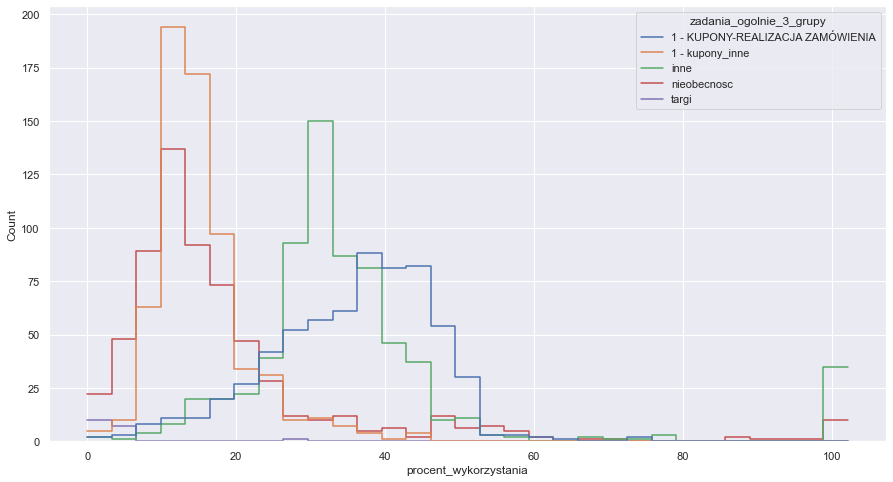

In [194]:
sns.histplot(df_with_minutes_rcp_group[['procent_wykorzystania','zadania_ogolnie_3_grupy']],
             x='procent_wykorzystania',
            hue='zadania_ogolnie_3_grupy',
            element="step",
            fill=False)

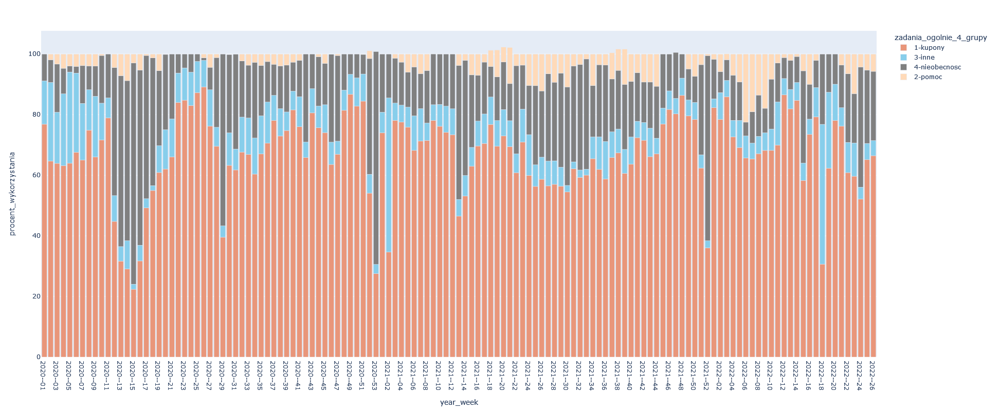

In [78]:
# px.bar(df_with_minutes_rcp_group,
#         x='year_month',#'DATA',
#        y='procent_wykorzystania',
#        color='zadania_ogolnie_3_grupy',
#        height=800,
#       color_discrete_map={
#         '1 - KUPONY-REALIZACJA ZAMÓWIENIA': 'darksalmon',
#         '1 - kupony_inne': 'peachpuff',
#           'inne':'skyblue',
#           'nieobecnosc':'grey'
#     })


fig=px.bar(df_with_minutes_rcp_group,
        x='year_week',#'year_month',#'DATA',
       y='procent_wykorzystania',
       color='zadania_ogolnie_4_grupy',
       height=800,
      color_discrete_map={
        '1-kupony': 'darksalmon',
          '2-pomoc': 'peachpuff',
        '3-inne':'skyblue',
          '4-nieobecnosc':'grey'
    })
fig.write_html(path_to_catalog+'df_with_minutes_rcp_4group_month.html')
fig.show()

In [219]:
df_with_minutes_rcp_group.loc[df_with_minutes_rcp_group['zadania_ogolnie_4_grupy'].isin(['3-inne','2-pomoc'])].\
groupby('year_week').agg({'procent_wykorzystania':'sum'})['procent_wykorzystania'].median()

12.383752659070911

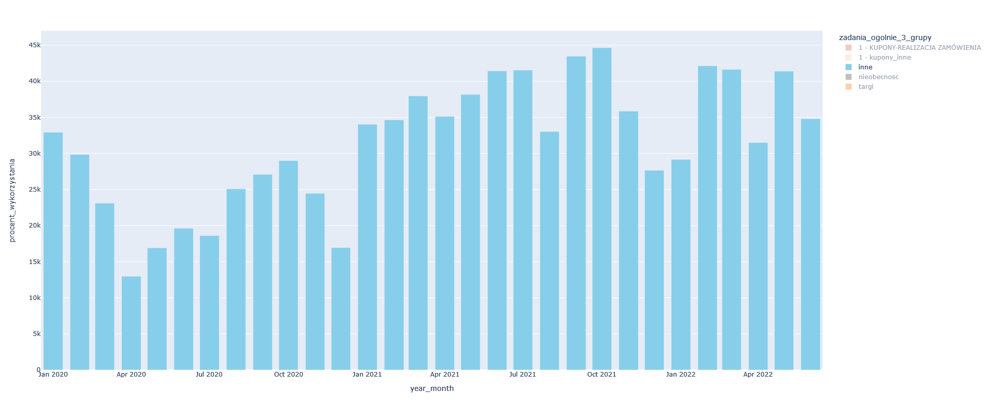

In [223]:
px.bar(df_with_minutes_rcp_group,
        x='year_month',
       y='procent_wykorzystania',
       color='zadania_ogolnie_3_grupy',
       height=800,
      color_discrete_map={
        '1 - KUPONY-REALIZACJA ZAMÓWIENIA': 'darksalmon',
        '1 - kupony_inne': 'peachpuff',
          'inne':'skyblue',
          'nieobecnosc':'grey'
    })

In [231]:
__=pd.DataFrame()
__['year_month']=df_with_minutes_rcp_group['year_month'].unique()
for i in ['inne', 'nieobecnosc', '1 - KUPONY-REALIZACJA ZAMÓWIENIA',
       '1 - kupony_inne', 'targi']:
    __=__.merge(df_with_minutes_rcp_group.loc[df_with_minutes_rcp_group['zadania_ogolnie_3_grupy']==i][['year_month','procent_wykorzystania']].rename(columns={'procent_wykorzystania':i}), how='left', on='year_month')
__=__.fillna(0)
__['cale_kupony']=__['1 - KUPONY-REALIZACJA ZAMÓWIENIA']+__['1 - kupony_inne']

In [165]:
__tmp=df.groupby(['Z_DNIA','FAKTURA']).agg({'ILOSC':'sum',
                                      'WARTOSC_B':'first'}).reset_index().\
        groupby(['Z_DNIA']).agg({'FAKTURA':'nunique',
                                 'ILOSC':'sum',
                                 'WARTOSC_B':'sum'}).reset_index()
__=__.merge(__tmp, how='left', left_on='DATA', right_on='Z_DNIA')

In [232]:
__.corr(method='pearson')

,inne,nieobecnosc,1 - KUPONY-REALIZACJA ZAMÓWIENIA,1 - kupony_inne,targi,cale_kupony
inne,1.000000,-0.609185,-0.087116,-0.157529,0.352032,-0.147223
nieobecnosc,-0.609185,1.000000,-0.665683,-0.170173,-0.100113,-0.693898
1 - KUPONY-REALIZACJA ZAMÓWIENIA,-0.087116,-0.665683,1.000000,-0.063557,-0.188944,0.909254
1 - kupony_inne,-0.157529,-0.170173,-0.063557,1.000000,-0.112094,0.357611
targi,0.352032,-0.100113,-0.188944,-0.112094,1.000000,-0.223559
cale_kupony,-0.147223,-0.693898,0.909254,0.357611,-0.223559,1.000000


### osoby zatrudnione

In [52]:
def func_pracujace_tnace_mc(df_with_minutes_rcp_group,
                            df, tnace_czy_total):
    df_to_return_nunique_tnace=pd.DataFrame()
    df_to_return_unique_tnace=pd.DataFrame()
    df_group_total_value=func_add_sum_mc_tnace(df)
    
    for year_month in tqdm(df['year_month'].unique()):
        arr_unique_tnace=df_with_minutes_rcp_group.loc[df_with_minutes_rcp_group['year_month']==year_month].loc[df_with_minutes_rcp_group['zadania_ogolnie_4_grupy']=='1-kupony']['KOD_OPER'].unique()
        if tnace_czy_total=='tnace':
            df_unikatowe_nazwiska_tnacych_zamowienia=func_tnaca_nazwisko(df.loc[df['year_month']==year_month])
            df_osoby_pracujace_w_mc=df_unikatowe_nazwiska_tnacych_zamowienia.loc[df_unikatowe_nazwiska_tnacych_zamowienia['tnaca'].isin(arr_unique_tnace)]
            liczba_osob=len(df_osoby_pracujace_w_mc)
            for i_name in df_osoby_pracujace_w_mc['TNACA_NAZWISKO'].unique():
                df_to_return_unique_tnace=df_to_return_unique_tnace.append({'year_month':year_month,
                                                                            'tnaca_nazwisko':i_name},
                                                                           ignore_index=True)
        else:
            liczba_osob=len(arr_unique_tnace)
            for i_name in arr_unique_tnace:
                _=func_tnaca_nazwisko(df)
                df_to_return_unique_tnace=df_to_return_unique_tnace.append({'year_month':year_month,
                                                                            'tnaca_nazwisko':i_name,
                                                                           'tnaca_nazwisko2':_.loc[_['tnaca']==i_name]['TNACA_NAZWISKO'].values[0]},
                                                                           ignore_index=True)
        
        df_to_return_nunique_tnace=df_to_return_nunique_tnace.append({'year_month':year_month,
                                                                    'liczba_osob':liczba_osob,
                                                                     'FAKTURA':df_group_total_value.loc[year_month, 'FAKTURA'],
                                                                     'ILOSC':df_group_total_value.loc[year_month, 'ILOSC'],
                                                                      'WARTOSC_B':df_group_total_value.loc[year_month, 'WARTOSC_B'],
                                                                      'ROZMIARSI':df_group_total_value.loc[year_month, 'ROZMIARSI'],
                                                                      'KOD_TEMA':df_group_total_value.loc[year_month, 'KOD_TEMA']
                                                                     },
                                                                   ignore_index=True)
        
        
    df_to_return_nunique_tnace=df_to_return_nunique_tnace.sort_values(by='year_month')
    
    fig=px.line(df_to_return_nunique_tnace,
               x='year_month',
               y='liczba_osob')
              #barmode='group')
    fig.show()
    
    return df_to_return_nunique_tnace, df_to_return_unique_tnace


def func_add_sum_mc_tnace(df):
    df_tmp=df.groupby(['FAKTURA','year_month']).agg({'ILOSC':'sum',
                                                      'WARTOSC_B':'first',
                                                      'ROZMIARSI':'sum',
                                                      'KOD_TEMA':'count'}).reset_index().\
                    groupby(['year_month']).agg({'FAKTURA':'nunique',
                                                 'ILOSC':'sum',
                                                  'WARTOSC_B':'sum',
                                                  'ROZMIARSI':'sum',
                                                  'KOD_TEMA':'sum'}).reset_index()
    return df_tmp.set_index('year_month')

In [75]:
df_ewid_rcp.loc[df_ewid_rcp['KOD_OPER']==537]['DATA'].max()

Timestamp('2022-05-31 00:00:00')

In [72]:
df_operatorzy_do_usuniecia_z_rcp.loc[df_operatorzy_do_usuniecia_z_rcp['KOD_OPER']==228]#['DATA'].max()

,index,KOD_OPER,TNACA1_NAZWISKO
8,4878,228,G. ŁUKAŃKO


In [65]:
_=func_tnaca_nazwisko(df)
_.loc[_['TNACA_NAZWISKO']=='G. ŁUKAŃKO']

,tnaca,TNACA_NAZWISKO
154271,228,G. ŁUKAŃKO


100%|██████████████████████████████████████████████████████████████████████████████████| 31/31 [04:32<00:00,  8.78s/it]


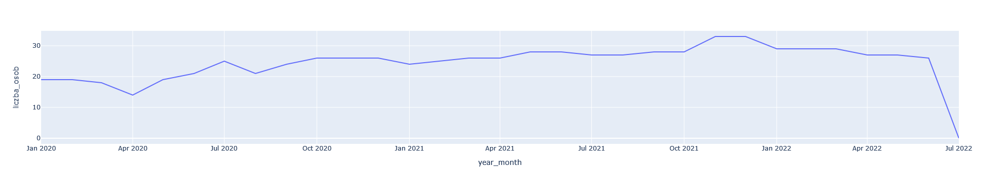

In [53]:
df_with_minutes_rcp_group=func_minutes_rcp_group(df_with_minutes_rcp.loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())].loc[df_with_minutes_rcp['zadanie']=='KUPONY-REALIZACJA ZAMÓWIENIA'],#.loc[df_with_minutes_rcp['zadanie']!='KUPONY -POMOC'],
                                                  ['year_month','zadania_ogolnie_4_grupy','KOD_OPER'],
                                                  'wzgledny')

df_nunique_pracujace_tnace, df_unique_pracujace_tnace=func_pracujace_tnace_mc(df_with_minutes_rcp_group,
                                                                                df,
                                                                             'total')

In [54]:
df_unique_pracujace_tnace

,year_month,tnaca_nazwisko,tnaca_nazwisko2
0,2021-03-01,35,A. MARSZAŁEK
1,2021-03-01,84,A. TOMASZEK
2,2021-03-01,139,E. MAJCHEREK
3,2021-03-01,322,A. OKRZESIK
4,2021-03-01,340,A. BUŁAWA
...,...,...,...
753,2022-05-01,1902,S. KARCZ
754,2022-05-01,1918,E. STASICA
755,2022-05-01,1931,E. PALA
756,2022-05-01,1938,P. WIDUCH


100%|██████████████████████████████████████████████████████████████████████████████████| 31/31 [00:16<00:00,  1.84it/s]


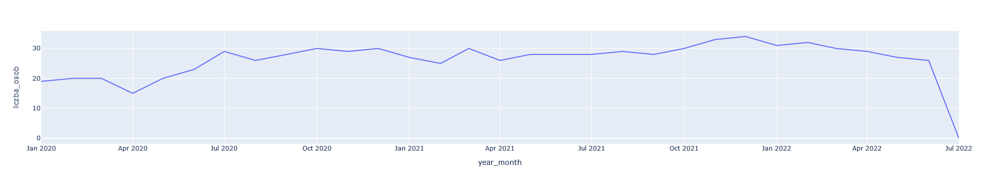

In [93]:

df_with_minutes_rcp_group=func_minutes_rcp_group(df_with_minutes_rcp.loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
                                                  ['year_month','zadania_ogolnie_4_grupy','KOD_OPER'],
                                                  'wzgledny')

df_nunique_pracujace_tnace, df_unique_pracujace_tnace=func_pracujace_tnace_mc(df_with_minutes_rcp_group,
                                                                                df,
                                                                             'tnace')

<AxesSubplot:xlabel='year_month', ylabel='tnaca_nazwisko'>

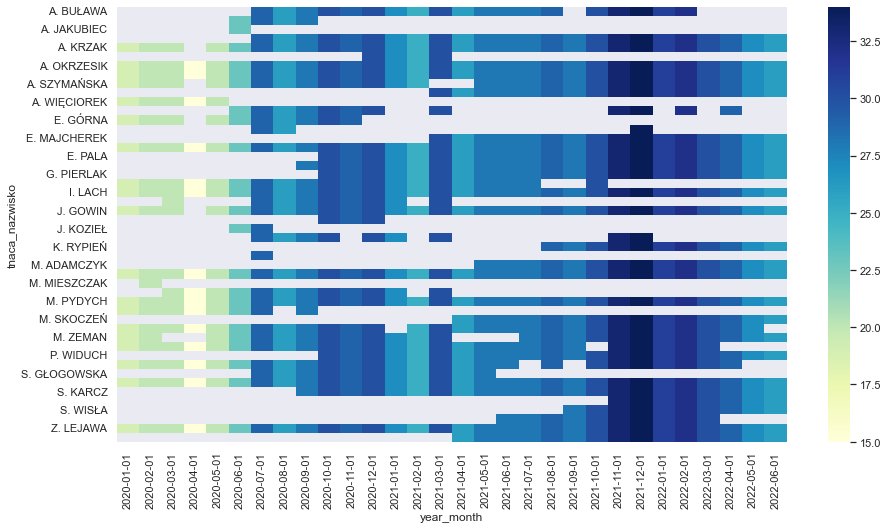

In [114]:
df_unique_pracujace_tnace['val']=1
df_unique_pracujace_tnace['year_month']=pd.to_datetime(df_unique_pracujace_tnace['year_month']).dt.strftime('%Y-%m-%d')
_=df_unique_pracujace_tnace.pivot(columns='year_month',
                                index='tnaca_nazwisko',
                                values='val')
for col0 in _.columns:
    _.loc[_.loc[_[col0].notnull()].index, col0]=_[col0].sum()
    
sns.heatmap(_,
            annot=False,
           cmap="YlGnBu")

In [55]:
df_nunique_pracujace_tnace.to_excel(path_to_catalog+'df_nunique_pracujace_tnace_total.xlsx')
df_unique_pracujace_tnace.to_excel(path_to_catalog+'df_unique_pracujace_tnace_total.xlsx')

## obliczenia

### żwawość

In [125]:
display(df.loc[df['TNACA1']==1688].loc[df['Z_DNIA']==j])

,FAKTURA,DOKUMENT,Z_DNIA,TYP_DOKUM,CZAS_POCZ,CZAS_KON,CZAS_ZAPIS,NAZWA,RODZAJ,KOD_TEMA,ILOSC,TNACA1,TNACA2,date_start,date_finish,year,month,day_of_year,week,week_day,year_month,year_week,year_day,CZAS_POCZ_hour,CZAS_POCZ_minutes,CZAS_POCZ_hour_minutes,CZAS_KON_hour,CZAS_KON_minutes,CZAS_KON_hour_minutes,zmiana,TNACA1_NAZWISKO,TNACA2_NAZWISKO,STOL,STOL_NAZWISKO,min_dzien_pracy_tnaca1,max_dzien_pracy_tnaca1,liczba_unikatowych_dni_pracy_tnaca1,time_range_minutes
2,ZO6000293671,ZM60/0293473,2021-03-02,V,13:06:11,13:24:47,13:06:21,STYLE/ZAS/GRAN,280/45194,366163,4.00,1688,1918,2021-03-02 13:06:11,2021-03-02 13:24:47,2021,3,61,9,2,2021-03-01,2021--09,2021--061,13,6,13:06,13,24,13:24,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
3,ZO6000293671,ZM60/0293473,2021-03-02,V,13:06:11,13:24:47,13:06:21,BLACKOUT/1/GRAN,280 250GSM,373647,4.00,1688,1918,2021-03-02 13:06:11,2021-03-02 13:24:47,2021,3,61,9,2,2021-03-01,2021--09,2021--061,13,6,13:06,13,24,13:24,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
34,ZO6000293667,ZM60/0293469,2021-03-02,V,13:01:48,13:24:16,13:01:57,L80/1,ROYAL,349283,4.20,1688,1918,2021-03-02 13:01:48,2021-03-02 13:24:16,2021,3,61,9,2,2021-03-01,2021--09,2021--061,13,1,13:01,13,24,13:24,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
35,ZO6000293667,ZM60/0293469,2021-03-02,V,13:01:48,13:24:16,13:01:57,P226/5,PREMIUM,357477,2.20,1688,1918,2021-03-02 13:01:48,2021-03-02 13:24:16,2021,3,61,9,2,2021-03-01,2021--09,2021--061,13,1,13:01,13,24,13:24,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
36,ZO6000293667,ZM60/0293469,2021-03-02,V,13:01:48,13:24:16,13:01:57,M147/11,ITALISSIMAM,327669,5.50,1688,1918,2021-03-02 13:01:48,2021-03-02 13:24:16,2021,3,61,9,2,2021-03-01,2021--09,2021--061,13,1,13:01,13,24,13:24,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
37,ZO6000293667,ZM60/0293469,2021-03-02,V,13:01:48,13:24:16,13:01:57,P214/6,PREMIUM,348393,4.40,1688,1918,2021-03-02 13:01:48,2021-03-02 13:24:16,2021,3,61,9,2,2021-03-01,2021--09,2021--061,13,1,13:01,13,24,13:24,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
38,ZO6000293667,ZM60/0293469,2021-03-02,V,13:01:48,13:24:16,13:01:57,P188/9,PREMIUM,71923,1.40,1688,1918,2021-03-02 13:01:48,2021-03-02 13:24:16,2021,3,61,9,2,2021-03-01,2021--09,2021--061,13,1,13:01,13,24,13:24,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
40,ZO6000293599,ZM60/0293401,2021-03-02,V,12:04:44,12:17:03,12:04:50,L72/2,ROYAL,327562,1.50,1688,1918,2021-03-02 12:04:44,2021-03-02 12:17:03,2021,3,61,9,2,2021-03-01,2021--09,2021--061,12,4,12:04,12,17,12:17,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
41,ZO6000293599,ZM60/0293401,2021-03-02,V,12:04:44,12:17:03,12:04:50,P209/7,PREMIUM,336127,0.30,1688,1918,2021-03-02 12:04:44,2021-03-02 12:17:03,2021,3,61,9,2,2021-03-01,2021--09,2021--061,12,4,12:04,12,17,12:17,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN
68,ZO6000293602,ZM60/0293404,2021-03-02,V,12:06:23,12:40:42,12:06:39,L88/16,ROYAL,354436,14.80,1688,1918,2021-03-02 12:06:23,2021-03-02 12:40:42,2021,3,61,9,2,2021-03-01,2021--09,2021--061,12,6,12:06,12,40,12:40,pierwsza,S. KAPAŁA,E. STASICA,1688-1918,S. KAPAŁA-E. STASICA,2020-01-07,2022-06-02,205,NaN


In [6]:
step=np.datetime64('2000-01-01 00:02:00')-np.datetime64('2000-01-01 00:01:00')

In [7]:
def func_minutes_in_work_day(df, tnaca1_numer, zmiana):
    df_with_minutes=pd.DataFrame(columns=['TNACA1','zmiana', 'Z_DNIA', 'ile_minut_zamowien', 'ile_minut_maksymalnie', 'procent_wykorzystania'])
    
    for day in (df.loc[df['TNACA1']==tnaca1_numer].loc[df['zmiana']==zmiana]['Z_DNIA'].unique()):
        arr_time_day=np.array([], dtype='datetime64')
        
        for i in (df.loc[df['TNACA1']==tnaca1_numer].loc[df['zmiana']==zmiana].loc[df['Z_DNIA']==day].index):
            arr_tmp=np.arange(df.loc[i,'date_start'],
                              df.loc[i,'date_finish'],
                             step)
            arr_time_day=np.append(arr_time_day, arr_tmp)
            
        ile_minut_maksymalnie=(arr_time_day.max()-arr_time_day.min())/np.timedelta64(1,'m')+1
        df_with_minutes=df_with_minutes.append({'TNACA1':tnaca1_numer,
                                                'zmiana':zmiana,
                                                'Z_DNIA':day,
                                                'ile_minut_zamowien':len(np.unique(arr_time_day)),
                                                'ile_minut_maksymalnie':ile_minut_maksymalnie,
                                               'procent_wykorzystania':len(np.unique(arr_time_day))/ile_minut_maksymalnie*100},
                                               ignore_index=True)
        # display(arr_time_day.min(), arr_time_day.max())
        # print(len(np.unique(arr_time_day)))
        # print((arr_time_day.max()-arr_time_day.min())/np.timedelta64(1,'m'))
        # break

    
    # for i in df.loc[df['TNACA1']==1688].loc[df['Z_DNIA']==day].index:#['date_start'].unique():
    #     plt.hlines(xmin=df.loc[i,'date_start'],
    #                xmax=df.loc[i,'date_finish'],
    #                y=0.5, color='red')
    #     plt.vlines(x=df.loc[i,'date_start'],
    #                ymin=0, ymax=1, color='green')
    #     plt.vlines(x=df.loc[i,'date_finish'],
    #                ymin=0, ymax=1)
    # plt.show()
    
    return df_with_minutes
    
    
df_with_minutes=pd.DataFrame()
for tnaca1 in tqdm(df['TNACA1'].unique()):
    if tnaca1 == 0:
        continue
    for zmiana in df_with_time_per_fv.loc[df_with_time_per_fv['TNACA1']==tnaca1]['zmiana'].unique():
        df_with_minutes_tmp=func_minutes_in_work_day(df_with_time_per_fv.loc[df_with_time_per_fv['time']>0],
                                                     tnaca1,
                                                    zmiana)
        df_with_minutes=df_with_minutes.append(df_with_minutes_tmp,
                                              ignore_index=True)

100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [08:07<00:00,  6.58s/it]


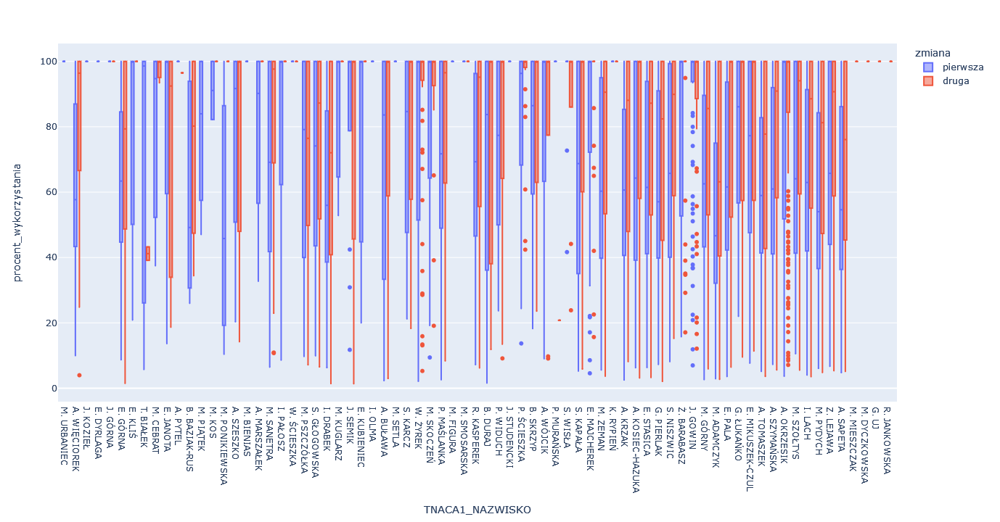

In [20]:
px.box(df_with_minutes.loc[df_with_minutes['TNACA1']!=0].merge(df[['TNACA1','TNACA1_NAZWISKO','max_dzien_pracy_tnaca1']].drop_duplicates(), how='left', on='TNACA1').sort_values(by='max_dzien_pracy_tnaca1'),
       x='TNACA1_NAZWISKO', y='procent_wykorzystania',
      color='zmiana')

In [122]:
round(df_with_minutes.loc[df_with_minutes['TNACA1']!=0].merge(df[['TNACA1','TNACA1_NAZWISKO','max_dzien_pracy_tnaca1']].drop_duplicates(), how='left', on='TNACA1').\
                                                    groupby(['zmiana']).agg({'procent_wykorzystania':'median'}).reset_index())

,zmiana,procent_wykorzystania
0,druga,92.0
1,pierwsza,65.0


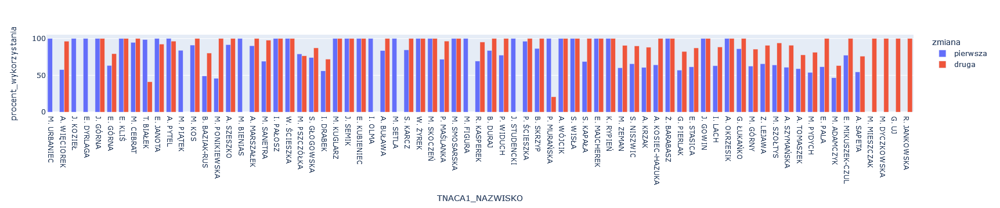

In [9]:
px.bar(df_with_minutes.loc[df_with_minutes['TNACA1']!=0].merge(df[['TNACA1','TNACA1_NAZWISKO','max_dzien_pracy_tnaca1']].drop_duplicates(), how='left', on='TNACA1').\
                                                    groupby(['TNACA1_NAZWISKO','zmiana','max_dzien_pracy_tnaca1']).agg({'procent_wykorzystania':'median'}).reset_index().\
                                                   sort_values(by='max_dzien_pracy_tnaca1'),
       x='TNACA1_NAZWISKO', y='procent_wykorzystania',
      color='zmiana',
      barmode='group')

In [95]:
df_with_minutes.loc[df_with_minutes['TNACA1']!=0].merge(df[['TNACA1','TNACA1_NAZWISKO','max_dzien_pracy_tnaca1']].drop_duplicates(), how='left', on='TNACA1').\
                                                    sort_values(by='max_dzien_pracy_tnaca1').\
                                                    groupby(['TNACA1_NAZWISKO','zmiana']).agg({'procent_wykorzystania':['mean','median']})

procent_wykorzystania            
                                           mean      median
TNACA1_NAZWISKO  zmiana                                    
A. BUŁAWA        druga                80.124980  100.000000
                 pierwsza             67.295446   83.612040
A. KOSIEC-HAZUKA druga                78.747771  100.000000
                 pierwsza             65.471283   64.305019
A. KRZAK         druga                73.946967   88.096704
...                                         ...         ...
W. ŻYREK         pierwsza             78.907522  100.000000
Z. LEJAWA        druga                78.320244   90.728477
                 pierwsza             67.754819   65.753425
Ż. BARABASZ      druga                87.879323  100.000000
                 pierwsza             76.350639  100.000000

[133 rows x 2 columns]

In [100]:
df_with_minutes.loc[df_with_minutes['TNACA1']!=0].merge(df[['TNACA1','TNACA1_NAZWISKO','max_dzien_pracy_tnaca1']].drop_duplicates(), how='left', on='TNACA1').to_excel(r'C:\Users\kgrzebien\Desktop\python_tasks\kupony\fast_kpi\\'+\
                                                                                                                                                                        'zwawosc.xlsx')

<AxesSubplot:ylabel='Count'>

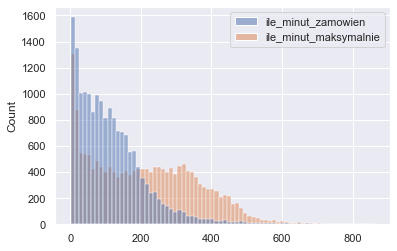

In [99]:
sns.histplot(df_with_minutes[['ile_minut_zamowien','ile_minut_maksymalnie']])

In [100]:
8*60

480

In [10]:
df_with_minutes['Z_DNIA']=pd.to_datetime(df_with_minutes['Z_DNIA'], format='%y/%m/%d %H:%M:%S')

In [11]:
df_with_minutes_with_calendary=df_with_minutes.merge(df[['Z_DNIA','year', 'month', 'day_of_year',
                                                       'week', 'week_day', 'year_month', 'year_week', 'year_day']].drop_duplicates(),
                                                  how='left', on='Z_DNIA')

In [87]:
df_with_minutes_with_calendary['TNACA1'].unique()

,TNACA1,zmiana,Z_DNIA,ile_minut_zamowien,ile_minut_maksymalnie,procent_wykorzystania,year,month,day_of_year,week,week_day,year_month,year_week,year_day
0,1688,pierwsza,2021-10-12,184,334.0,55.08982,2021,10,285,41,2,2021-10-01,2021--41,2021--285
1,1688,pierwsza,2021-11-15,58,308.0,18.831169,2021,11,319,46,1,2021-11-01,2021--46,2021--319
2,1688,pierwsza,2022-02-21,179,209.0,85.645933,2022,2,52,8,1,2022-02-01,2022--08,2022--052
3,1688,pierwsza,2021-11-03,73,283.0,25.795053,2021,11,307,44,3,2021-11-01,2021--44,2021--307
4,1688,pierwsza,2022-04-30,142,264.0,53.787879,2022,4,120,17,6,2022-04-01,2022--17,2022--120
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16360,524,pierwsza,2022-03-28,7,7.0,100.0,2022,3,87,13,1,2022-03-01,2022--13,2022--087
16361,68,pierwsza,2022-05-10,11,11.0,100.0,2022,5,130,19,2,2022-05-01,2022--19,2022--130
16362,68,pierwsza,2022-05-11,142,142.0,100.0,2022,5,131,19,3,2022-05-01,2022--19,2022--131
16363,68,druga,2022-05-10,106,510.0,20.784314,2022,5,130,19,2,2022-05-01,2022--19,2022--130


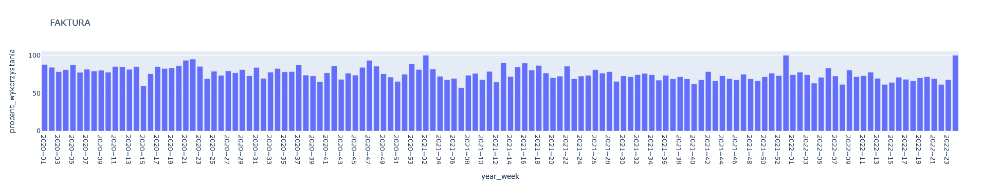

                       procent_wykorzystania   FAKTURA
procent_wykorzystania               1.000000 -0.480737
FAKTURA                            -0.480737  1.000000


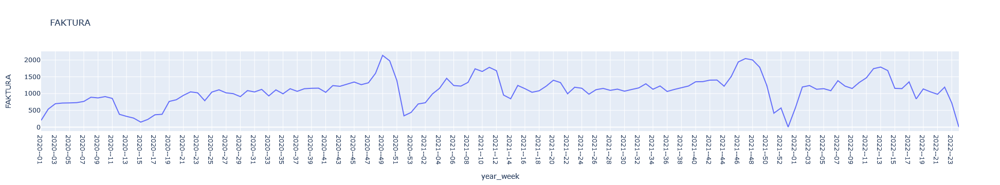

In [133]:
for i,j in zip(['FAKTURA','KOD_TEMA','ILOSC'], ['nunique','count','sum']):
    _=df.merge(df_with_minutes_with_calendary[['TNACA1','Z_DNIA']].drop_duplicates(), how='inner', on=['TNACA1','Z_DNIA']).groupby(['year_week']).agg({i:j}).reset_index()
    _=df_with_minutes_with_calendary.groupby(['year_week']).agg({'procent_wykorzystania':'median'}).reset_index().\
           merge(_, how='inner', on='year_week')
    fig=px.bar(_,
           x='year_week', y='procent_wykorzystania', title=i)
    fig.show()
    
    print(_.loc[~_['year_week'].isin([np.datetime64('2020-04-01'),np.datetime64('2022-06-01')])].corr(method='spearman'))
    
    fig=px.line(_, x='year_week', y=i, title=i)
    fig.show()
    break
    
### DODAC LICZBE ZAMOWIEN
### DLUZSZA HISTORIA ZEBY WIDZIEC SEZON
### DEFEKTY! KONIECZNIE TRZEBA JE ZNALEZC 
### CO SIE DZIEJE POZA CZASEM WYKONYWANIA ZAMOWIENIA! MOZE POMAGA W INNYM MIEJSCU - I CZY TAM SIE ODKLIKUJE

### sezonowosc

In [163]:
_=_.set_index(pd.DatetimeIndex(_['year_month'])).drop('year_month', axis=1)
_.dtypes

procent_wykorzystania    float64
FAKTURA                    int64
dtype: object

In [169]:
_.index.freq = 'MS'

In [13]:
_.index

Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29],
           dtype='int64')

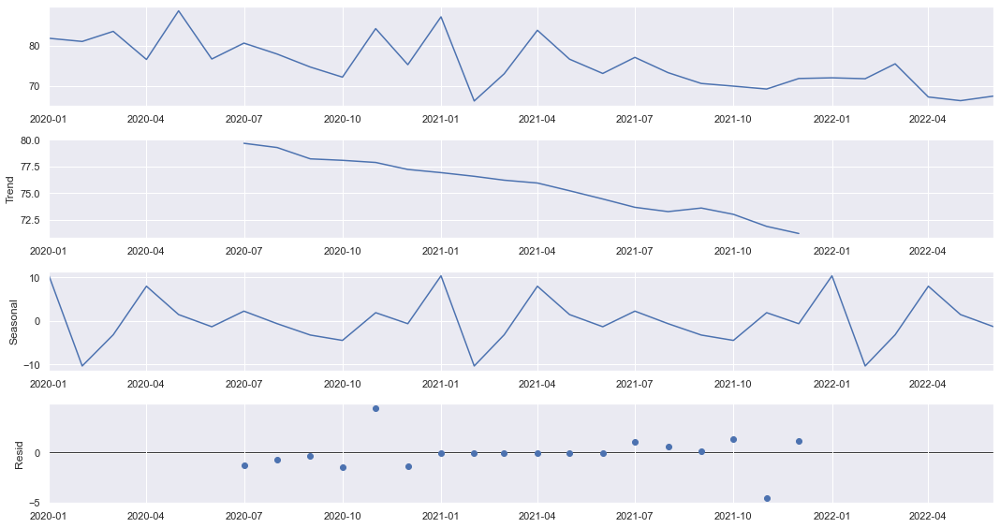

In [172]:
from statsmodels.tsa.seasonal import seasonal_decompose

decompose_result_mult = seasonal_decompose(_[['procent_wykorzystania']], model='additive')#multiplicative

trend = decompose_result_mult.trend
seasonal = decompose_result_mult.seasonal
residual = decompose_result_mult.resid

decompose_result_mult.plot();

In [64]:
_=df_with_minutes_rcp_group.loc[df_with_minutes_rcp_group['zadania_ogolnie_4_grupy'].isin(['2-pomoc','3-inne'])].copy()
_=_.groupby('year_week').agg({'procent_wykorzystania':'sum'}).reset_index()

In [25]:
__=df.groupby('year_week').agg({'Z_DNIA':'min'}).reset_index()
#_=_.set_index(pd.DatetimeIndex(_['Z_DNIA'])).drop('Z_DNIA', axis=1)
__['ile_przesunac']=__['Z_DNIA'].dt.weekday

In [27]:
for i in __.index:
    __.loc[i, 'Z_DNIA']=__.loc[i, 'Z_DNIA']-np.timedelta64(__.loc[i, 'ile_przesunac'], 'D')
#_=_.set_index(pd.DatetimeIndex(_['year_month'])).drop('year_month', axis=1)

In [55]:
_=_.merge(__[['year_week','Z_DNIA']], how='inner', on='year_week')

In [56]:
_=_.iloc[np.where(_.reset_index()['Z_DNIA'].duplicated() == False)[0]]

In [65]:
_=_.set_index(pd.DatetimeIndex(_['Z_DNIA'])).drop('Z_DNIA', axis=1)
_=_.sort_index()

# _=_.set_index(pd.DatetimeIndex(_['year_month'])).drop('year_month', axis=1)
# _.dtypes

procent_wykorzystania    float64
dtype: object

In [66]:

_.index.freq = 'W-MON'

# _.index.freq = 'MS'

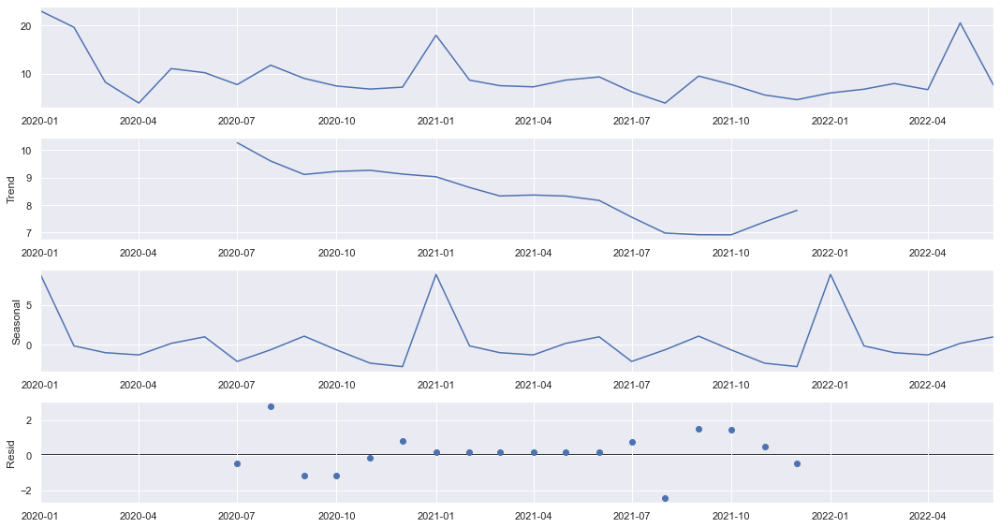

In [67]:
from statsmodels.tsa.seasonal import seasonal_decompose

decompose_result_mult = seasonal_decompose(_[['procent_wykorzystania']], model='additive')#multiplicative

trend = decompose_result_mult.trend
seasonal = decompose_result_mult.seasonal
residual = decompose_result_mult.resid

decompose_result_mult.plot();

# fast kpi

## big view - liczby

In [168]:
def func_dynamiki(df__, col):
    arr=[0]
    for i in range(1,len(df__)):
        arr=np.append(arr,(df__.iloc[i][col]/df__.iloc[i-1][col]-1)*100)
    df__['Dynamika']=arr
    df__['Dynamika']=round(df__['Dynamika'],2)
    return df__


def func_liczby_1group(df, group, agg, text_print1, text_print2):
    print(text_print1)
    display(df.groupby(group).agg(agg))
    print(text_print2)
    df_tmp=df.loc[df['month']<=df.loc[df['year']==2022]['month'].max()-1].groupby(group).agg(agg)
    df_tmp=func_dynamiki(df_tmp, list(agg.keys())[0])
    display(df_tmp)

def func_liczby_2group(df, group1, agg1, group2, agg2, text_print1,text_print2):
    print(text_print1)
    display(round(df.groupby(group1).agg(agg1).reset_index().groupby(group2).agg(agg2), 1))
    print(text_print2)
    df_tmp=round(df.loc[df['month']<=df.loc[df['year']==2022]['month'].max()-1].groupby(group1).agg(agg1).reset_index().groupby(group2).agg(agg2), 1)
    df_tmp=func_dynamiki(df_tmp, list(agg2.keys())[0])
    display(df_tmp)
    

In [197]:
func_liczby_1group(df, 
                    ['year'],#['year','TNACA1_NAZWISKO'], 
                    {'FAKTURA':'nunique'},
                  'Unikatowe faktury na rok:',
                  'Unikatowe faktury na rok - do czerwca:')
func_liczby_2group(df, 
                    ['year','month'], 
                    {'FAKTURA':'nunique'}, 
                    ['year'], 
                    {'FAKTURA':'mean'},
                  'Unikatowe faktury na rok - średnio miesięcznie:',
                  'Unikatowe faktury na rok - średnio miesięcznie - do czerwca:')
func_liczby_2group(df, 
                    ['year','week'], 
                    {'FAKTURA':'nunique'}, 
                    ['year'], 
                    {'FAKTURA':'mean'},
                  'Unikatowe faktury na rok - średnio tygodniowo:',
                  'Unikatowe faktury na rok - średnio tygodniowo - do czerwca:')
func_liczby_2group(df, 
                    ['year','day_of_year'], 
                    {'FAKTURA':'nunique'}, 
                    ['year'], 
                    {'FAKTURA':'mean'},
                  'Unikatowe faktury na rok - średnio na dzien:',
                  'Unikatowe faktury na rok - średnio na dzien - do czerwca:')

Unikatowe faktury na rok:


,FAKTURA
year,
2020,48802
2021,64506
2022,31793


Unikatowe faktury na rok - do czerwca:


,FAKTURA,Dynamika
year,,
2020,17709,0.00
2021,31156,75.93
2022,30518,-2.05


Unikatowe faktury na rok - średnio miesięcznie:


,FAKTURA
year,
2020,4066.8
2021,5375.5
2022,4541.9


Unikatowe faktury na rok - średnio miesięcznie - do czerwca:


,FAKTURA,Dynamika
year,,
2020,2951.5,0.00
2021,5192.7,75.93
2022,5086.3,-2.05


Unikatowe faktury na rok - średnio tygodniowo:


,FAKTURA
year,
2020,920.8
2021,1217.1
2022,1096.3


Unikatowe faktury na rok - średnio tygodniowo - do czerwca:


,FAKTURA,Dynamika
year,,
2020,655.9,0.00
2021,1153.9,75.93
2022,1130.3,-2.05


Unikatowe faktury na rok - średnio na dzien:


,FAKTURA
year,
2020,182.8
2021,246.2
2022,239.0


Unikatowe faktury na rok - średnio na dzien - do czerwca:


,FAKTURA,Dynamika
year,,
2020,138.4,0.00
2021,247.3,78.68
2022,242.2,-2.06


In [198]:
func_liczby_1group(df, 
                    ['year'], 
                    {'ILOSC':'sum'},
                  'Ilość na rok:',
                  'Ilość na rok - do czerwca:')
func_liczby_2group(df, 
                    ['year','month'], 
                    {'ILOSC':'sum'}, 
                    ['year'], 
                    {'ILOSC':'mean'},
                  'Ilość na rok - średnio miesięcznie:',
                  'Ilość na rok - średnio miesięcznie - do czerwca:')
func_liczby_2group(df, 
                    ['year','week'], 
                    {'ILOSC':'sum'}, 
                    ['year'], 
                    {'ILOSC':'mean'},
                  'Ilość na rok - średnio tygodniowo:',
                  'Ilość na rok - średnio tygodniowo - do czerwca:')
func_liczby_2group(df, 
                    ['year','day_of_year'], 
                    {'ILOSC':'sum'}, 
                    ['year'], 
                    {'ILOSC':'mean'},
                  'Ilość na rok - średnio na dzien:',
                  'Ilość na rok - średnio na dzien - do czerwca:')

Ilość na rok:


,ILOSC
year,
2020,605466.41
2021,735339.80
2022,359780.13


Ilość na rok - do czerwca:


,ILOSC,Dynamika
year,,
2020,233794.06,0.00
2021,338856.89,44.94
2022,345346.63,1.92


Ilość na rok - średnio miesięcznie:


,ILOSC
year,
2020,50455.5
2021,61278.3
2022,51397.2


Ilość na rok - średnio miesięcznie - do czerwca:


,ILOSC,Dynamika
year,,
2020,38965.7,0.00
2021,56476.1,44.94
2022,57557.8,1.92


Ilość na rok - średnio tygodniowo:


,ILOSC
year,
2020,11423.9
2021,13874.3
2022,12406.2


Ilość na rok - średnio tygodniowo - do czerwca:


,ILOSC,Dynamika
year,,
2020,8659.0,0.00
2021,12550.3,44.94
2022,12790.6,1.91


Ilość na rok - średnio na dzien:


,ILOSC
year,
2020,2267.7
2021,2806.6
2022,2705.1


Ilość na rok - średnio na dzien - do czerwca:


,ILOSC,Dynamika
year,,
2020,1826.5,0.00
2021,2689.3,47.24
2022,2740.8,1.91


In [170]:
func_liczby_2group(df, 
                    ['year','month','TNACA1_NAZWISKO'], 
                    {'ILOSC':'sum'}, 
                    ['year','TNACA1_NAZWISKO'], 
                    {'ILOSC':'mean'},
                  'Ilość na rok - średnio miesięcznie:',
                  'Ilość na rok - średnio miesięcznie - do czerwca:')

Ilość na rok - średnio miesięcznie:


ILOSC
year TNACA1_NAZWISKO         
2020 A. BUŁAWA         1502.0
     A. KOSIEC-HAZUKA  2035.8
     A. KRZAK          3929.7
     A. MARSZAŁEK         1.5
     A. OKRZESIK        563.2
...                       ...
2022 S. NISZWIC        3584.2
     S. WISŁA           163.2
     W. ŻYREK           182.8
     Z. LEJAWA         1870.9
     Ż. BARABASZ         87.6

[149 rows x 1 columns]

Ilość na rok - średnio miesięcznie - do czerwca:


ILOSC  Dynamika
year TNACA1_NAZWISKO                  
2020 A. OKRZESIK       126.7      0.00
     A. SAPETA        1029.4    712.47
     A. SZYMAŃSKA      257.3    -75.00
     A. WIĘCIOREK     3697.3   1336.96
     B. SKRZYP         574.4    -84.46
...                      ...       ...
2022 S. NISZWIC       3953.3   1660.94
     S. WISŁA          203.6    -94.85
     W. ŻYREK          182.8    -10.22
     Z. LEJAWA        2085.2   1040.70
     Ż. BARABASZ        57.2    -97.26

[115 rows x 2 columns]

In [199]:
func_liczby_1group(df, 
                    ['year'], 
                    {'KOD_TEMA':'count'},
                  'KOD_TEMA na rok:',
                  'KOD_TEMA na rok - do czerwca:')
func_liczby_2group(df, 
                    ['year','month'], 
                    {'KOD_TEMA':'count'}, 
                    ['year'], 
                    {'KOD_TEMA':'mean'},
                  'KOD_TEMA na rok - średnio miesięcznie:',
                  'KOD_TEMA na rok - średnio miesięcznie - do czerwca:')
func_liczby_2group(df, 
                    ['year','week'], 
                    {'KOD_TEMA':'count'}, 
                    ['year'], 
                    {'KOD_TEMA':'mean'},
                  'KOD_TEMA na rok - średnio tygodniowo:',
                  'KOD_TEMA na rok - średnio tygodniowo - do czerwca:')
func_liczby_2group(df, 
                    ['year','day_of_year'], 
                    {'KOD_TEMA':'count'}, 
                    ['year'], 
                    {'KOD_TEMA':'mean'},
                  'KOD_TEMA na rok - średnio na dzien:',
                  'KOD_TEMA na rok - średnio na dzien - do czerwca:')

KOD_TEMA na rok:


,KOD_TEMA
year,
2020,108474
2021,126990
2022,62123


KOD_TEMA na rok - do czerwca:


,KOD_TEMA,Dynamika
year,,
2020,40496,0.00
2021,59693,47.40
2022,59268,-0.71


KOD_TEMA na rok - średnio miesięcznie:


,KOD_TEMA
year,
2020,9039.5
2021,10582.5
2022,8874.7


KOD_TEMA na rok - średnio miesięcznie - do czerwca:


,KOD_TEMA,Dynamika
year,,
2020,6749.3,0.00
2021,9948.8,47.40
2022,9878.0,-0.71


KOD_TEMA na rok - średnio tygodniowo:


,KOD_TEMA
year,
2020,2046.7
2021,2396.0
2022,2142.2


KOD_TEMA na rok - średnio tygodniowo - do czerwca:


,KOD_TEMA,Dynamika
year,,
2020,1499.9,0.00
2021,2210.9,47.40
2022,2195.1,-0.71


KOD_TEMA na rok - średnio na dzien:


,KOD_TEMA
year,
2020,406.3
2021,484.7
2022,467.1


KOD_TEMA na rok - średnio na dzien - do czerwca:


,KOD_TEMA,Dynamika
year,,
2020,316.4,0.00
2021,473.8,49.75
2022,470.4,-0.72


In [200]:
func_liczby_1group(df, 
                    ['year'], 
                    {'ROZMIARSI':'sum'},
                  'Suma szerokości na rok:',
                  'Suma szerokości na rok - do czerwca:')
func_liczby_2group(df, 
                    ['year','month'], 
                    {'ROZMIARSI':'sum'}, 
                    ['year'], 
                    {'ROZMIARSI':'mean'},
                  'Suma szerokości na rok - średnio miesięcznie:',
                  'Suma szerokości na rok - średnio miesięcznie - do czerwca:')
func_liczby_2group(df, 
                    ['year','week'], 
                    {'ROZMIARSI':'sum'}, 
                    ['year'], 
                    {'ROZMIARSI':'mean'},
                  'Suma szerokości na rok - średnio tygodniowo:',
                  'Suma szerokości na rok - średnio tygodniowo - do czerwca:')
func_liczby_2group(df, 
                    ['year','day_of_year'], 
                    {'ROZMIARSI':'sum'}, 
                    ['year'], 
                    {'ROZMIARSI':'mean'},
                  'Suma szerokości na rok - średnio na dzien:',
                  'Suma szerokości na rok - średnio na dzien - do czerwca:')

Suma szerokości na rok:


,ROZMIARSI
year,
2020,27365901.0
2021,32628548.0
2022,16193003.0


Suma szerokości na rok - do czerwca:


,ROZMIARSI,Dynamika
year,,
2020,10170837.0,0.00
2021,15277313.0,50.21
2022,15446348.0,1.11


Suma szerokości na rok - średnio miesięcznie:


,ROZMIARSI
year,
2020,2280491.8
2021,2719045.7
2022,2313286.1


Suma szerokości na rok - średnio miesięcznie - do czerwca:


,ROZMIARSI,Dynamika
year,,
2020,1695139.5,0.00
2021,2546218.8,50.21
2022,2574391.3,1.11


Suma szerokości na rok - średnio tygodniowo:


,ROZMIARSI
year,
2020,516337.8
2021,615633.0
2022,558379.4


Suma szerokości na rok - średnio tygodniowo - do czerwca:


,ROZMIARSI,Dynamika
year,,
2020,376697.7,0.00
2021,565826.4,50.21
2022,572087.0,1.11


Suma szerokości na rok - średnio na dzien:


,ROZMIARSI
year,
2020,102494.0
2021,124536.4
2022,121751.9


Suma szerokości na rok - średnio na dzien - do czerwca:


,ROZMIARSI,Dynamika
year,,
2020,79459.7,0.00
2021,121248.5,52.59
2022,122590.1,1.11


In [201]:
arr_col_to_groupby=df.drop(['WARTOSC_B', 'ILOSC','KOD_TEMA','ROZMIARSI', 'NAZWA','RODZAJ'], axis=1).columns

func_liczby_1group(df.groupby(list(arr_col_to_groupby)).agg({'WARTOSC_B':'first'}).reset_index(), 
                    ['year'], 
                    {'WARTOSC_B':'sum'},
                  'WARTOSC_B na rok:',
                  'WARTOSC_B na rok - do czerwca:')
func_liczby_2group(df.groupby(list(arr_col_to_groupby)).agg({'WARTOSC_B':'first'}).reset_index(), 
                    ['year','month'], 
                    {'WARTOSC_B':'sum'}, 
                    ['year'], 
                    {'WARTOSC_B':'mean'},
                  'WARTOSC_B na rok - średnio miesięcznie:',
                  'WARTOSC_B na rok - średnio miesięcznie - do czerwca:')
func_liczby_2group(df.groupby(list(arr_col_to_groupby)).agg({'WARTOSC_B':'first'}).reset_index(), 
                    ['year','week'], 
                    {'WARTOSC_B':'sum'}, 
                    ['year'], 
                    {'WARTOSC_B':'mean'},
                  'WARTOSC_B na rok - średnio tygodniowo:',
                  'WARTOSC_B na rok - średnio tygodniowo - do czerwca:')
func_liczby_2group(df.groupby(list(arr_col_to_groupby)).agg({'WARTOSC_B':'first'}).reset_index(), 
                    ['year','day_of_year'], 
                    {'WARTOSC_B':'sum'}, 
                    ['year'], 
                    {'WARTOSC_B':'mean'},
                  'WARTOSC_B na rok - średnio na dzien:',
                  'WARTOSC_B na rok - średnio na dzien - do czerwca:')

WARTOSC_B na rok:


,WARTOSC_B
year,
2020,25056621.83
2021,31626121.52
2022,15708416.66


WARTOSC_B na rok - do czerwca:


,WARTOSC_B,Dynamika
year,,
2020,9678839.98,0.00
2021,14345425.10,48.21
2022,15070631.11,5.06


WARTOSC_B na rok - średnio miesięcznie:


,WARTOSC_B
year,
2020,2088051.8
2021,2635510.1
2022,2244059.5


WARTOSC_B na rok - średnio miesięcznie - do czerwca:


,WARTOSC_B,Dynamika
year,,
2020,1613140.0,0.00
2021,2390904.2,48.21
2022,2511771.9,5.06


WARTOSC_B na rok - średnio tygodniowo:


,WARTOSC_B
year,
2020,472766.4
2021,596719.3
2022,541669.5


WARTOSC_B na rok - średnio tygodniowo - do czerwca:


,WARTOSC_B,Dynamika
year,,
2020,358475.6,0.00
2021,531312.0,48.21
2022,558171.5,5.06


WARTOSC_B na rok - średnio na dzien:


,WARTOSC_B
year,
2020,93845.0
2021,120710.4
2022,118108.4


WARTOSC_B na rok - średnio na dzien - do czerwca:


,WARTOSC_B,Dynamika
year,,
2020,75615.9,0.00
2021,113852.6,50.57
2022,119608.2,5.06


## fte

In [8]:
#,'year'
def func_(df, osoba, podzial_czasu, plot='bez_plot'):
    
    df['TNACA1']=df['TNACA1'].astype(str)
    df['TNACA2']=df['TNACA2'].astype(str)
    
    if osoba=='total':
        df=df.loc[df['time']>0].loc[df['liczba_unikatowych_dni_pracy_tnaca1']>5]
    else:
        df=df.loc[(df['TNACA1']==osoba) | (df['TNACA2']==osoba)]#.loc[df['time']>0]
        osoba_nazwisko=df.loc[df['TNACA1']==osoba].iloc[0]['TNACA1_NAZWISKO']
        max_dzien_pracy_tnaca1=df.loc[df['TNACA1']==osoba].iloc[0]['max_dzien_pracy_tnaca1']
        liczba_unikatowych_dni_pracy_tnaca1=df.loc[df['TNACA1']==osoba].iloc[0]['liczba_unikatowych_dni_pracy_tnaca1']
    
    #display(df.sort_values(by='Z_DNIA').head(50))
    if podzial_czasu!='year_month':
        df=df.groupby(['year_month','Z_DNIA','zmiana']+[podzial_czasu]).agg({'FAKTURA':'nunique',
                                                                             'ILOSC':'sum',
                                                                            'TNACA1':'unique',
                                                                            'TNACA2':'unique',
                                                                           #'time':'sum',
                                                                            'KOD_TEMA':'sum'}).reset_index()
    else:
        df=df.groupby(['year_month','Z_DNIA','zmiana']).agg({'FAKTURA':'nunique',
                                                                             'ILOSC':'sum',
                                                                            'TNACA1':'unique',
                                                                            'TNACA2':'unique',
                                                                           'time':'sum',
                                                                            'KOD_TEMA':'sum'}).reset_index()
    df['TNACA1']=df['TNACA1'].apply(lambda x: np.delete(x, np.where(x == '0')))
    df['TNACA2']=df['TNACA2'].apply(lambda x: np.delete(x, np.where(x == '0')))
    
    arr=[]
    for i in df.index:
        a=df.loc[i, 'TNACA1']
        b=df.loc[i, 'TNACA2']
        arr_tmp=np.append(a, b)
        arr_tmp=np.unique(arr_tmp)
        arr=np.append(arr, len(arr_tmp))
    df['TNACE_UNIQUE']=arr
    if osoba!='total':
        df['TNACE_UNIQUE']=df['TNACE_UNIQUE'].apply(lambda x: 1 if x>=2 else 2)
    
    # arr=[]
    # for i in tqdm(df.index):
    #     a=df.loc[i, 'TNACA1']
    #     b=df.loc[i, 'TNACA2']
    #     if len(np.unique(a))>len(np.unique(b)):
    #         arr=np.append(arr, len(np.unique(a)))
    #     else:
    #         arr=np.append(arr, len(np.unique(b)))
    # df['TNACE_UNIQUE_pojedynczy_stol']=arr
    # display(df.groupby(['TNACE_UNIQUE','TNACE_UNIQUE_pojedynczy_stol']).agg({'FAKTURA':'sum'}).sort_values(by='FAKTURA').tail(20))
    
    
    df['faktury_na_osobe']=df['FAKTURA']*df['TNACE_UNIQUE']
    # df['faktury_na_stol']=df['FAKTURA']/df['TNACE_UNIQUE_pojedynczy_stol']
    df['ilosc_na_osobe']=df['ILOSC']*df['TNACE_UNIQUE']
    df['liczba_kodow_tema_na_osobe']=df['KOD_TEMA']*df['TNACE_UNIQUE']
    # df['ilosc_na_stol']=df['ILOSC']/df['TNACE_UNIQUE_pojedynczy_stol']
    
    #display(df)
    # df['sredni_czas_na_osobe']=df['time']/df['TNACE_UNIQUE']
    # df['sredni_czas_na_stol']=df['time']/df['TNACE_UNIQUE_pojedynczy_stol']
    # df['sredni_czas_na_osobe_na_fakture']=df['sredni_czas_na_osobe']/df['FAKTURA']
    # df['sredni_czas_na_stol_na_fakture']=df['sredni_czas_na_stol']/df['FAKTURA']
    
    if plot=='plot':
    #display(df)
        sns.histplot(df,
                 x='faktury_na_osobe',
                     hue='zmiana',
                bins=30, log_scale=False)
        plt.show()
    
        sns.histplot(df,
                 x='ilosc_na_osobe',
                     hue='zmiana',
                bins=30, log_scale=True)
        plt.show()
        
        sns.histplot(df,
                 x='liczba_kodow_tema_na_osobe',
                     hue='zmiana',
                bins=30, log_scale=False)
        plt.show()
    
    if osoba=='total':
        df_tmp=pd.DataFrame(columns=[podzial_czasu]+['zmiana','ilosc_na_osobe_mean_total','ilosc_na_osobe_std_total','ilosc_na_osobe_q1_total',
                                     'faktury_na_osobe_mean_total','faktury_na_osobe_std_total',
                                    'liczba_kodow_tema_na_osobe_mean_total','liczba_kodow_tema_na_osobe_std_total'])
        for i in ['pierwsza','druga']:
            for jednostkowy_czas in df[podzial_czasu].unique():######
                df_tmp_small=df.loc[df['zmiana']==i].loc[df[podzial_czasu]==jednostkowy_czas]
                df_tmp=df_tmp.append({'zmiana':i,
                                      podzial_czasu:jednostkowy_czas,
                                      'ilosc_na_osobe_mean_total':df_tmp_small['ilosc_na_osobe'].mean(),
                                      'ilosc_na_osobe_std_total':df_tmp_small['ilosc_na_osobe'].std(),
                                      'ilosc_na_osobe_q1_total':np.quantile(df_tmp_small['ilosc_na_osobe'], 0.25),
                                      'faktury_na_osobe_mean_total':df_tmp_small['faktury_na_osobe'].mean(),
                                      'faktury_na_osobe_std_total':df_tmp_small['faktury_na_osobe'].std(),
                                      'faktury_na_osobe_q1_total':np.quantile(df_tmp_small['faktury_na_osobe'], 0.25),
                                      'liczba_kodow_tema_na_osobe_mean_total':df_tmp_small['liczba_kodow_tema_na_osobe'].mean(),
                                      'liczba_kodow_tema_na_osobe_std_total':df_tmp_small['liczba_kodow_tema_na_osobe'].std(),
                                      'liczba_kodow_tema_na_osobe_q1_total':np.quantile(df_tmp_small['liczba_kodow_tema_na_osobe'], 0.25)}, ignore_index=True)
        
        return df_tmp
    else:
        df_tmp=pd.DataFrame(columns=[podzial_czasu]+['zmiana','TNACA1','TNACA1_NAZWISKO',
                                'ilosc_na_osobe_mean',
                                'faktury_na_osobe_mean',
                                     'liczba_kodow_tema_na_osobe_mean',
                                    'max_dzien_pracy_tnaca1','liczba_unikatowych_dni_pracy_tnaca1'])
        for i in ['pierwsza','druga']:
            for jednostkowy_czas in df[podzial_czasu].unique():####
                df_tmp_small=df.loc[df['zmiana']==i].loc[df[podzial_czasu]==jednostkowy_czas]
                df_tmp=df_tmp.append({'zmiana':i,
                                      podzial_czasu:jednostkowy_czas,
                                      'TNACA1':int(osoba),
                                       'TNACA1_NAZWISKO':osoba_nazwisko,
                                      'ilosc_na_osobe_mean':df_tmp_small['ilosc_na_osobe'].mean(),
                                      #'ilosc_na_osobe_std':df_tmp_small['ilosc_na_osobe'].std(),
                                      'faktury_na_osobe_mean':df_tmp_small['faktury_na_osobe'].mean(),
                                      #'faktury_na_osobe_std':df_tmp_small['faktury_na_osobe'].std(),
                                      'liczba_kodow_tema_na_osobe_mean':df_tmp_small['liczba_kodow_tema_na_osobe'].mean(),
                                      #'liczba_kodow_tema_na_osobe_std':df_tmp_small['liczba_kodow_tema_na_osobe'].std(),
                                     'max_dzien_pracy_tnaca1':max_dzien_pracy_tnaca1,
                                      'liczba_unikatowych_dni_pracy_tnaca1':liczba_unikatowych_dni_pracy_tnaca1}, ignore_index=True)
        return df_tmp
    # DUZY PROBLEM - ZMIENIAJA SIE OSOBY PRZY STOLE PER JEDNA OSOBA I CO WTEDY!!!! DZIELIC CZY NIE DZIELIC- CHYBA NIE

In [106]:
df_with_time_per_fv

,year_week,CZAS_POCZ_minutes,week,year_month,CZAS_POCZ,TNACA1,CZAS_KON_hour,max_dzien_pracy_tnaca1,STOL_NAZWISKO,year,CZAS_KON,date_start,week_day,WARTOSC_N,WARTOSC_B,DOKUMENT,min_dzien_pracy_tnaca1,CZAS_KON_minutes,month,day_of_year,TNACA1_NAZWISKO,year_day,CZAS_KON_hour_minutes,liczba_unikatowych_dni_pracy_tnaca1,CZAS_POCZ_hour_minutes,FAKTURA,TNACA2,Z_DNIA,CZAS_POCZ_hour,TNACA2_NAZWISKO,TYP_DOKUM,date_finish,CZAS_ZAPIS,STOL,FAKTURA_KD,KOD_TEMA,ILOSC,time
0,2020--20,41,20,2020-05-01,20:41:06,584,6,2022-04-30,R. KASPEREK-E. MIKUSZEK-CZUL,2020,06:15:02,2020-05-15 20:41:00,5,6478.62,7968.70,ZM60/0199874,2020-01-07,15,5,136,R. KASPEREK,2020--136,06:15,360,20:41,ZO6000200072,1706,2020-05-15,20,E. MIKUSZEK-CZUL,V,2020-05-15 06:15:00,20:41:16,584-1706,W60/20/14496,29,177.35,-866.0
1,2021--42,54,42,2021-10-01,14:54:44,1699,5,2022-07-06,Z. LEJAWA-G. ŁUKAŃKO,2021,05:41:23,2021-10-22 14:54:00,5,277.00,340.71,ZM60/0369598,2020-01-03,41,10,295,Z. LEJAWA,2021--295,05:41,436,14:54,ZO6000369796,228,2021-10-22,14,G. ŁUKAŃKO,V,2021-10-22 05:41:00,14:54:46,1699-228,W60/21/59690,2,10.20,-553.0
2,2020--26,25,26,2020-06-01,17:25:04,507,11,2022-07-06,M. PYDYCH-A. SAPETA,2020,11:54:32,2020-06-25 17:25:00,4,2339.89,2878.06,ZM60/0210456,2020-01-02,54,6,177,M. PYDYCH,2020--177,11:54,634,17:25,ZO6000210654,349,2020-06-25,17,A. SAPETA,V,2020-06-25 11:54:00,17:25:10,507-349,W60/20/21350,14,81.60,-331.0
3,2021--33,0,33,2021-08-01,10:00:58,584,5,2022-04-30,R. KASPEREK-NIEZNANY,2021,05:46:32,2021-08-17 10:00:00,2,31751.25,39054.04,ZM60/0347077,2020-01-07,46,8,229,R. KASPEREK,2021--229,05:46,360,10:00,ZO6000347275,0,2021-08-17,10,NIEZNANY,M,2021-08-17 05:46:00,10:01:27,584-0,W60/21/46896,577,933.81,-254.0
4,2020--50,25,50,2020-12-01,09:25:49,1938,5,2022-07-04,P. WIDUCH-NIEZNANY,2020,05:36:10,2020-12-07 09:25:00,1,2044.73,2515.02,ZM60/0264312,2020-10-09,36,12,342,P. WIDUCH,2020--342,05:36,136,09:25,ZO6000264510,0,2020-12-07,9,NIEZNANY,V,2020-12-07 05:36:00,09:25:52,1938-0,W60/20/55705,9,32.65,-229.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157963,2022--25,8,25,2022-06-01,10:08:08,0,23,2022-07-07,NIEZNANY-NIEZNANY,2022,23:02:51,2022-06-23 10:08:00,4,8533.10,10495.71,ZM60/0458673,2020-01-02,2,6,174,NIEZNANY,2022--174,23:02,687,10:08,ZO6000458871,0,2022-06-23,10,NIEZNANY,M,2022-06-23 23:02:00,10:08:21,0-0,W60/22/35002,213,262.90,774.0
157964,2022--25,23,25,2022-06-01,10:23:08,438,23,2022-07-07,I. LACH-J. GOWIN,2022,23:28:01,2022-06-20 10:23:00,1,217.85,267.96,ZM60/0457412,2020-01-02,28,6,171,I. LACH,2022--171,23:28,671,10:23,ZO6000457610,1428,2022-06-20,10,J. GOWIN,V,2022-06-20 23:28:00,10:23:11,438-1428,W60/22/35127,1,4.70,785.0
157965,2021--40,27,40,2021-10-01,10:27:58,0,23,2022-07-07,NIEZNANY-NIEZNANY,2021,23:34:12,2021-10-04 10:27:00,1,13833.51,17015.22,ZM60/0362451,2020-01-02,34,10,277,NIEZNANY,2021--277,23:34,687,10:27,ZO6000362649,0,2021-10-04,10,NIEZNANY,M,2021-10-04 23:34:00,10:28:10,0-0,W60/21/55703,422,438.70,787.0
157966,2021--04,51,4,2021-01-01,09:51:50,0,22,2022-07-07,NIEZNANY-NIEZNANY,2021,22:59:05,2021-01-26 09:51:00,2,7393.72,9094.28,ZM60/0280377,2020-01-02,59,1,26,NIEZNANY,2021--026,22:59,687,09:51,ZO6000280575,0,2021-01-26,9,NIEZNANY,M,2021-01-26 22:59:00,09:52:07,0-0,W60/21/23451,329,232.84,788.0


In [9]:
df_srednie_fte=func_(df_with_time_per_fv,
                     'total',
                     'year_month',
                    plot='plot')

KeyError: 'zmiana'

In [82]:
df_srednie_fte_osoby=pd.DataFrame()
for tnaca1 in tqdm(df['TNACA1'].unique()):
    if tnaca1==0 or df_with_time_per_fv.loc[df_with_time_per_fv['TNACA1']==str(tnaca1)]['liczba_unikatowych_dni_pracy_tnaca1'].values[0]<5:
        continue
    else:
        df_srednie_fte_osoby=df_srednie_fte_osoby.append(func_(df_with_time_per_fv,
                                                                str(tnaca1),
                                                                'year_month'),
                                                         ignore_index=True)

100%|██████████████████████████████████████████████████████████████████████████████████| 73/73 [00:43<00:00,  1.68it/s]


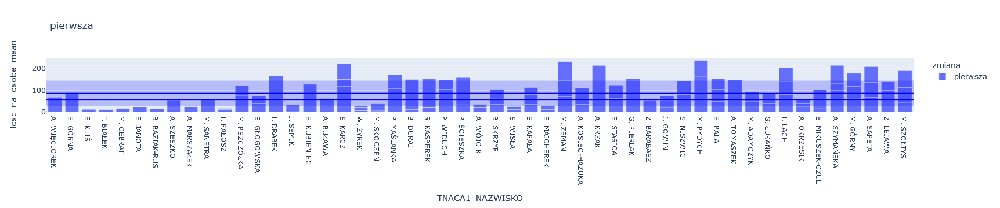

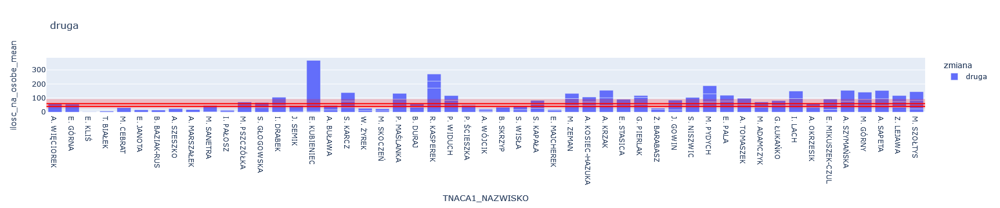

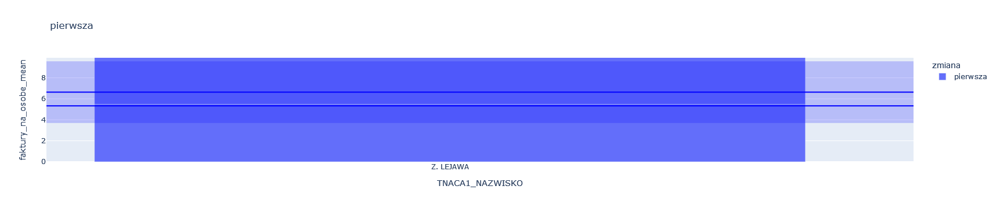

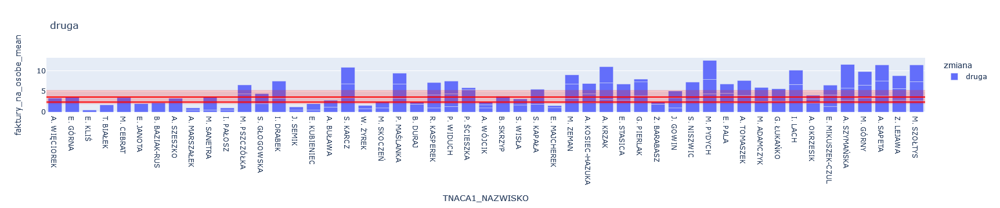

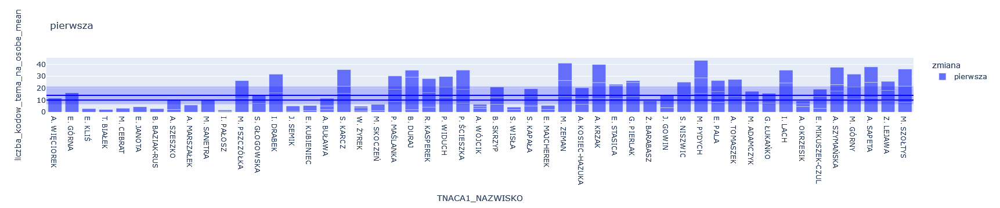

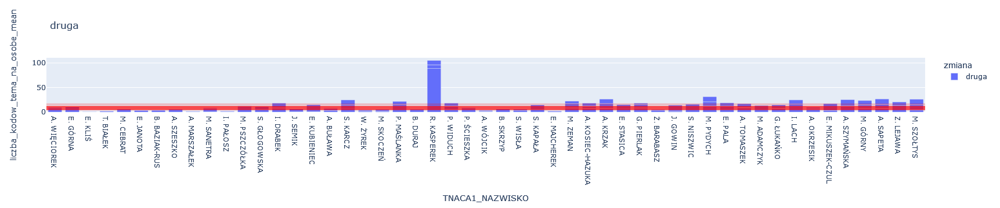

In [11]:
for zmiana, kolor in zip(['pierwsza','druga'], ['blue','red']):
    fig=px.bar(df_srednie_fte_osoby.loc[df_srednie_fte_osoby['zmiana']==zmiana].sort_values(by='max_dzien_pracy_tnaca1'),
           x='TNACA1_NAZWISKO',
           y='ilosc_na_osobe_mean',
           color='zmiana',
          barmode='group',
              title=zmiana)

    fig.add_hline(y=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['ilosc_na_osobe_mean_total'].values[0],
                 line_color=kolor)
    fig.add_hline(y=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['ilosc_na_osobe_q1_total'].values[0],
                 line_color=kolor)
    fig.add_hrect(y0=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['ilosc_na_osobe_mean_total'].values[0]-df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['ilosc_na_osobe_std_total'].values[0],
                  y1=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['ilosc_na_osobe_mean_total'].values[0]+df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['ilosc_na_osobe_std_total'].values[0], 
                  line_width=0, fillcolor=kolor, opacity=0.2)
    fig.show()

for zmiana, kolor in zip(['pierwsza','druga'], ['blue','red']):
    fig=px.bar(df_srednie_fte_osoby.loc[df_srednie_fte_osoby['zmiana']==zmiana].sort_values(by='max_dzien_pracy_tnaca1'),
           x='TNACA1_NAZWISKO',
           y='faktury_na_osobe_mean',
           color='zmiana',
          barmode='group',
              title=zmiana)

    fig.add_hline(y=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['faktury_na_osobe_mean_total'].values[0],
                 line_color=kolor)
    fig.add_hline(y=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['faktury_na_osobe_q1_total'].values[0],
                 line_color=kolor)
    fig.add_hrect(y0=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['faktury_na_osobe_mean_total'].values[0]-df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['faktury_na_osobe_std_total'].values[0],
                  y1=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['faktury_na_osobe_mean_total'].values[0]+df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['faktury_na_osobe_std_total'].values[0], 
                  line_width=0, fillcolor=kolor, opacity=0.2)
    fig.show()
    
for zmiana, kolor in zip(['pierwsza','druga'], ['blue','red']):
    fig=px.bar(df_srednie_fte_osoby.loc[df_srednie_fte_osoby['zmiana']==zmiana].sort_values(by='max_dzien_pracy_tnaca1'),
           x='TNACA1_NAZWISKO',
           y='liczba_kodow_tema_na_osobe_mean',
           color='zmiana',
          barmode='group',
              title=zmiana)

    fig.add_hline(y=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['liczba_kodow_tema_na_osobe_mean_total'].values[0],
                 line_color=kolor)
    fig.add_hline(y=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['liczba_kodow_tema_na_osobe_q1_total'].values[0],
                 line_color=kolor)
    fig.add_hrect(y0=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['liczba_kodow_tema_na_osobe_mean_total'].values[0]-df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['liczba_kodow_tema_na_osobe_std_total'].values[0],
                  y1=df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['liczba_kodow_tema_na_osobe_mean_total'].values[0]+df_srednie_fte.loc[df_srednie_fte['zmiana']==zmiana]['liczba_kodow_tema_na_osobe_std_total'].values[0], 
                  line_width=0, fillcolor=kolor, opacity=0.2)
    fig.show()

In [165]:
df_srednie_fte

NameError: name 'df_srednie_fte' is not defined

In [83]:
df_srednie_fte_osoby_with_total=df_srednie_fte_osoby.merge(df_srednie_fte, how='inner', on=['zmiana','year_month'])#.to_excel(r'C:\Users\kgrzebien\Desktop\python_tasks\kupony\fast_kpi\\'+\
                                                                              # 'kupony_fte_od_2020_test_ewa.xlsx')

In [84]:
df_srednie_fte_osoby_with_total

,year_month,zmiana,TNACA1,TNACA1_NAZWISKO,ilosc_na_osobe_mean,faktury_na_osobe_mean,liczba_kodow_tema_na_osobe_mean,max_dzien_pracy_tnaca1,liczba_unikatowych_dni_pracy_tnaca1,ilosc_na_osobe_mean_total,ilosc_na_osobe_std_total,ilosc_na_osobe_q1_total,faktury_na_osobe_mean_total,faktury_na_osobe_std_total,liczba_kodow_tema_na_osobe_mean_total,liczba_kodow_tema_na_osobe_std_total,faktury_na_osobe_q1_total,liczba_kodow_tema_na_osobe_q1_total
0,2020-01-01 00:00:00,pierwsza,565,P. MAŚLANKA,48.468421,3.552632,7.315789,2022-03-22 00:00:00,428,89.514401,47.667426,67.665536,6.109338,2.896633,14.113563,7.891921,5.147059,10.444328
1,2020-01-01 00:00:00,pierwsza,584,R. KASPEREK,67.992368,4.5,19.0,2022-04-30 00:00:00,359,89.514401,47.667426,67.665536,6.109338,2.896633,14.113563,7.891921,5.147059,10.444328
2,2020-01-01 00:00:00,pierwsza,537,M. SZOŁTYS,51.020625,4.5625,8.1875,2022-06-09 00:00:00,291,89.514401,47.667426,67.665536,6.109338,2.896633,14.113563,7.891921,5.147059,10.444328
3,2020-01-01 00:00:00,pierwsza,322,A. OKRZESIK,15.0,0.5,1.0,2022-06-28 00:00:00,414,89.514401,47.667426,67.665536,6.109338,2.896633,14.113563,7.891921,5.147059,10.444328
4,2020-01-01 00:00:00,pierwsza,406,E. GÓRNA,80.43,6.15,16.45,2020-11-27 00:00:00,196,89.514401,47.667426,67.665536,6.109338,2.896633,14.113563,7.891921,5.147059,10.444328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1543,2022-06-01 00:00:00,druga,228,G. ŁUKAŃKO,26.489286,2.642857,4.785714,2022-06-28 00:00:00,125,40.325562,23.550353,23.556771,2.809403,1.448246,6.573681,4.564919,1.729167,3.708333
1544,2022-06-01 00:00:00,druga,248,M. ADAMCZYK,29.657692,1.538462,3.846154,2022-06-29 00:00:00,229,40.325562,23.550353,23.556771,2.809403,1.448246,6.573681,4.564919,1.729167,3.708333
1545,2022-06-01 00:00:00,druga,345,K. RYPIEŃ,1.05,0.5,0.5,2022-06-14 00:00:00,5,40.325562,23.550353,23.556771,2.809403,1.448246,6.573681,4.564919,1.729167,3.708333
1546,2022-06-01 00:00:00,druga,276,S. WISŁA,30.2,2.0,2.0,2022-06-24 00:00:00,28,40.325562,23.550353,23.556771,2.809403,1.448246,6.573681,4.564919,1.729167,3.708333


In [85]:
def func_wynik_odchylen(df):
    for i in tqdm(df.index):
        for col in ['ilosc_na_osobe_mean','faktury_na_osobe_mean','liczba_kodow_tema_na_osobe_mean']:
            testing_value=df.loc[i, col]
            if np.isnan(testing_value):
                continue
            if testing_value < df.loc[i, col+'_total']-df.loc[i, col[:-4]+'std_total']:
                df.loc[i, col[:-13]+'wynik_odchylen']='4_poniżej_std'
                df.loc[i, col[:-13]+'wynik_odchylen_num']=4
            elif testing_value < df.loc[i, col[:-4]+'q1_total']:
                df.loc[i, col[:-13]+'wynik_odchylen']='3_poniżej_q1'
                df.loc[i, col[:-13]+'wynik_odchylen_num']=3
            elif testing_value < df.loc[i, col[:-4]+'mean_total']:
                df.loc[i, col[:-13]+'wynik_odchylen']='2_poniżej_mean'
                df.loc[i, col[:-13]+'wynik_odchylen_num']=2
            else:
                df.loc[i, col[:-13]+'wynik_odchylen']='1_powyżej_mean'
                df.loc[i, col[:-13]+'wynik_odchylen_num']=1
    return df

df_srednie_fte_osoby_with_total=func_wynik_odchylen(df_srednie_fte_osoby_with_total)

100%|████████████████████████████████████████████████████████████████████████████| 1548/1548 [00:00<00:00, 3137.92it/s]


In [60]:
### roznica do roku wczesniej
def func_pivot_to_year(df):
    # for i in tqdm(df.index):
    #     for col in ['ilosc_na_osobe_mean','faktury_na_osobe_mean','liczba_kodow_tema_na_osobe_mean']:
    #         testing_value=df.loc[i, col]
    #         if np.isnan(testing_value):
    #             continue
    arr_col_name_for_years=['ilosc_na_osobe_mean', 'faktury_na_osobe_mean', 'liczba_kodow_tema_na_osobe_mean']
    arr_col_name_for_merge=['zmiana', 'TNACA1', 'TNACA1_NAZWISKO']
    arr_col_to_drop=['year','ilosc_wynik_odchylen','ilosc_wynik_odchylen_num','faktury_wynik_odchylen',
                     'faktury_wynik_odchylen_num','liczba_kodow_tema_wynik_odchylen','liczba_kodow_tema_wynik_odchylen_num']+\
                    [i for i in df.columns if 'total' in i]
    arr_years=np.sort(df['year'].unique())
    DF=pd.DataFrame()
    for y in arr_years:
        if y == arr_years[0]:
            df_tmp=df.loc[df['year']==y]
            df_tmp=df_tmp.drop(arr_col_to_drop, axis=1)
        else:
            df_tmp=df.loc[df['year']==y][arr_col_name_for_merge+arr_col_name_for_years]
            
        for col in arr_col_name_for_years:
            df_tmp=df_tmp.rename(columns={col:col+'_'+str(y)})
        
        if len(DF)==0:
            DF=df_tmp
        else:
            DF=DF.merge(df_tmp, how='outer', on=arr_col_name_for_merge)
    
    arr_col_to_return=arr_col_name_for_merge+[i for i in DF.columns if '20' in i]
    arr_col_to_return=arr_col_to_return+list(set(DF.columns)-set(arr_col_to_return))
    return DF[arr_col_to_return]
        

def func_roznica_LY(df, year_TY, year_LY):
    arr_col_name_for_years=['ilosc_na_osobe_mean', 'faktury_na_osobe_mean', 'liczba_kodow_tema_na_osobe_mean']
    for col in arr_col_name_for_years:
        df[col+'_diff_'+year_LY+'_'+year_TY]=df[col+'_'+year_TY]-df[col+'_'+year_LY]
        df[col+'_diff_proc_'+year_LY+'_'+year_TY]=(df[col+'_'+year_TY]-df[col+'_'+year_LY])/df[col+'_'+year_LY]*100
        
    return df
        

In [61]:
df_srednie_fte_osoby_with_total_pivot=func_pivot_to_year(df_srednie_fte_osoby_with_total)

In [62]:
df_srednie_fte_osoby_with_total_pivot=func_roznica_LY(df_srednie_fte_osoby_with_total_pivot, '2022', '2021')

In [63]:
df_srednie_fte_osoby_with_total_pivot.columns

Index(['zmiana', 'TNACA1', 'TNACA1_NAZWISKO', 'ilosc_na_osobe_mean_2020',
       'faktury_na_osobe_mean_2020', 'liczba_kodow_tema_na_osobe_mean_2020',
       'ilosc_na_osobe_mean_2021', 'faktury_na_osobe_mean_2021',
       'liczba_kodow_tema_na_osobe_mean_2021', 'ilosc_na_osobe_mean_2022',
       'faktury_na_osobe_mean_2022', 'liczba_kodow_tema_na_osobe_mean_2022',
       'max_dzien_pracy_tnaca1', 'liczba_unikatowych_dni_pracy_tnaca1',
       'ilosc_na_osobe_mean_diff_2021_2022',
       'ilosc_na_osobe_mean_diff_proc_2021_2022',
       'faktury_na_osobe_mean_diff_2021_2022',
       'faktury_na_osobe_mean_diff_proc_2021_2022',
       'liczba_kodow_tema_na_osobe_mean_diff_2021_2022',
       'liczba_kodow_tema_na_osobe_mean_diff_proc_2021_2022'],
      dtype='object')

In [64]:
df_srednie_fte_osoby_with_total.to_excel(r'C:\Users\kgrzebien\Desktop\python_tasks\kupony\fast_kpi\\'+\
                                                                               'kupony_fte_lata_test_ewa.xlsx')
df_srednie_fte_osoby_with_total_pivot.to_excel(r'C:\Users\kgrzebien\Desktop\python_tasks\kupony\fast_kpi\\'+\
                                                                               'kupony_fte_pivot_lata_test_ewa.xlsx')

## tabelka dla Agaty z liczbami po miesiacach - pivot

### month

#### calculate

In [88]:
def func_tnaca_nazwisko(df):
    df1=df[['TNACA1','TNACA1_NAZWISKO']]
    df2=df[['TNACA2','TNACA2_NAZWISKO']]
    df1=df1.rename(columns={'TNACA1':'tnaca','TNACA1_NAZWISKO':'TNACA_NAZWISKO'})
    df2=df2.rename(columns={'TNACA2':'tnaca','TNACA2_NAZWISKO':'TNACA_NAZWISKO'})
    df=df1.append(df2, ignore_index=True)
    return df.drop_duplicates()
    
def func_rcp_proc_time(year1, year2, month, df_with_name, mc_or_total):
    if mc_or_total=='mc':
        tmp=func_minutes_rcp_group(df_with_minutes_rcp.loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
                                                          ['year_month','zadania_ogolnie_4_grupy','KOD_OPER'],
                                                          'wzgledny')
    else:
        tmp=func_minutes_rcp_group(df_with_minutes_rcp.loc[df_with_minutes_rcp['month'].isin(month)].loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
                                                          ['year','zadania_ogolnie_4_grupy','KOD_OPER'],
                                                          'wzgledny')
    tmp=tmp.loc[tmp['zadania_ogolnie_4_grupy']=='1-kupony']
    
    
    
    if mc_or_total=='mc':
        tmp=tmp[['year_month','KOD_OPER','procent_wykorzystania']]
        tmp['year']=tmp['year_month'].apply(lambda x: x.year)
        tmp['month']=tmp['year_month'].apply(lambda x: x.month)
        tmp1=tmp.loc[tmp['year']==year1].loc[tmp['month'].isin(month)]
        tmp2=tmp.loc[tmp['year']==year2].loc[tmp['month'].isin(month)]
        tmp1=tmp1.drop(['year_month','year'], axis=1)
        tmp2=tmp2.drop(['year_month','year'], axis=1)
    else:
        tmp=tmp[['year','KOD_OPER','procent_wykorzystania']]
        tmp1=tmp.loc[tmp['year']==year1]
        tmp2=tmp.loc[tmp['year']==year2]
        tmp1=tmp1.drop(['year'], axis=1)
        tmp2=tmp2.drop(['year'], axis=1)
        
    tmp1=tmp1.rename(columns={'procent_wykorzystania':'procent_wykorzystania_czasu_pracy_na_kupony_'+str(year1)})
    tmp2=tmp2.rename(columns={'procent_wykorzystania':'procent_wykorzystania_czasu_pracy_na_kupony_'+str(year2)})
    if mc_or_total=='mc':
        tmp=tmp1.merge(tmp2, how='outer', on=['KOD_OPER','month'])
    else:
        tmp=tmp1.merge(tmp2, how='outer', on=['KOD_OPER'])
        
    tmp=tmp.merge(df_with_name, how='left', left_on='KOD_OPER', right_on='tnaca')
    return tmp


def func_rcp_time_real_zamowienia(year1, year2, month, df_with_name, mc_or_total):
    if mc_or_total=='mc':
        tmp=func_minutes_rcp_group(df_with_minutes_rcp.loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
                                                          ['year_month','zadania_ogolnie_5_grupy','KOD_OPER'],
                                                          'wzgledny')
    else:
        tmp=func_minutes_rcp_group(df_with_minutes_rcp.loc[df_with_minutes_rcp['month'].isin(month)].loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
                                                          ['year','zadania_ogolnie_5_grupy','KOD_OPER'],
                                                          'wzgledny')
    tmp=tmp.loc[tmp['zadania_ogolnie_5_grupy']=='1 - KUPONY-REALIZACJA ZAMÓWIENIA']
    
    
    
    if mc_or_total=='mc':
        tmp=tmp[['year_month','KOD_OPER','ile_minut_czynnosc']]
        tmp['year']=tmp['year_month'].apply(lambda x: x.year)
        tmp['month']=tmp['year_month'].apply(lambda x: x.month)
        tmp1=tmp.loc[tmp['year']==year1].loc[tmp['month'].isin(month)]
        tmp2=tmp.loc[tmp['year']==year2].loc[tmp['month'].isin(month)]
        tmp1=tmp1.drop(['year_month','year'], axis=1)
        tmp2=tmp2.drop(['year_month','year'], axis=1)
    else:
        tmp=tmp[['year','KOD_OPER','ile_minut_czynnosc']]
        tmp1=tmp.loc[tmp['year']==year1]
        tmp2=tmp.loc[tmp['year']==year2]
        tmp1=tmp1.drop(['year'], axis=1)
        tmp2=tmp2.drop(['year'], axis=1)
        
    tmp1=tmp1.rename(columns={'ile_minut_czynnosc':'ile_minut_czynnosc_na_realizacje_kupony_'+str(year1)})
    tmp2=tmp2.rename(columns={'ile_minut_czynnosc':'ile_minut_czynnosc_na_realizacje_kupony_'+str(year2)})
    if mc_or_total=='mc':
        tmp=tmp1.merge(tmp2, how='outer', on=['KOD_OPER','month'])
    else:
        tmp=tmp1.merge(tmp2, how='outer', on=['KOD_OPER'])
        
    tmp=tmp.merge(df_with_name, how='left', left_on='KOD_OPER', right_on='tnaca')
    return tmp


def func_rcp_time_cale_kupony(year1, year2, month, df_with_name, mc_or_total):
    if mc_or_total=='mc':
        tmp=func_minutes_rcp_group(df_with_minutes_rcp.loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
                                                          ['year_month','zadania_ogolnie_4_grupy','KOD_OPER'],
                                                          'wzgledny')
    else:
        tmp=func_minutes_rcp_group(df_with_minutes_rcp.loc[df_with_minutes_rcp['month'].isin(month)].loc[~df_with_minutes_rcp['KOD_OPER'].isin(df_operatorzy_do_usuniecia_z_rcp['KOD_OPER'].unique())],
                                                          ['year','zadania_ogolnie_4_grupy','KOD_OPER'],
                                                          'wzgledny')
    tmp=tmp.loc[tmp['zadania_ogolnie_4_grupy']=='1-kupony']
    
    
    
    if mc_or_total=='mc':
        tmp=tmp[['year_month','KOD_OPER','ile_minut_czynnosc']]
        tmp['year']=tmp['year_month'].apply(lambda x: x.year)
        tmp['month']=tmp['year_month'].apply(lambda x: x.month)
        tmp1=tmp.loc[tmp['year']==year1].loc[tmp['month'].isin(month)]
        tmp2=tmp.loc[tmp['year']==year2].loc[tmp['month'].isin(month)]
        tmp1=tmp1.drop(['year_month','year'], axis=1)
        tmp2=tmp2.drop(['year_month','year'], axis=1)
    else:
        tmp=tmp[['year','KOD_OPER','ile_minut_czynnosc']]
        tmp1=tmp.loc[tmp['year']==year1]
        tmp2=tmp.loc[tmp['year']==year2]
        tmp1=tmp1.drop(['year'], axis=1)
        tmp2=tmp2.drop(['year'], axis=1)
        
    tmp1=tmp1.rename(columns={'ile_minut_czynnosc':'ile_minut_czynnosc_na_cale_kupony_'+str(year1)})
    tmp2=tmp2.rename(columns={'ile_minut_czynnosc':'ile_minut_czynnosc_na_cale_kupony_'+str(year2)})
    if mc_or_total=='mc':
        tmp=tmp1.merge(tmp2, how='outer', on=['KOD_OPER','month'])
    else:
        tmp=tmp1.merge(tmp2, how='outer', on=['KOD_OPER'])
        
    tmp=tmp.merge(df_with_name, how='left', left_on='KOD_OPER', right_on='tnaca')
    return tmp

In [89]:
func_rcp_time_cale_kupony(2021, 2022, [1,2,3,4,5,6],
                   func_tnaca_nazwisko(df), 
                   'total').\
merge(
        func_rcp_time_real_zamowienia(2021, 2022, [1,2,3,4,5,6],
                   func_tnaca_nazwisko(df), 
                   'total'),
    how='outer',
    on=['TNACA_NAZWISKO','tnaca','KOD_OPER'])

,KOD_OPER,ile_minut_czynnosc_na_cale_kupony_2021,ile_minut_czynnosc_na_cale_kupony_2022,tnaca,TNACA_NAZWISKO,ile_minut_czynnosc_na_realizacje_kupony_2021,ile_minut_czynnosc_na_realizacje_kupony_2022
0,35,18639.0,NaN,35,A. MARSZAŁEK,15780.0,NaN
1,84,37704.0,49592.0,84,A. TOMASZEK,34213.0,43647.0
2,119,55200.0,42276.0,119,E. KUBIENIEC,NaN,NaN
3,139,25125.0,51806.0,139,E. MAJCHEREK,22139.0,46759.0
4,152,60679.0,52350.0,152,B. DURAJ,NaN,NaN
5,227,21426.0,38055.0,227,M. SKOCZEŃ,16440.0,29953.0
6,229,22595.0,51036.0,229,Ż. BARABASZ,18229.0,35944.0
7,248,11883.0,49869.0,248,M. ADAMCZYK,8520.0,24671.0
8,268,4379.0,15597.0,268,W. ŻYREK,4138.0,13574.0
9,322,50783.0,48856.0,322,A. OKRZESIK,45973.0,44716.0


In [96]:
def func_create_pivot_table_agata(df, year1, year2, month, tnaca_czy_stol):
    
    df_rcp_proc_time=func_rcp_proc_time(year1, year2, month, func_tnaca_nazwisko(df), 'mc')
    df_rcp_proc_time_total=func_rcp_proc_time(year1, year2, month, func_tnaca_nazwisko(df), 'total')
    df_rcp_time_cale_kupony_godziny=func_rcp_time_cale_kupony(year1, year2, month, func_tnaca_nazwisko(df), 'mc')
    df_rcp_time_cale_kupony_godziny_total=func_rcp_time_cale_kupony(year1, year2, month, func_tnaca_nazwisko(df), 'total')
    df_rcp_time_real_zamowienia_godziny=func_rcp_time_real_zamowienia(year1, year2, month, func_tnaca_nazwisko(df), 'mc')
    df_rcp_time_real_zamowienia_godziny_total=func_rcp_time_real_zamowienia(year1, year2, month, func_tnaca_nazwisko(df), 'total')
    
    df_table_pivot=pd.DataFrame(columns=['TNACA_NAZWISKO','month',
                                         'FAKTURA_'+str(year1),'FAKTURA_'+str(year2), 'FAKTURA_DYNAMIKA',
                                         'ILOSC_'+str(year1),'ILOSC_'+str(year2), 'ILOSC_DYNAMIKA',
                                         'ROZMIARSI_'+str(year1), 'ROZMIARSI_'+str(year2), 'ROZMIARSI_DYNAMIKA',
                                         'WARTOSC_B_'+str(year1),'WARTOSC_B_'+str(year2), 'WARTOSC_B_DYNAMIKA',
                                         'KOD_TEMA_'+str(year1), 'KOD_TEMA_'+str(year2), 'KOD_TEMA_DYNAMIKA',
                                        'PROCENT_CZASU_PRACY_NA_KUPONACH_'+str(year1), 'PROCENT_CZASU_PRACY_NA_KUPONACH_'+str(year2), 'PROCENT_CZASU_PRACY_NA_KUPONACH_DYNAMIKA',
                                         'LICZBA_GODZIN_NA_CALYCH_KUPONACH_'+str(year1), 'LICZBA_GODZIN_NA_CALYCH_KUPONACH_'+str(year2), 'LICZBA_GODZIN_NA_CALYCH_KUPONACH_DYNAMIKA',
                                         'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_'+str(year1), 'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_'+str(year2), 'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_DYNAMIKA',
                                        'LICZBA_UNIKATOWYCH_DNI_'+str(year1),'LICZBA_UNIKATOWYCH_DNI_'+str(year2), 'LICZBA_UNIKATOWYCH_DNI_DYNAMIKA'])#,
                                        #'LICZBA_UNIKATOWYCH_MINUT_'+str(year1),'LICZBA_UNIKATOWYCH_MINUT_'+str(year2), 'LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA',
                                        #'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_'+str(year1),'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_'+str(year2), 'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA'])
    
    if tnaca_czy_stol=='tnaca':
        arr_tnaca_unique=np.append(df['TNACA1_NAZWISKO'].unique(),df['TNACA2_NAZWISKO'].unique())
        arr_tnaca_unique=np.unique(arr_tnaca_unique)
    elif tnaca_czy_stol=='stol':
        arr_tnaca_unique=df.loc[df['year']==year2]['STOL_NAZWISKO'].unique()
        
    else:
        print('BŁĄD parametru: "tnaca_czy_stol"')
        return
    
    for tnaca in tqdm(arr_tnaca_unique):
        # tnaca='S. KAPAŁA'
        for mc in month:
            arr_f=func_get_values_from_global_df(df, tnaca, year1, year2, mc, 'FAKTURA', tnaca_czy_stol)
            arr_i=func_get_values_from_global_df(df, tnaca, year1, year2, mc, 'ILOSC', tnaca_czy_stol)
            arr_w=func_get_values_from_global_df(df, tnaca, year1, year2, mc, 'WARTOSC_B', tnaca_czy_stol)
            arr_k=func_get_values_from_global_df(df, tnaca, year1, year2, mc, 'KOD_TEMA', tnaca_czy_stol)
            arr_r=func_get_values_from_global_df(df, tnaca, year1, year2, mc, 'ROZMIARSI', tnaca_czy_stol)
            arr_day=func_time_unique_day(df, tnaca, year1, year2, mc, tnaca_czy_stol)
            #arr_minutes=func_time_unique_minutes(df, tnaca, year1, year2, mc, tnaca_czy_stol)
            # try:
            #     val_1_srednia_liczba_unikatowych_minut=round(arr_minutes[0]/arr_day[0])
            # except:
            #     val_1_srednia_liczba_unikatowych_minut=0
            # try:
            #     val_2_srednia_liczba_unikatowych_minut=round(arr_minutes[1]/arr_day[1])
            # except:
            #     val_2_srednia_liczba_unikatowych_minut=0
            # try:
            #     val_srednia_liczba_unikatowych_minut_dyn=round((val_2_srednia_liczba_unikatowych_minut-val_1_srednia_liczba_unikatowych_minut)/val_1_srednia_liczba_unikatowych_minut, 2)
            # except:
            #     val_srednia_liczba_unikatowych_minut_dyn=0
            ##
            #procent czasu pracy na kuponach do innych czynnosci
            ##
            try:
                val_1_proc_czasu_pracu=round(df_rcp_proc_time.loc[df_rcp_proc_time['month']==mc].loc[df_rcp_proc_time['TNACA_NAZWISKO']==tnaca]['procent_wykorzystania_czasu_pracy_na_kupony_'+str(year1)].values[0])
            except:
                val_1_proc_czasu_pracu=0
            try:
                val_2_proc_czasu_pracu=round(df_rcp_proc_time.loc[df_rcp_proc_time['month']==mc].loc[df_rcp_proc_time['TNACA_NAZWISKO']==tnaca]['procent_wykorzystania_czasu_pracy_na_kupony_'+str(year2)].values[0])
            except:
                val_2_proc_czasu_pracu=0
            try:
                val_proc_czasu_pracu_dyn=round((val_2_proc_czasu_pracu-val_1_proc_czasu_pracu)/val_1_proc_czasu_pracu, 2)
            except:
                val_proc_czasu_pracu_dyn=0
            ##
            #godziny pracy na calych kuponach 
            ##
            try:
                val_1_godziny_cale_kupony=round(df_rcp_time_cale_kupony_godziny.loc[df_rcp_time_cale_kupony_godziny['month']==mc].loc[df_rcp_time_cale_kupony_godziny['TNACA_NAZWISKO']==tnaca]['ile_minut_czynnosc_na_cale_kupony_'+str(year1)].values[0])
                val_1_godziny_cale_kupony=round(val_1_godziny_cale_kupony/60 , 2)
            except:
                val_1_godziny_cale_kupony=0
            try:
                val_2_godziny_cale_kupony=round(df_rcp_time_cale_kupony_godziny.loc[df_rcp_time_cale_kupony_godziny['month']==mc].loc[df_rcp_time_cale_kupony_godziny['TNACA_NAZWISKO']==tnaca]['ile_minut_czynnosc_na_cale_kupony_'+str(year2)].values[0])
                val_2_godziny_cale_kupony=round(val_2_godziny_cale_kupony/60 , 2)
            except:
                val_2_godziny_cale_kupony=0
            try:
                val_godziny_cale_kupony_dyn=round((val_2_godziny_cale_kupony-val_1_godziny_cale_kupony)/val_1_godziny_cale_kupony, 2)
            except:
                val_godziny_cale_kupony_dyn=0
            ##
            #godziny pracy na realizacji zamowien 
            ##
            try:
                val_1_godziny_real_zamowien=round(df_rcp_time_real_zamowienia_godziny.loc[df_rcp_time_real_zamowienia_godziny['month']==mc].loc[df_rcp_time_real_zamowienia_godziny['TNACA_NAZWISKO']==tnaca]['ile_minut_czynnosc_na_realizacje_kupony_'+str(year1)].values[0])
                val_1_godziny_real_zamowien=round(val_1_godziny_real_zamowien/60 , 2)
            except:
                val_1_godziny_real_zamowien=0
            try:
                val_2_godziny_real_zamowien=round(df_rcp_time_real_zamowienia_godziny.loc[df_rcp_time_real_zamowienia_godziny['month']==mc].loc[df_rcp_time_real_zamowienia_godziny['TNACA_NAZWISKO']==tnaca]['ile_minut_czynnosc_na_realizacje_kupony_'+str(year2)].values[0])
                val_2_godziny_real_zamowien=round(val_2_godziny_real_zamowien/60 , 2)
            except:
                val_2_godziny_real_zamowien=0
            try:
                val_godziny_real_zamowien_dyn=round((val_2_godziny_real_zamowien-val_1_godziny_real_zamowien)/val_1_godziny_real_zamowien, 2)
            except:
                val_godziny_real_zamowien_dyn=0
                
            df_table_pivot=df_table_pivot.append({'TNACA_NAZWISKO':tnaca,
                                                   'month':mc,
                                                    'FAKTURA_'+str(year1):arr_f[0],
                                                    'FAKTURA_'+str(year2):arr_f[1], 
                                                    'FAKTURA_DYNAMIKA':arr_f[2],
                                                    'ILOSC_'+str(year1):arr_i[0],
                                                    'ILOSC_'+str(year2):arr_i[1], 
                                                    'ILOSC_DYNAMIKA':arr_i[2],
                                                    'ROZMIARSI_'+str(year1):arr_r[0],
                                                    'ROZMIARSI_'+str(year2):arr_r[1], 
                                                    'ROZMIARSI_DYNAMIKA':arr_r[2],
                                                    'WARTOSC_B_'+str(year1):arr_w[0],
                                                    'WARTOSC_B_'+str(year2):arr_w[1], 
                                                    'WARTOSC_B_DYNAMIKA':arr_w[2],
                                                    'KOD_TEMA_'+str(year1):arr_k[0],
                                                    'KOD_TEMA_'+str(year2):arr_k[1], 
                                                    'KOD_TEMA_DYNAMIKA':arr_k[2],
                                                     'PROCENT_CZASU_PRACY_NA_KUPONACH_'+str(year1):val_1_proc_czasu_pracu,
                                                      'PROCENT_CZASU_PRACY_NA_KUPONACH_'+str(year2):val_2_proc_czasu_pracu,
                                                  'PROCENT_CZASU_PRACY_NA_KUPONACH_DYNAMIKA':val_proc_czasu_pracu_dyn,
                                                     'LICZBA_GODZIN_NA_CALYCH_KUPONACH_'+str(year1):val_1_godziny_cale_kupony,
                                                      'LICZBA_GODZIN_NA_CALYCH_KUPONACH_'+str(year2):val_2_godziny_cale_kupony,
                                                  'LICZBA_GODZIN_NA_CALYCH_KUPONACH_DYNAMIKA':val_godziny_cale_kupony_dyn,
                                                     'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_'+str(year1):val_1_godziny_real_zamowien,
                                                      'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_'+str(year2):val_2_godziny_real_zamowien,
                                                  'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_DYNAMIKA':val_godziny_real_zamowien_dyn,  
                                                  'LICZBA_UNIKATOWYCH_DNI_'+str(year1):arr_day[0],
                                                    'LICZBA_UNIKATOWYCH_DNI_'+str(year2):arr_day[1], 
                                                    'LICZBA_UNIKATOWYCH_DNI_DYNAMIKA':arr_day[2]},
                                                 #    'LICZBA_UNIKATOWYCH_MINUT_'+str(year1):arr_minutes[0],
                                                 #    'LICZBA_UNIKATOWYCH_MINUT_'+str(year2):arr_minutes[1], 
                                                 #    'LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA':arr_minutes[2],
                                                 # 'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_'+str(year1):val_1_srednia_liczba_unikatowych_minut,
                                                 #  'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_'+str(year2):val_2_srednia_liczba_unikatowych_minut,
                                                 #  'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA':val_srednia_liczba_unikatowych_minut_dyn},
                                                  ignore_index=True)
            
        df_table_pivot=df_table_pivot.fillna(0)
        df_table_pivot.replace([np.inf, -np.inf], 0, inplace=True)
        
        arr_f_0=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['FAKTURA_'+str(year1)].sum()
        arr_f_1=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['FAKTURA_'+str(year2)].sum()
        try:
            arr_f_2=(arr_f_1-arr_f_0)/arr_f_0#*100
            arr_f_2=round(arr_f_2, 2)
        except:
            arr_f_2=0
        arr_i_0=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['ILOSC_'+str(year1)].sum()
        arr_i_1=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['ILOSC_'+str(year2)].sum()
        try:
            arr_i_2=(arr_i_1-arr_i_0)/arr_i_0#*100
            arr_i_2=round(arr_i_2, 2)
        except:
            arr_i_2=0
        arr_w_0=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['WARTOSC_B_'+str(year1)].sum()
        arr_w_1=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['WARTOSC_B_'+str(year2)].sum()
        try:
            arr_w_2=(arr_w_1-arr_w_0)/arr_w_0#*100
            arr_w_2=round(arr_w_2, 2)
        except:
            arr_w_2=0
        arr_k_0=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['KOD_TEMA_'+str(year1)].sum()
        arr_k_1=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['KOD_TEMA_'+str(year2)].sum()
        try:
            arr_k_2=(arr_k_1-arr_k_0)/arr_k_0#*100
            arr_k_2=round(arr_k_2, 2)
        except:
            arr_k_2=0
        arr_r_0=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['ROZMIARSI_'+str(year1)].sum()
        arr_r_1=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['ROZMIARSI_'+str(year2)].sum()
        try:
            arr_r_2=(arr_r_1-arr_r_0)/arr_r_0#*100
            arr_r_2=round(arr_r_2, 2)
        except:
            arr_r_2=0
        arr_day_0=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['LICZBA_UNIKATOWYCH_DNI_'+str(year1)].sum()
        arr_day_1=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['LICZBA_UNIKATOWYCH_DNI_'+str(year2)].sum()
        try:
            arr_day_2=(arr_day_1-arr_day_0)/arr_day_0#*100
            arr_day_2=round(arr_day_2, 2)
        except:
            arr_day_2=0
        # arr_minutes_0=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['LICZBA_UNIKATOWYCH_MINUT_'+str(year1)].sum()
        # arr_minutes_1=df_table_pivot.loc[df_table_pivot['TNACA_NAZWISKO']==tnaca]['LICZBA_UNIKATOWYCH_MINUT_'+str(year2)].sum()
        # try:
        #     arr_minutes_2=(arr_minutes_1-arr_minutes_0)/arr_minutes_0#*100
        #     arr_minutes_2=round(arr_minutes_2, 2)
        # except:
        #     arr_minutes_2=0
        ###   
        # try:
        #     val_1_srednia_liczba_unikatowych_minut=round(arr_minutes_0/arr_day_0)
        # except:
        #     val_1_srednia_liczba_unikatowych_minut=0
        # try:
        #     val_2_srednia_liczba_unikatowych_minut=round(arr_minutes_1/arr_day_1)
        # except:
        #     val_2_srednia_liczba_unikatowych_minut=0
        # try:
        #     val_srednia_liczba_unikatowych_minut_dyn=round((val_2_srednia_liczba_unikatowych_minut-val_1_srednia_liczba_unikatowych_minut)/val_1_srednia_liczba_unikatowych_minut, 2)
        # except:
        #     val_srednia_liczba_unikatowych_minut_dyn=0
        ##
        #procent czasu pracy na kuponach do innych czynnosci
        ##
        try:
            val_1_proc_czasu_pracu=round(df_rcp_proc_time_total.loc[df_rcp_proc_time_total['TNACA_NAZWISKO']==tnaca]['procent_wykorzystania_czasu_pracy_na_kupony_'+str(year1)].values[0])
        except:
            val_1_proc_czasu_pracu=0
        try:
            val_2_proc_czasu_pracu=round(df_rcp_proc_time_total.loc[df_rcp_proc_time_total['TNACA_NAZWISKO']==tnaca]['procent_wykorzystania_czasu_pracy_na_kupony_'+str(year2)].values[0])
        except:
            val_2_proc_czasu_pracu=0
        try:
            val_proc_czasu_pracu_dyn=round((val_2_proc_czasu_pracu-val_1_proc_czasu_pracu)/val_1_proc_czasu_pracu, 2)
        except:
            val_proc_czasu_pracu_dyn=0
        ##
        #godziny pracy na calych kuponach 
        ##
        try:
            val_1_godziny_cale_kupony=round(df_rcp_time_cale_kupony_godziny_total.loc[df_rcp_time_cale_kupony_godziny_total['TNACA_NAZWISKO']==tnaca]['ile_minut_czynnosc_na_cale_kupony_'+str(year1)].values[0])
            val_1_godziny_cale_kupony=round(val_1_godziny_cale_kupony/60 , 2)
        except:
            val_1_godziny_cale_kupony=0
        try:
            val_2_godziny_cale_kupony=round(df_rcp_time_cale_kupony_godziny_total.loc[df_rcp_time_cale_kupony_godziny_total['TNACA_NAZWISKO']==tnaca]['ile_minut_czynnosc_na_cale_kupony_'+str(year2)].values[0])
            val_2_godziny_cale_kupony=round(val_2_godziny_cale_kupony/60 , 2)
        except:
            val_2_godziny_cale_kupony=0
        try:
            val_godziny_cale_kupony_dyn=round((val_2_godziny_cale_kupony-val_1_godziny_cale_kupony)/val_1_godziny_cale_kupony, 2)
        except:
            val_godziny_cale_kupony_dyn=0
        ##
        #godziny pracy na realizacji zamowien 
        ##
        try:
            val_1_godziny_real_zamowien=round(df_rcp_time_real_zamowienia_godziny_total.loc[df_rcp_time_real_zamowienia_godziny_total['TNACA_NAZWISKO']==tnaca]['ile_minut_czynnosc_na_realizacje_kupony_'+str(year1)].values[0])
            val_1_godziny_real_zamowien=round(val_1_godziny_real_zamowien/60 , 2)
        except:
            val_1_godziny_real_zamowien=0
        try:
            val_2_godziny_real_zamowien=round(df_rcp_time_real_zamowienia_godziny_total.loc[df_rcp_time_real_zamowienia_godziny_total['TNACA_NAZWISKO']==tnaca]['ile_minut_czynnosc_na_realizacje_kupony_'+str(year2)].values[0])
            val_2_godziny_real_zamowien=round(val_2_godziny_real_zamowien/60 , 2)
        except:
            val_2_godziny_real_zamowien=0
        try:
            val_godziny_real_zamowien_dyn=round((val_2_godziny_real_zamowien-val_1_godziny_real_zamowien)/val_1_godziny_real_zamowien, 2)
        except:
            val_godziny_real_zamowien_dyn=0
        df_table_pivot=df_table_pivot.append({'TNACA_NAZWISKO':tnaca,
                                               'month':'suma',
                                                'FAKTURA_'+str(year1):arr_f_0,
                                                'FAKTURA_'+str(year2):arr_f_1, 
                                                'FAKTURA_DYNAMIKA':arr_f_2,
                                                'ILOSC_'+str(year1):arr_i_0,
                                                'ILOSC_'+str(year2):arr_i_1, 
                                                'ILOSC_DYNAMIKA':arr_i_2,
                                                'ROZMIARSI_'+str(year1):arr_r_0,
                                                'ROZMIARSI_'+str(year2):arr_r_1, 
                                                'ROZMIARSI_DYNAMIKA':arr_r_2,
                                                'WARTOSC_B_'+str(year1):arr_w_0,
                                                'WARTOSC_B_'+str(year2):arr_w_1, 
                                                'WARTOSC_B_DYNAMIKA':arr_w_2,
                                                'KOD_TEMA_'+str(year1):arr_k_0,
                                                'KOD_TEMA_'+str(year2):arr_k_1, 
                                                'KOD_TEMA_DYNAMIKA':arr_k_2,
                                                 'PROCENT_CZASU_PRACY_NA_KUPONACH_'+str(year1):val_1_proc_czasu_pracu,
                                                  'PROCENT_CZASU_PRACY_NA_KUPONACH_'+str(year2):val_2_proc_czasu_pracu,
                                                  'PROCENT_CZASU_PRACY_NA_KUPONACH_DYNAMIKA':val_proc_czasu_pracu_dyn,
                                                     'LICZBA_GODZIN_NA_CALYCH_KUPONACH_'+str(year1):val_1_godziny_cale_kupony,
                                                      'LICZBA_GODZIN_NA_CALYCH_KUPONACH_'+str(year2):val_2_godziny_cale_kupony,
                                                  'LICZBA_GODZIN_NA_CALYCH_KUPONACH_DYNAMIKA':val_godziny_cale_kupony_dyn,
                                                     'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_'+str(year1):val_1_godziny_real_zamowien,
                                                      'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_'+str(year2):val_2_godziny_real_zamowien,
                                                  'LICZBA_GODZIN_NA_REAL_ZAMOWIEN_DYNAMIKA':val_godziny_real_zamowien_dyn, 
                                                'LICZBA_UNIKATOWYCH_DNI_'+str(year1):arr_day_0,
                                                'LICZBA_UNIKATOWYCH_DNI_'+str(year2):arr_day_1, 
                                                'LICZBA_UNIKATOWYCH_DNI_DYNAMIKA':arr_day_2},
                                             #    'LICZBA_UNIKATOWYCH_MINUT_'+str(year1):arr_minutes_0,
                                             #    'LICZBA_UNIKATOWYCH_MINUT_'+str(year2):arr_minutes_1, 
                                             #    'LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA':arr_minutes_2,
                                             # 'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_'+str(year1):val_1_srednia_liczba_unikatowych_minut,
                                             #  'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_'+str(year2):val_2_srednia_liczba_unikatowych_minut,
                                             #  'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA':val_srednia_liczba_unikatowych_minut_dyn},
                                              ignore_index=True)
        # break
        
        
    return df_table_pivot
    
    
    
    
    
def func_get_values_from_global_df(df, tnaca, year1, year2, mc, col_value, tnaca_czy_stol):
    if col_value=='FAKTURA':
        dict_with_agg={'FAKTURA':'nunique'}
    elif col_value=='ILOSC':
        dict_with_agg={'ILOSC':'sum'}
    elif col_value=='KOD_TEMA':
        dict_with_agg={'KOD_TEMA':'count'}
    elif col_value=='ROZMIARSI':
        dict_with_agg={'ROZMIARSI':'sum'}
    elif col_value=='WARTOSC_B':
        if tnaca_czy_stol=='tnaca':
            df=df.groupby(['Z_DNIA','year','month','TNACA1_NAZWISKO','TNACA2_NAZWISKO','FAKTURA']).agg({'WARTOSC_B':'first'}).reset_index()
            dict_with_agg={'WARTOSC_B':'sum'}
        else:
            df=df.groupby(['Z_DNIA','year','month','STOL_NAZWISKO','FAKTURA']).agg({'WARTOSC_B':'first'}).reset_index()
            dict_with_agg={'WARTOSC_B':'sum'}
    
    if tnaca_czy_stol=='tnaca':
        val_1=df.loc[df['year']==year1].loc[df['month']==mc].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)].agg(dict_with_agg).values[0]
        val_2=df.loc[df['year']==year2].loc[df['month']==mc].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)].agg(dict_with_agg).values[0]
    else:
        val_1=df.loc[df['year']==year1].loc[df['month']==mc].loc[(df['STOL_NAZWISKO']==tnaca)].agg(dict_with_agg).values[0]
        val_2=df.loc[df['year']==year2].loc[df['month']==mc].loc[(df['STOL_NAZWISKO']==tnaca)].agg(dict_with_agg).values[0]
    try:
        val_dyn=(val_2-val_1)/val_1#*100
    except:
        val_dyn=0
        
    val_1=round(val_1, 0)
    val_2=round(val_2, 0)
    val_dyn=round(val_dyn, 2)
    
    return val_1, val_2, val_dyn


def func_time_unique_day(df, tnaca, year1, year2, mc, tnaca_czy_stol):
    if tnaca_czy_stol=='tnaca':
        val_1=df.loc[df['year']==year1].loc[df['month']==mc].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)]['Z_DNIA'].nunique()
        val_2=df.loc[df['year']==year2].loc[df['month']==mc].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)]['Z_DNIA'].nunique()
    else:
        val_1=df.loc[df['year']==year1].loc[df['month']==mc].loc[(df['STOL_NAZWISKO']==tnaca)]['Z_DNIA'].nunique()
        val_2=df.loc[df['year']==year2].loc[df['month']==mc].loc[(df['STOL_NAZWISKO']==tnaca)]['Z_DNIA'].nunique()
        
    try:
        val_dyn=(val_2-val_1)/val_1#*100
    except:
        val_dyn=0
    val_1=round(val_1, 0)
    val_2=round(val_2, 0)
    val_dyn=round(val_dyn, 2)
    return val_1, val_2, val_dyn



def func_time_unique_minutes(df, tnaca, year1, year2, mc, tnaca_czy_stol):
    step=np.datetime64('2000-01-01 00:02:00')-np.datetime64('2000-01-01 00:01:00')
    
    if tnaca_czy_stol=='tnaca':
        df_tmp_1=df.loc[df['year']==year1].loc[df['month']==mc].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)]
        df_tmp_2=df.loc[df['year']==year2].loc[df['month']==mc].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)]
    else:
        df_tmp_1=df.loc[df['year']==year1].loc[df['month']==mc].loc[(df['STOL_NAZWISKO']==tnaca)]
        df_tmp_2=df.loc[df['year']==year2].loc[df['month']==mc].loc[(df['STOL_NAZWISKO']==tnaca)]
    
    val_time_day_unique_1=func_time_unique_minutes_calculation(df_tmp_1, step)
    val_time_day_unique_2=func_time_unique_minutes_calculation(df_tmp_2, step)
    val_dyn=(val_time_day_unique_2-val_time_day_unique_1)/val_time_day_unique_1#*100
    try:
        val_dyn=(val_time_day_unique_2-val_time_day_unique_1)/val_time_day_unique_1#*100
    except:
        val_dyn=0
    val_time_day_unique_1=round(val_time_day_unique_1, 0)
    val_time_day_unique_2=round(val_time_day_unique_2, 0)
    val_dyn=round(val_dyn, 2)
    
    return val_time_day_unique_1, val_time_day_unique_2, val_dyn
    
    
def func_time_unique_minutes_calculation(df, step):
    arr_time_day_unique=[]
    for day in df['Z_DNIA'].unique():
        arr_time_day=np.array([], dtype='datetime64')
        
        for i in df.loc[df['Z_DNIA']==day].index:
            arr_tmp=np.arange(df.loc[i,'date_start'],
                              df.loc[i,'date_finish'],
                             step)
            arr_time_day=np.append(arr_time_day, arr_tmp)
        arr_time_day_unique=np.append(arr_time_day_unique, [len(np.unique(arr_time_day))])
        
    return np.sum(arr_time_day_unique)




def func_append_dfs_with_typ_wartosc_b(df_m, df_v):
    arr_columns_with_index=['zmiana', 'month']
    arr_columns_to_rename=['WARTOSC_B_2021', 'WARTOSC_B_2022', 'WARTOSC_B_DYNAMIKA',
                          'LICZBA_UNIKATOWYCH_DNI_2021', 'LICZBA_UNIKATOWYCH_DNI_2022',
                           'LICZBA_UNIKATOWYCH_DNI_DYNAMIKA']#, 'LICZBA_UNIKATOWYCH_MINUT_2021',
                           # 'LICZBA_UNIKATOWYCH_MINUT_2022', 'LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA',
                           # 'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_2021',
                           # 'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_2022',
                           # 'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA']
    dict_rename_m={}
    dict_rename_v={}
    for col in arr_columns_to_rename:
        dict_rename_m[col]=col+'_M'
        dict_rename_v[col]=col+'_V'
    
    df_m=df_m.rename(columns=dict_rename_m)
    df_v=df_v.rename(columns=dict_rename_v)
    
    df=pd.concat([df_m, df_v]).groupby(arr_columns_with_index).sum().reset_index()
    
    
    df['WARTOSC_B_suma_2021']=df['WARTOSC_B_2021_M']+df['WARTOSC_B_2021_V']
    df['WARTOSC_B_suma_2022']=df['WARTOSC_B_2022_M']+df['WARTOSC_B_2022_V']
    df['WARTOSC_B_2021_udzial_M']=round(df['WARTOSC_B_2021_M']/df['WARTOSC_B_suma_2021'], 2)
    df['WARTOSC_B_2022_udzial_M']=round(df['WARTOSC_B_2022_M']/df['WARTOSC_B_suma_2022'], 2)
    df['WARTOSC_B_2021_udzial_V']=round(df['WARTOSC_B_2021_V']/df['WARTOSC_B_suma_2021'], 2)
    df['WARTOSC_B_2022_udzial_V']=round(df['WARTOSC_B_2022_V']/df['WARTOSC_B_suma_2022'], 2)
    
    
    
    for i_name in ['FAKTURA', 'ILOSC', 'KOD_TEMA', 'ROZMIARSI']:
        df[i_name+'_DYNAMIKA']=round((df[i_name+'_2022']-df[i_name+'_2021'])/df[i_name+'_2021'],2)

        
    df=df[['zmiana', 'month', 'FAKTURA_2021', 'FAKTURA_2022', 'FAKTURA_DYNAMIKA',
           'ILOSC_2021', 'ILOSC_2022', 'ILOSC_DYNAMIKA', 
           'WARTOSC_B_suma_2021',
           'WARTOSC_B_2021_M',
           'WARTOSC_B_2021_udzial_M',
           'WARTOSC_B_2021_V',
           'WARTOSC_B_2021_udzial_V',
           'WARTOSC_B_suma_2022',
           'WARTOSC_B_2022_M',
           'WARTOSC_B_2022_udzial_M',
           'WARTOSC_B_2022_V',
           'WARTOSC_B_2022_udzial_V',
           'WARTOSC_B_DYNAMIKA_M', 
            'WARTOSC_B_DYNAMIKA_V',
           'KOD_TEMA_2021',
           'KOD_TEMA_2022', 'KOD_TEMA_DYNAMIKA',
          'ROZMIARSI_2021',
           'ROZMIARSI_2022', 'ROZMIARSI_DYNAMIKA']]
    
    return df


def func_append_dfs_with_typ_wartosc_b_suma_sum(df):
    
    dict_agg={}
    for i in df.columns:
        if (i=='month') or ('DYNAMIKA' in i) or (i=='zmiana') or ('udzial' in i):
            continue
        else:
            dict_agg[i]='sum'
            
    df=df.loc[df['month']=='suma'].groupby(['month']).agg(dict_agg).reset_index()
    for i_name in ['FAKTURA', 'ILOSC', 'KOD_TEMA', 'ROZMIARSI']:
        df[i_name+'_DYNAMIKA']=round((df[i_name+'_2022']-df[i_name+'_2021'])/df[i_name+'_2021'],2)
    for i_name in ['WARTOSC_B_{}_M', 'WARTOSC_B_{}_V']:
        df[i_name.format('DYNAMIKA')]=round((df[i_name.format('2022')]-df[i_name.format('2021')])/df[i_name.format('2021')],2)
        
    df['WARTOSC_B_2021_udzial_M']=round(df['WARTOSC_B_2021_M']/df['WARTOSC_B_suma_2021'], 2)
    df['WARTOSC_B_2022_udzial_M']=round(df['WARTOSC_B_2022_M']/df['WARTOSC_B_suma_2022'], 2)
    df['WARTOSC_B_2021_udzial_V']=round(df['WARTOSC_B_2021_V']/df['WARTOSC_B_suma_2021'], 2)
    df['WARTOSC_B_2022_udzial_V']=round(df['WARTOSC_B_2022_V']/df['WARTOSC_B_suma_2022'], 2)
    df['zmiana']='pierwsza+druga'
    return df

#### wywolania

In [97]:
df_pivot_table_agata=func_create_pivot_table_agata(df,#.loc[df['max_dzien_pracy_tnaca1']>=np.datetime64('2022-01-01')],
                                                   2021, 2022,
                                                   [1,2,3,4,5,6],
                                                   'tnaca')

100%|████████████████████████████████████████████████████████████████████████████████| 103/103 [10:38<00:00,  6.20s/it]


In [98]:
df_pivot_table_agata

,TNACA_NAZWISKO,month,FAKTURA_2021,FAKTURA_2022,FAKTURA_DYNAMIKA,ILOSC_2021,ILOSC_2022,ILOSC_DYNAMIKA,ROZMIARSI_2021,ROZMIARSI_2022,ROZMIARSI_DYNAMIKA,WARTOSC_B_2021,WARTOSC_B_2022,WARTOSC_B_DYNAMIKA,KOD_TEMA_2021,KOD_TEMA_2022,KOD_TEMA_DYNAMIKA,PROCENT_CZASU_PRACY_NA_KUPONACH_2021,PROCENT_CZASU_PRACY_NA_KUPONACH_2022,PROCENT_CZASU_PRACY_NA_KUPONACH_DYNAMIKA,LICZBA_GODZIN_NA_CALYCH_KUPONACH_2021,LICZBA_GODZIN_NA_CALYCH_KUPONACH_2022,LICZBA_GODZIN_NA_CALYCH_KUPONACH_DYNAMIKA,LICZBA_GODZIN_NA_REAL_ZAMOWIEN_2021,LICZBA_GODZIN_NA_REAL_ZAMOWIEN_2022,LICZBA_GODZIN_NA_REAL_ZAMOWIEN_DYNAMIKA,LICZBA_UNIKATOWYCH_DNI_2021,LICZBA_UNIKATOWYCH_DNI_2022,LICZBA_UNIKATOWYCH_DNI_DYNAMIKA
0,A. BASIAK,1,0,0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0,0,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00
1,A. BASIAK,2,0,0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0,0,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00
2,A. BASIAK,3,0,0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0,0,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00
3,A. BASIAK,4,0,0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0,0,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00
4,A. BASIAK,5,0,0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0,0,0.00,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716,Ż. BARABASZ,3,0,579,0.00,0.0,7594.0,0.00,0.0,306905.0,0.00,0.0,329381.0,0.00,0,1185,0.00,0,96,0.00,0.00,174.65,0.00,0.00,136.22,0.00,0,23,0.00
717,Ż. BARABASZ,4,267,382,0.43,3268.0,4957.0,0.52,119160.0,192065.0,0.61,120641.0,214002.0,0.77,456,750,0.64,96,93,-0.03,118.35,137.18,0.16,99.48,97.72,-0.02,15,19,0.27
718,Ż. BARABASZ,5,426,404,-0.05,5121.0,4390.0,-0.14,206585.0,192825.0,-0.07,212137.0,189201.0,-0.11,804,754,-0.06,96,83,-0.14,149.33,135.72,-0.09,122.62,90.38,-0.26,20,21,0.05
719,Ż. BARABASZ,6,269,424,0.58,3413.0,4961.0,0.45,144685.0,199960.0,0.38,141156.0,202734.0,0.44,575,757,0.32,70,92,0.31,108.90,151.03,0.39,81.72,93.00,0.14,15,20,0.33


In [49]:
df_pivot_table_agata_stol=func_create_pivot_table_agata(df, 2021, 2022, [1,2,3,4,5,6], 'stol')

100%|████████████████████████████████████████████████████████████████████████████████| 195/195 [11:56<00:00,  3.67s/it]


In [148]:
df_zmiany = func_zmiany_wedlug_rcp(df_rcp, ile_zmian=2, plot=False)

df['TNACA_do_zmiany']=df['TNACA1']
arr_ind=df.loc[df['TNACA_do_zmiany']==0].index
for i in arr_ind:
    df.loc[i, 'TNACA_do_zmiany']=df.loc[i, 'TNACA2']
df_tmp=df[['Z_DNIA', 'TNACA_do_zmiany']].merge(df_zmiany, how='left', left_on=['Z_DNIA', 'TNACA_do_zmiany'], right_on=['DATA', 'KOD_OPER'])

arr_ind=df_tmp.loc[df_tmp['zmiana'].isna()].index

for i in arr_ind: #to potrzebne by wypelnic tnaca2 gdy tnaca1 nie ma w RCP
    df.loc[i, 'TNACA_do_zmiany']=df.loc[i, 'TNACA2']
df_tmp=df.merge(df_zmiany, how='left', left_on=['Z_DNIA', 'TNACA_do_zmiany'], right_on=['DATA', 'KOD_OPER'])
########
# 4.5% rekordow nie ma tnacych w RCP ???????
########

df_tmp=df_tmp[['zmiana','FAKTURA', 'DOKUMENT', 'FAKTURA_KD', 'Z_DNIA', 'TYP_DOKUM', 'CZAS_POCZ',
                   'CZAS_KON', 'CZAS_ZAPIS', 'NAZWA', 'RODZAJ', 'KOD_TEMA', 'ILOSC', 'ROZMIARSI',
                   'WARTOSC_B', 'WARTOSC_N', 'date_start',
                   'date_finish', 'year', 'month', 'day_of_year', 'week', 'week_day',
                   'year_month', 'year_week', 'year_day', 'CZAS_POCZ_hour',
                   'CZAS_POCZ_minutes', 'CZAS_POCZ_hour_minutes', 'CZAS_KON_hour',
                   'CZAS_KON_minutes', 'CZAS_KON_hour_minutes']]
df_tmp=df_tmp.rename(columns={'zmiana':'STOL_NAZWISKO'})
df_tmp['STOL_NAZWISKO']=df_tmp['STOL_NAZWISKO'].fillna('pierwsza')

    
df_pivot_table_agata_calosc_m=func_create_pivot_table_agata(df_tmp.loc[df_tmp['TYP_DOKUM']=='M'],
                                                   2021, 2022,
                                                   [1,2,3,4,5,6],
                                                   'stol')
df_pivot_table_agata_calosc_m = df_pivot_table_agata_calosc_m.rename(columns={'TNACA_NAZWISKO':'zmiana'})

df_pivot_table_agata_calosc_v=func_create_pivot_table_agata(df_tmp.loc[df_tmp['TYP_DOKUM']!='M'],
                                                   2021, 2022,
                                                   [1,2,3,4,5,6],
                                                   'stol')
df_pivot_table_agata_calosc_v = df_pivot_table_agata_calosc_v.rename(columns={'TNACA_NAZWISKO':'zmiana'})
df_pivot_table_agata_calosc=func_append_dfs_with_typ_wartosc_b(df_pivot_table_agata_calosc_m,
                                                               df_pivot_table_agata_calosc_v)
df_pivot_table_agata_calosc=df_pivot_table_agata_calosc.append(func_append_dfs_with_typ_wartosc_b_suma_sum(df_pivot_table_agata_calosc))

100%|████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:06<00:00,  3.45s/it]


In [151]:
df_pivot_table_agata_calosc.to_excel(path_to_catalog+'df_pivot_table_agata_with_time_calosc.xlsx')

In [99]:
df_pivot_table_agata.to_excel(path_to_catalog+'df_pivot_table_agata_with_time_sumy_procent.xlsx')

In [50]:
df_pivot_table_agata_stol.to_excel(path_to_catalog+'df_pivot_table_agata_with_time_stol.xlsx')

In [26]:
# df.loc[(df['TNACA1_NAZWISKO']=='S. KAPAŁA') | (df['TNACA2_NAZWISKO']=='S. KAPAŁA')].\
# groupby(['year_month','FAKTURA']).agg({'ILOSC':'sum',
#                                         'WARTOSC_B':'first'}).reset_index().\
# groupby(['year_month']).agg({'FAKTURA':'nunique',
#                              'ILOSC':'sum',
#                              'WARTOSC_B':'sum'})

In [37]:
df_pivot_table_agata=pd.read_excel(path_to_catalog+'df_pivot_table_agata_with_time_sumy_procent.xlsx').drop('Unnamed: 0', axis=1)

In [38]:
df_pivot_table_agata

,TNACA_NAZWISKO,month,FAKTURA_2021,FAKTURA_2022,FAKTURA_DYNAMIKA,ILOSC_2021,ILOSC_2022,ILOSC_DYNAMIKA,ROZMIARSI_2021,ROZMIARSI_2022,ROZMIARSI_DYNAMIKA,WARTOSC_B_2021,WARTOSC_B_2022,WARTOSC_B_DYNAMIKA,KOD_TEMA_2021,KOD_TEMA_2022,KOD_TEMA_DYNAMIKA,PROCENT_CZASU_PRACY_NA_KUPONACH_2021,PROCENT_CZASU_PRACY_NA_KUPONACH_2022,PROCENT_CZASU_PRACY_NA_KUPONACH_DYNAMIKA,LICZBA_UNIKATOWYCH_DNI_2021,LICZBA_UNIKATOWYCH_DNI_2022,LICZBA_UNIKATOWYCH_DNI_DYNAMIKA
0,A. BASIAK,1,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00
1,A. BASIAK,2,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00
2,A. BASIAK,3,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00
3,A. BASIAK,4,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00
4,A. BASIAK,5,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00,0,0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716,Ż. BARABASZ,3,0,579,0.00,0,7594,0.00,0,306905,0.00,0,329381,0.00,0,1185,0.00,0,96,0.00,0,23,0.00
717,Ż. BARABASZ,4,267,382,0.43,3268,4957,0.52,119160,192065,0.61,120641,214002,0.77,456,750,0.64,96,93,-0.03,15,19,0.27
718,Ż. BARABASZ,5,426,404,-0.05,5121,4390,-0.14,206585,192825,-0.07,212137,189201,-0.11,804,754,-0.06,96,83,-0.14,20,21,0.05
719,Ż. BARABASZ,6,269,424,0.58,3413,4961,0.45,144685,199960,0.38,141156,202734,0.44,575,757,0.32,70,92,0.31,15,20,0.33


### day

In [101]:
def func_create_pivot_table_agata_day(df, year1, year2, month):
    month_plus_1=int(month)+1
    if month_plus_1>=10:
        month_plus_1=str(month_plus_1)
    else:
        month_plus_1='0'+str(month_plus_1)
    step=np.datetime64('2000-01-02 00:00:00')-np.datetime64('2000-01-01 00:00:00')
    days_1=np.arange(np.datetime64(str(year1)+'-'+month+'-01'),
                    np.datetime64(str(year1)+'-'+month_plus_1+'-01'),
                             step)
    days_2=np.arange(np.datetime64(str(year2)+'-'+month+'-01'),
                    np.datetime64(str(year2)+'-'+month_plus_1+'-01'),
                             step)
    
    df_table_pivot=pd.DataFrame(columns=['TNACA_NAZWISKO', 'Z_DNIA',
                                         'FAKTURA_'+str(year1),'FAKTURA_'+str(year2), 'FAKTURA_DYNAMIKA',
                                         'ILOSC_'+str(year1),'ILOSC_'+str(year2), 'ILOSC_DYNAMIKA',
                                         'WARTOSC_B_'+str(year1),'WARTOSC_B_'+str(year2), 'WARTOSC_B_DYNAMIKA',
                                        'LICZBA_UNIKATOWYCH_MINUT_'+str(year1),'LICZBA_UNIKATOWYCH_MINUT_'+str(year2), 'LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA'])
    
    arr_tnaca_unique=np.append(df.loc[df['year']==year2]['TNACA1_NAZWISKO'].unique(),
                               df.loc[df['year']==year2]['TNACA2_NAZWISKO'].unique())
    arr_tnaca_unique=np.unique(arr_tnaca_unique)
    
    for tnaca in tqdm(arr_tnaca_unique):
        #tnaca='S. KAPAŁA'
        #tnaca='A. KOSIEC-HAZUKA'
        for d1, d2 in zip(days_1, days_2):
            arr_f=func_get_values_from_global_df_day(df, tnaca, d1, d2, 'FAKTURA')
            arr_i=func_get_values_from_global_df_day(df, tnaca,  d1, d2, 'ILOSC')
            arr_w=func_get_values_from_global_df_day(df, tnaca,  d1, d2, 'WARTOSC_B')
            # arr_day=func_time_unique_day(df, tnaca,  d1, d2,)
            arr_minutes=func_time_unique_minutes_day(df, tnaca,  d1, d2)
            # try:
            #     val_1_srednia_liczba_unikatowych_minut=round(arr_minutes[0]/arr_day[0])
            # except:
            #     val_1_srednia_liczba_unikatowych_minut=0
            # try:
            #     val_2_srednia_liczba_unikatowych_minut=round(arr_minutes[1]/arr_day[1])
            # except:
            #     val_2_srednia_liczba_unikatowych_minut=0
            # try:
            #     val_srednia_liczba_unikatowych_minut_dyn=round((val_2_srednia_liczba_unikatowych_minut-val_1_srednia_liczba_unikatowych_minut)/val_1_srednia_liczba_unikatowych_minut, 2)
            # except:
            #     val_srednia_liczba_unikatowych_minut_dyn=0
            
            df_table_pivot=df_table_pivot.append({'TNACA_NAZWISKO':tnaca,
                                                   'Z_DNIA':d2,
                                                    'FAKTURA_'+str(year1):arr_f[0],
                                                    'FAKTURA_'+str(year2):arr_f[1], 
                                                    'FAKTURA_DYNAMIKA':arr_f[2],
                                                    'ILOSC_'+str(year1):arr_i[0],
                                                    'ILOSC_'+str(year2):arr_i[1], 
                                                    'ILOSC_DYNAMIKA':arr_i[2],
                                                    'WARTOSC_B_'+str(year1):arr_w[0],
                                                    'WARTOSC_B_'+str(year2):arr_w[1], 
                                                    'WARTOSC_B_DYNAMIKA':arr_w[2],
                                                    # 'LICZBA_UNIKATOWYCH_DNI_'+str(year1):arr_day[0],
                                                    # 'LICZBA_UNIKATOWYCH_DNI_'+str(year2):arr_day[1], 
                                                    # 'LICZBA_UNIKATOWYCH_DNI_DYNAMIKA':arr_day[2],
                                                    'LICZBA_UNIKATOWYCH_MINUT_'+str(year1):arr_minutes[0],
                                                    'LICZBA_UNIKATOWYCH_MINUT_'+str(year2):arr_minutes[1], 
                                                    'LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA':arr_minutes[2]},
                                                 # 'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_'+str(year1):val_1_srednia_liczba_unikatowych_minut,
                                                 #  'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_'+str(year2):val_2_srednia_liczba_unikatowych_minut,
                                                 #  'SREDNIA_LICZBA_UNIKATOWYCH_MINUT_DYNAMIKA':val_srednia_liczba_unikatowych_minut_dyn},
                                                  ignore_index=True)
        #break
        
    df_table_pivot=df_table_pivot.fillna(0)
    df_table_pivot.replace([np.inf, -np.inf], 0, inplace=True)    
    return df_table_pivot
    
    
    
    
    
def func_get_values_from_global_df_day(df, tnaca, d1, d2, col_value):
    if col_value=='FAKTURA':
        dict_with_agg={'FAKTURA':'nunique'}
    elif col_value=='ILOSC':
        dict_with_agg={'ILOSC':'sum'}
    elif col_value=='WARTOSC_B':
        df=df.groupby(['Z_DNIA','year','month','TNACA1_NAZWISKO','TNACA2_NAZWISKO','FAKTURA']).agg({'WARTOSC_B':'first'}).reset_index()
        dict_with_agg={'WARTOSC_B':'sum'}
        
    val_1=df.loc[df['Z_DNIA']==d1].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)].agg(dict_with_agg).values[0]
    val_2=df.loc[df['Z_DNIA']==d2].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)].agg(dict_with_agg).values[0]
    try:
        val_dyn=(val_2-val_1)/val_1#*100
    except:
        val_dyn=0
        
    val_1=round(val_1, 0)
    val_2=round(val_2, 0)
    val_dyn=round(val_dyn, 2)
    
    return val_1, val_2, val_dyn



def func_time_unique_minutes_day(df, tnaca, d1, d2):
    step=np.datetime64('2000-01-01 00:02:00')-np.datetime64('2000-01-01 00:01:00')
    
    df_tmp_1=df.loc[df['Z_DNIA']==d1].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)]
    df_tmp_2=df.loc[df['Z_DNIA']==d2].loc[(df['TNACA1_NAZWISKO']==tnaca) | (df['TNACA2_NAZWISKO']==tnaca)]
    
    val_time_day_unique_1=func_time_unique_minutes_calculation(df_tmp_1, step)
    val_time_day_unique_2=func_time_unique_minutes_calculation(df_tmp_2, step)
    val_dyn=(val_time_day_unique_2-val_time_day_unique_1)/val_time_day_unique_1#*100
    try:
        val_dyn=(val_time_day_unique_2-val_time_day_unique_1)/val_time_day_unique_1#*100
    except:
        val_dyn=0
    val_time_day_unique_1=round(val_time_day_unique_1, 0)
    val_time_day_unique_2=round(val_time_day_unique_2, 0)
    val_dyn=round(val_dyn, 2)
    
    return val_time_day_unique_1, val_time_day_unique_2, val_dyn
    
    
def func_time_unique_minutes_calculation(df, step):
    arr_time_day_unique=[]
    for day in df['Z_DNIA'].unique():
        arr_time_day=np.array([], dtype='datetime64')
        
        for i in df.loc[df['Z_DNIA']==day].index:
            arr_tmp=np.arange(df.loc[i,'date_start'],
                              df.loc[i,'date_finish'],
                             step)
            arr_time_day=np.append(arr_time_day, arr_tmp)
        arr_time_day_unique=np.append(arr_time_day_unique, [len(np.unique(arr_time_day))])
        
    return np.sum(arr_time_day_unique)

In [34]:
# df.loc[(df['TNACA1_NAZWISKO']=='S. KAPAŁA') | (df['TNACA2_NAZWISKO']=='S. KAPAŁA')].\
# groupby(['Z_DNIA','FAKTURA']).agg({'ILOSC':'sum',
#                                         'WARTOSC_B':'first'}).reset_index().\
# groupby(['Z_DNIA']).agg({'FAKTURA':'nunique',
#                              'ILOSC':'sum',
#                              'WARTOSC_B':'sum'})
# df.loc[(df['TNACA1_NAZWISKO']=='S. KAPAŁA') | (df['TNACA2_NAZWISKO']=='S. KAPAŁA')].loc[df['Z_DNIA']==np.datetime64('2022-06-10')]

In [103]:
df_pivot_table_agata_day_06=func_create_pivot_table_agata_day(df, 2021, 2022, '07')

100%|██████████████████████████████████████████████████████████████████████████████████| 52/52 [19:47<00:00, 22.83s/it]


In [105]:
df_pivot_table_agata_day_06.to_excel(path_to_catalog+'df_pivot_table_agata_day_07.xlsx')

## SMR

In [39]:
df_pivot_table_agata.loc[df_pivot_table_agata['month']=='suma'][['TNACA_NAZWISKO']+[i for i in df_pivot_table_agata.columns if '2022' in i]]

,TNACA_NAZWISKO,FAKTURA_2022,ILOSC_2022,ROZMIARSI_2022,WARTOSC_B_2022,KOD_TEMA_2022,PROCENT_CZASU_PRACY_NA_KUPONACH_2022,LICZBA_UNIKATOWYCH_DNI_2022
6,A. BASIAK,0,0,0,0,0,0,0
13,A. BUTOR,0,0,0,0,0,0,0
20,A. BUŁAWA,4,27,1120,1323,6,98,4
27,A. DZIEDZIC,1,6,560,472,2,0,1
34,A. DĘBOWSKA,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...
692,W. ŚCIESZKA,1,11,140,528,1,0,1
699,W. ŻYREK,903,10495,459795,455279,1774,79,41
706,Z. LEJAWA,2044,22393,1024360,983393,3916,90,104
713,Z. PRACZUK,2,22,2520,667,9,0,2


In [41]:
from sklearn.decomposition import PCA

In [46]:
def func_smr(df_pivot_table_agata, arr_col_name_to_rank):
    tmp=df_pivot_table_agata.loc[df_pivot_table_agata['month']=='suma'].loc[df_pivot_table_agata['FAKTURA_2022']>0][['TNACA_NAZWISKO']+arr_col_name_to_rank]
    for i in tmp.columns:
        if i=='TNACA_NAZWISKO':
            continue
        else:
            tmp[i]=tmp[i]/tmp[i].max()*100

    tmp2 = pd.melt(tmp, id_vars='TNACA_NAZWISKO', value_vars=arr_col_name_to_rank)        
    tmp2
    
    for i in tmp.index:
        s=0
        for i_col in arr_col_name_to_rank:
            s+=tmp.loc[i, i_col]
        tmp.loc[i, 'sum']=s


    for i in [1,2,3,4]:
        pca = PCA(n_components=i)
        new_data=pca.fit(tmp.drop(['TNACA_NAZWISKO','sum'], axis=1)).fit_transform(tmp.drop(['TNACA_NAZWISKO','sum'], axis=1))
        print(pca.explained_variance_ratio_)


    pca = PCA(n_components=1)
    new_data=pca.fit(tmp.drop(['TNACA_NAZWISKO','sum'], axis=1)).fit_transform(tmp.drop(['TNACA_NAZWISKO','sum'], axis=1))
    tmp['new']=new_data

    tmp['rank_new']=tmp['new'].rank(ascending=False)
    tmp['rank_sum']=tmp['sum'].rank(ascending=False)

    display(tmp.sort_values(by='new', ascending=False))

In [48]:
func_smr(df_pivot_table_agata, ['FAKTURA_2022','ILOSC_2022','ROZMIARSI_2022','KOD_TEMA_2022',
                               'PROCENT_CZASU_PRACY_NA_KUPONACH_2022','LICZBA_UNIKATOWYCH_DNI_2022'])

[0.91899501]
[0.91899501 0.07203944]
[0.91899501 0.07203944 0.00774612]
[9.18995012e-01 7.20394394e-02 7.74612210e-03 7.21549132e-04]


,TNACA_NAZWISKO,FAKTURA_2022,ILOSC_2022,ROZMIARSI_2022,KOD_TEMA_2022,PROCENT_CZASU_PRACY_NA_KUPONACH_2022,LICZBA_UNIKATOWYCH_DNI_2022,sum,new,rank_new,rank_sum
720,Ż. BARABASZ,100.000000,100.000000,90.862923,91.876493,90.816327,100.000000,573.555743,121.938197,1.0,1.0
517,M. PYDYCH,96.227134,94.631346,100.000000,100.000000,78.571429,96.581197,566.011105,118.843454,2.0,2.0
279,G. PIERLAK,98.285061,99.583079,90.071409,91.086197,90.816327,94.017094,563.859167,117.708230,3.0,3.0
62,A. KRZAK,95.312500,94.563997,92.943243,92.868958,86.734694,94.871795,557.295187,115.123636,4.0,4.0
132,A. TOMASZEK,95.388720,89.031782,90.841102,91.086197,85.714286,95.726496,547.788583,111.382218,5.0,5.0
258,E. MIKUSZEK-CZUL,93.216463,87.053013,88.867772,89.009373,85.714286,95.726496,539.587404,108.071529,6.0,6.0
398,K. RYPIEŃ,88.948171,88.130592,87.362171,87.336887,87.755102,89.743590,529.276513,103.518163,7.0,7.0
650,S. KARCZ,86.166159,82.591963,81.523128,81.602647,91.836735,94.871795,518.592425,99.404992,8.0,8.0
251,E. MAJCHEREK,81.974085,80.670921,77.678531,78.037126,95.918367,97.435897,511.714928,96.649105,9.0,9.0
608,P. WIDUCH,80.182927,77.925660,83.030137,82.539974,82.653061,98.290598,504.622357,94.073798,10.0,10.0


<AxesSubplot:ylabel='Count'>

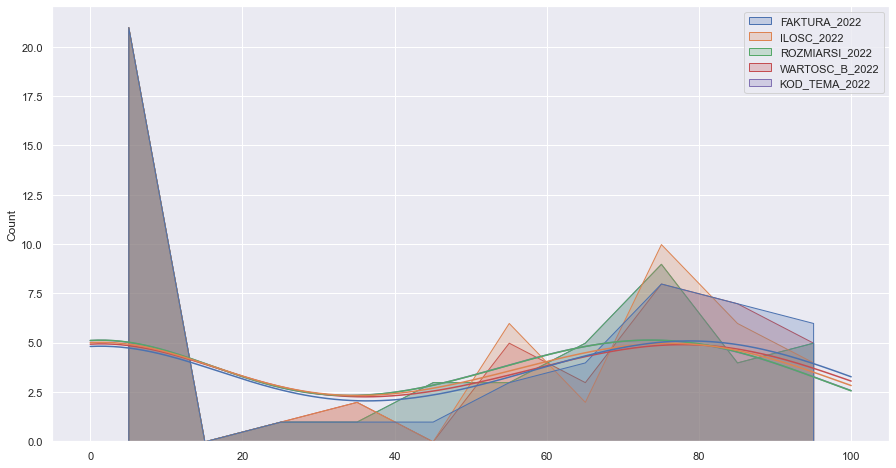

In [139]:
sns.histplot(tmp,
            kde=True,
             element="poly")#[['variable','value']],
            #  x='value',
            # color='variable')

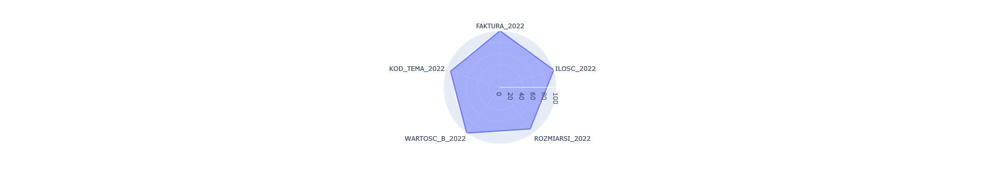

In [127]:

fig = px.line_polar(tmp2.loc[tmp2['TNACA_NAZWISKO']=='Ż. BARABASZ'],
                    r='value', theta='variable', line_close=True)
fig.update_traces(fill='toself')
fig.show()

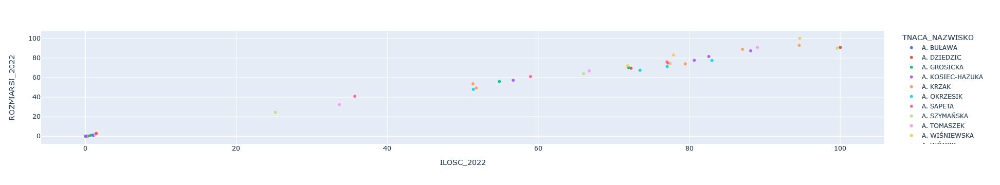

In [145]:
px.scatter(tmp,
              x='ILOSC_2022',
              y='ROZMIARSI_2022',
              #size='KOD_TEMA_2022',
              color='TNACA_NAZWISKO')

## big view

In [195]:
def func_pie_plot(df, co_rysowac, kolumna_do_rysowania,
                 title):
    fig=px.pie(df.groupby(['year']).agg(co_rysowac).reset_index(),
        values=kolumna_do_rysowania, names='year',
      width=500, height=400,
           hole=0.3,
          title=title)
    fig.show()

    fig=px.pie(df.loc[df['month']<=df.loc[df['year']==2022]['month'].max()-1].groupby(['year']).agg(co_rysowac).reset_index(),
            values=kolumna_do_rysowania, names='year',
          width=500, height=400,
               hole=0.3,
              title=title+' - do czerwca')
    fig.show()
    
    

def func_bar_plot(df, co_rysowac, kolumna_do_rysowania,
                  dzielnik, os_x1, os_x2,
                 title):
    _=df.groupby(['year']+[os_x1]).agg(co_rysowac).reset_index()
    _['year']=_['year'].astype(str)
    _[kolumna_do_rysowania+'_round']=round(_[kolumna_do_rysowania]/dzielnik, 1)
    fig=px.bar(_,
        y=kolumna_do_rysowania, x=os_x1, color='year', barmode='group', text=kolumna_do_rysowania+'_round',
          title=title)
    fig.show()
    
    if os_x1!=os_x2:
        _=df.groupby(['year']+[os_x2]).agg(co_rysowac).reset_index()
        _['year']=_['year'].astype(str)
        _[kolumna_do_rysowania+'_round']=round(_[kolumna_do_rysowania]/dzielnik, 1)
        fig=px.bar(_,
            y=kolumna_do_rysowania, x=os_x2, color='year', barmode='group', text=kolumna_do_rysowania+'_round',
              title=title+' - do czerwca')
        fig.show()
    else:
        _=df.loc[df['month']<=df.loc[df['year']==2022]['month'].max()-1].groupby(['year']+[os_x2]).agg(co_rysowac).reset_index()
        _['year']=_['year'].astype(str)
        _[kolumna_do_rysowania+'_round']=round(_[kolumna_do_rysowania]/dzielnik, 1)
        fig=px.bar(_,
            y=kolumna_do_rysowania, x=os_x2, color='year', barmode='group', text=kolumna_do_rysowania+'_round',
              title=title+' - do czerwca')
        fig.show()
    
def func_scatter_plot(df, co_rysowac, kolumna_do_rysowania,
                  dzielnik, os_x1, os_x2,
                 title):
    _=df.groupby(['year']+[os_x1]).agg(co_rysowac).reset_index()
    _['year']=_['year'].astype(str)
    _[kolumna_do_rysowania+'_round']=round(_[kolumna_do_rysowania]/dzielnik, 1)
    fig=px.line(_,
        y=kolumna_do_rysowania, x=os_x1, color='year', 
          title=title)
    fig.show()
    
    #return _
    
    if os_x1!=os_x2:
        _=df.groupby(['year']+[os_x2]).agg(co_rysowac).reset_index()
        _['year']=_['year'].astype(str)
        _[kolumna_do_rysowania+'_round']=round(_[kolumna_do_rysowania]/dzielnik, 1)
        fig=px.scatter(_,
            y=kolumna_do_rysowania, x=os_x2, color='year',
              title=title+' - do czerwca')
        fig.show()
    else:
        _=df.loc[df['month']<=df.loc[df['year']==2022]['month'].max()-1].groupby(['year']+[os_x2]).agg(co_rysowac).reset_index()
        _['year']=_['year'].astype(str)
        _[kolumna_do_rysowania+'_round']=round(_[kolumna_do_rysowania]/dzielnik, 1)
        fig=px.scatter(_,
            y=kolumna_do_rysowania, x=os_x2, color='year', 
              title=title+' - do czerwca')
        fig.show()
        
        
def func_box_plot(df, co_rysowac, kolumna_do_rysowania,
                  dzielnik, os_x1, os_x2,
                 title):
    _=df.groupby(['year']+[os_x1, os_x2]).agg(co_rysowac).reset_index()
    _['year']=_['year'].astype(str)
    # _[kolumna_do_rysowania+'_round']=round(_[kolumna_do_rysowania]/dzielnik, 1)
    fig=px.box(_,
        y=kolumna_do_rysowania, x=os_x1, color='year', 
          title=title)
    fig.show()

### unikatowe faktury na rok

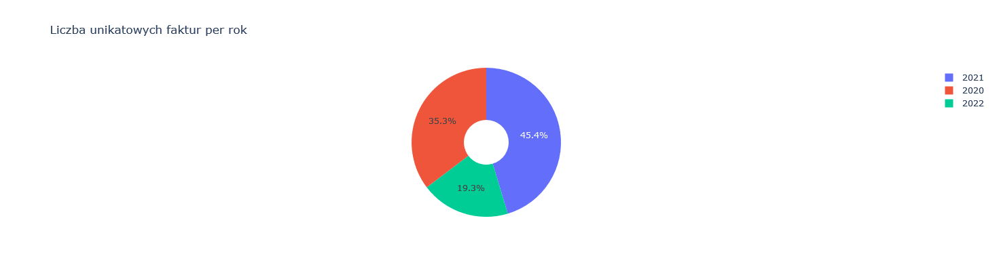

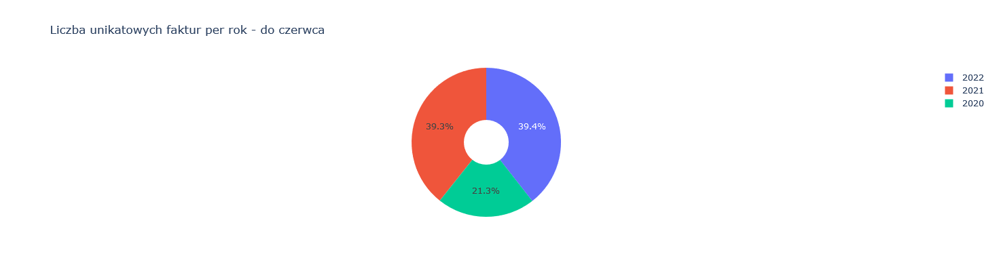

In [39]:
func_pie_plot(df, {'FAKTURA':'nunique'}, 'FAKTURA',
                 'Liczba unikatowych faktur per rok')

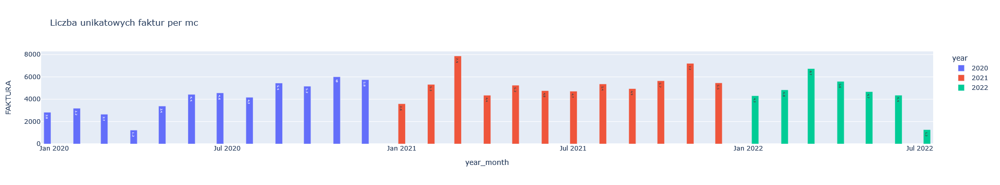

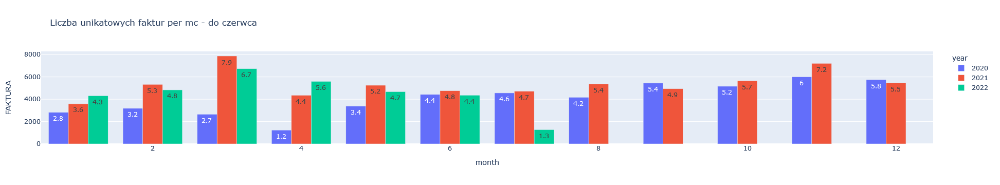

In [196]:
func_bar_plot(df, {'FAKTURA':'nunique'}, 'FAKTURA',
              1000,
                    'year_month','month',
            'Liczba unikatowych faktur per mc')

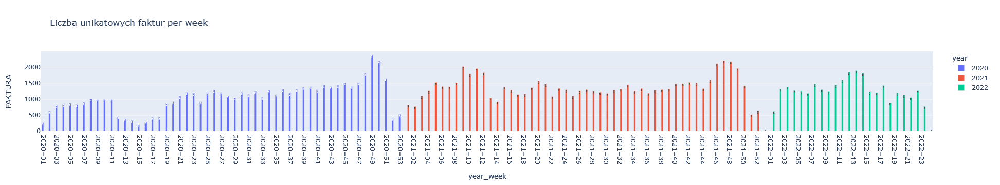

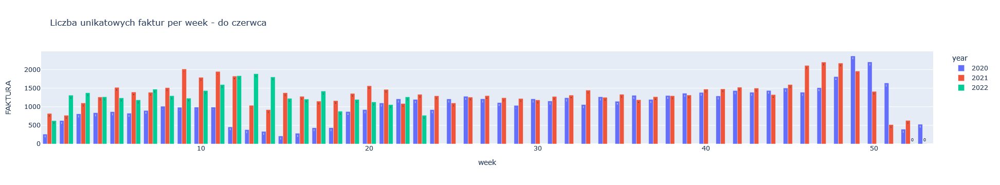

In [7]:
func_bar_plot(df, {'FAKTURA':'nunique'}, 'FAKTURA',
              1000,
                    'year_week','week',
            'Liczba unikatowych faktur per week')

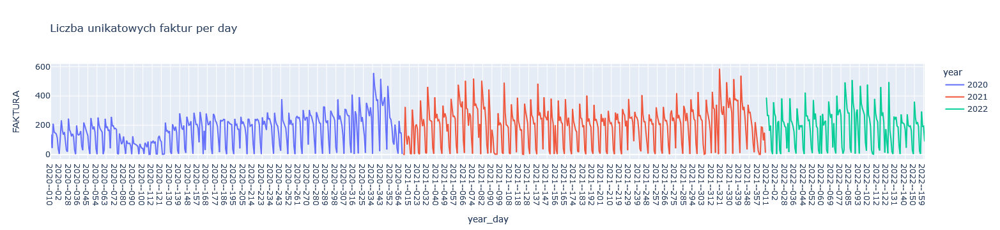

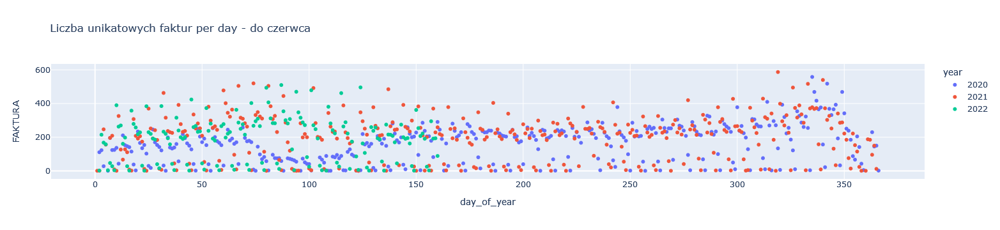

In [43]:
func_scatter_plot(df, {'FAKTURA':'nunique'}, 'FAKTURA',
              1000,
                    'year_day','day_of_year',
            'Liczba unikatowych faktur per day')

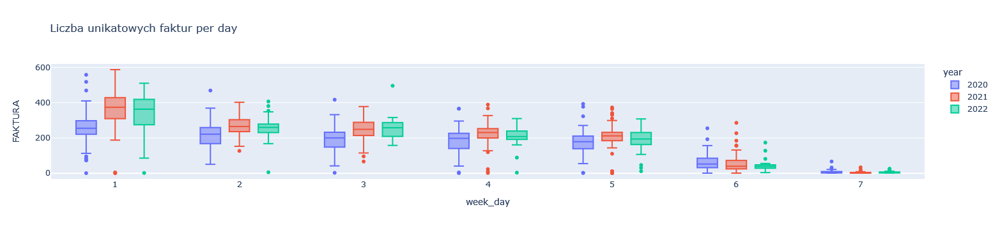

In [13]:
func_box_plot(df, {'FAKTURA':'nunique'}, 'FAKTURA',
              1000,
                    'week_day','day_of_year',
            'Liczba unikatowych faktur per day')

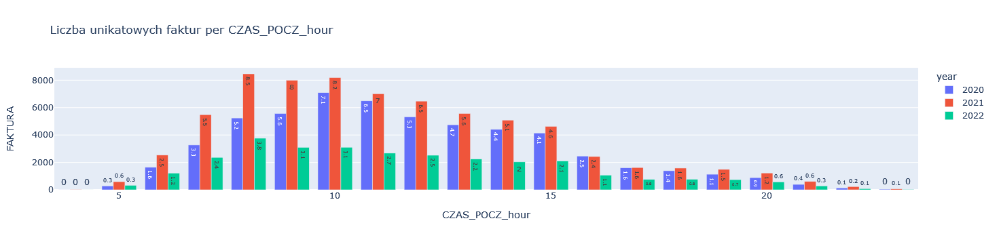

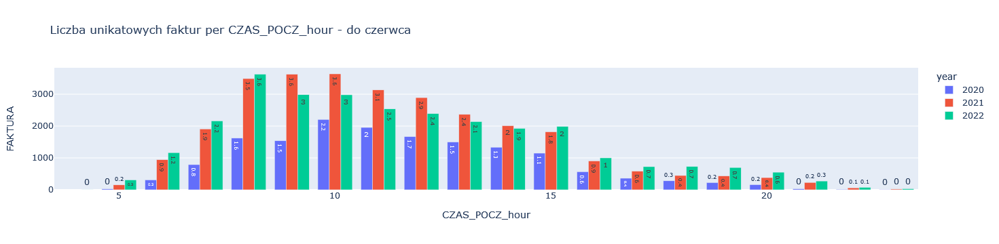

In [202]:
func_bar_plot(df, {'FAKTURA':'nunique'}, 'FAKTURA',
              1000,
                    'CZAS_POCZ_hour','CZAS_POCZ_hour',
            'Liczba unikatowych faktur per CZAS_POCZ_hour')

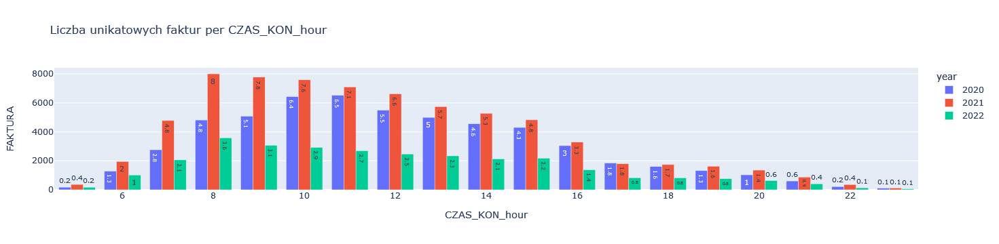

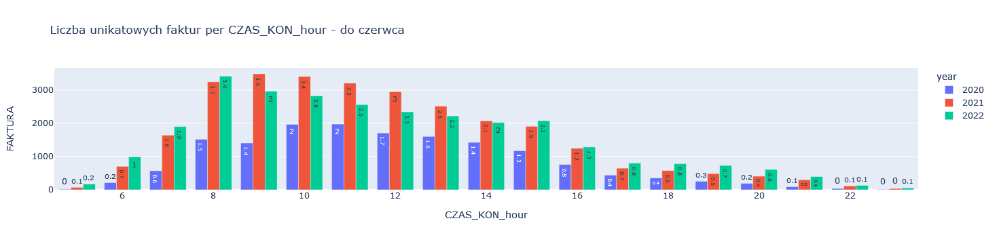

In [203]:
func_bar_plot(df, {'FAKTURA':'nunique'}, 'FAKTURA',
              1000,
                    'CZAS_KON_hour','CZAS_KON_hour',
            'Liczba unikatowych faktur per CZAS_KON_hour')

### dlugosc materialy per rok

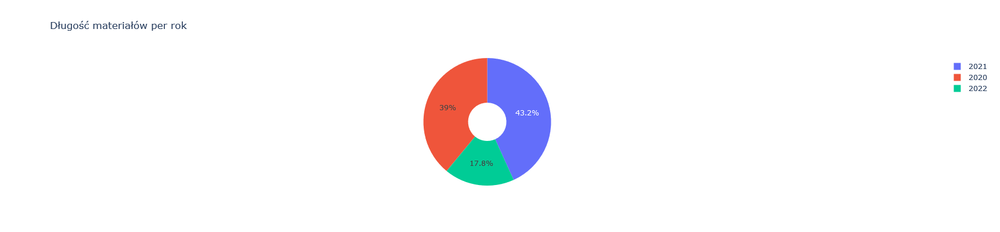

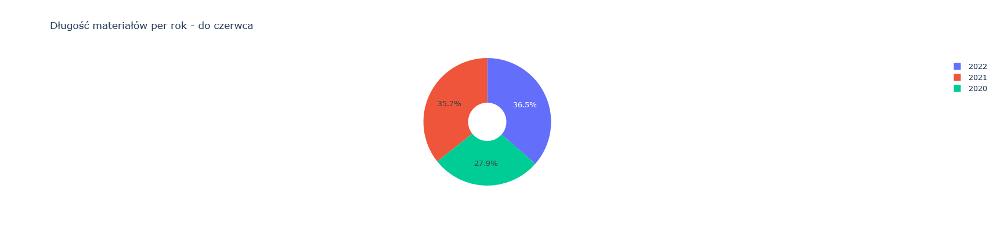

In [41]:
func_pie_plot(df, {'ILOSC':'sum'}, 'ILOSC',
                 'Długość materiałów per rok')

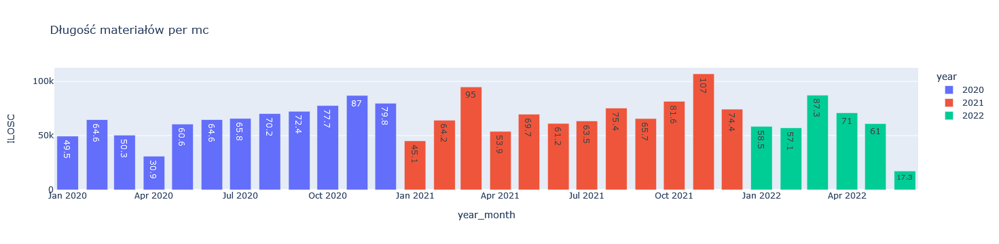

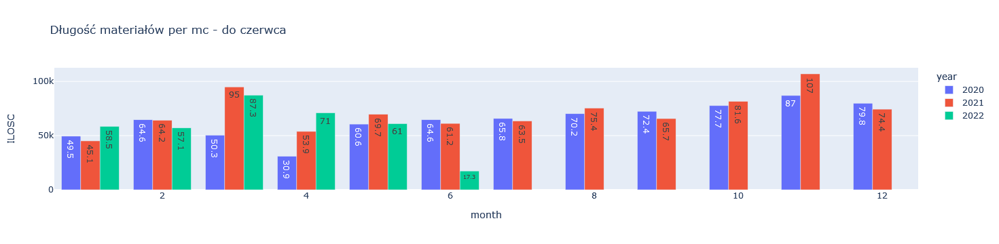

In [178]:
func_bar_plot(df, {'ILOSC':'sum'}, 'ILOSC',
              1000,
                    'year_month','month',
            'Długość materiałów per mc')

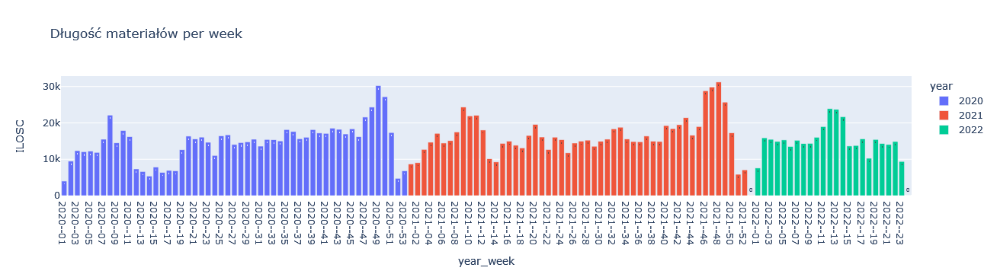

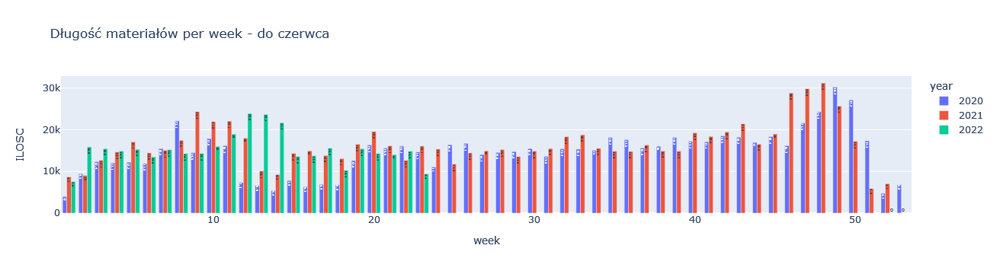

In [179]:
func_bar_plot(df, {'ILOSC':'sum'}, 'ILOSC',
              1000,
                    'year_week','week',
            'Długość materiałów per week')

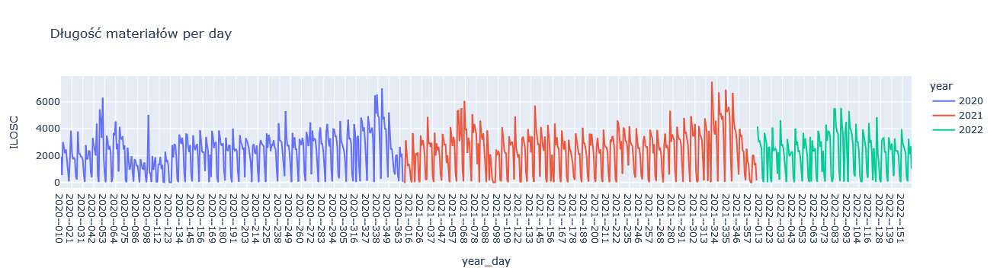

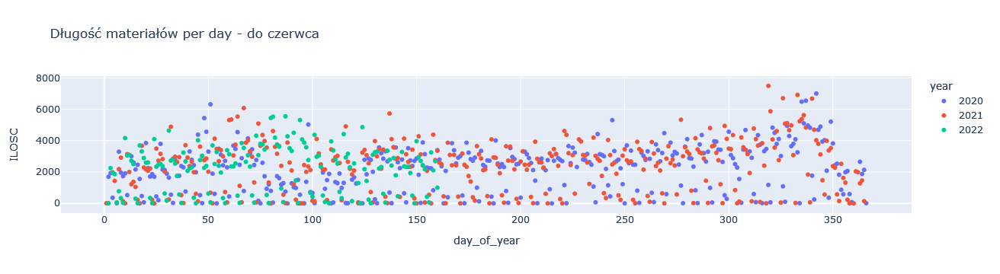

In [24]:
func_scatter_plot(df, {'ILOSC':'sum'}, 'ILOSC',
              1000,
                    'year_day','day_of_year',
            'Długość materiałów per day')

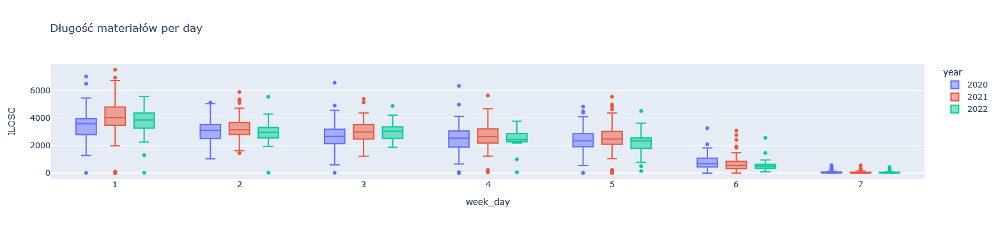

In [14]:
func_box_plot(df, {'ILOSC':'sum'}, 'ILOSC',
              1000,
                    'week_day','day_of_year',
            'Długość materiałów per day')

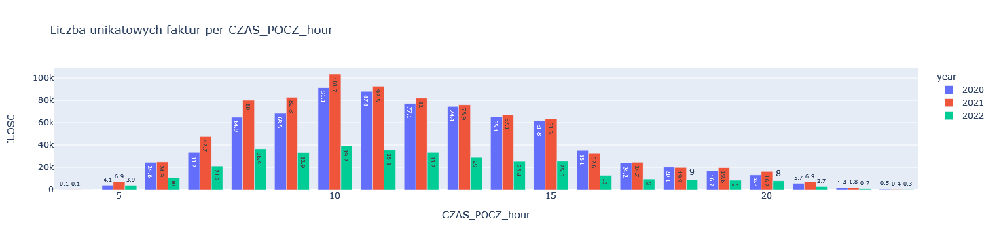

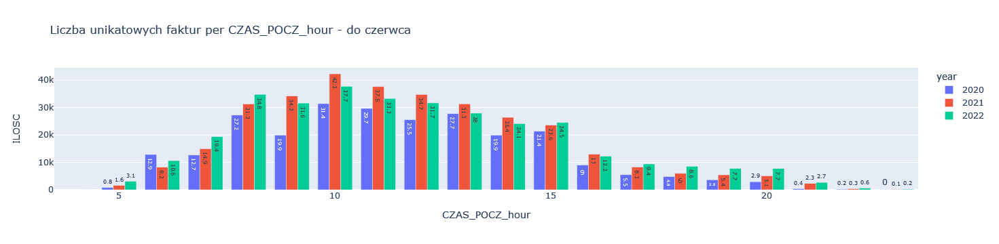

In [204]:
func_bar_plot(df, {'ILOSC':'sum'}, 'ILOSC',
              1000,
                    'CZAS_POCZ_hour','CZAS_POCZ_hour',
            'Liczba unikatowych faktur per CZAS_POCZ_hour')

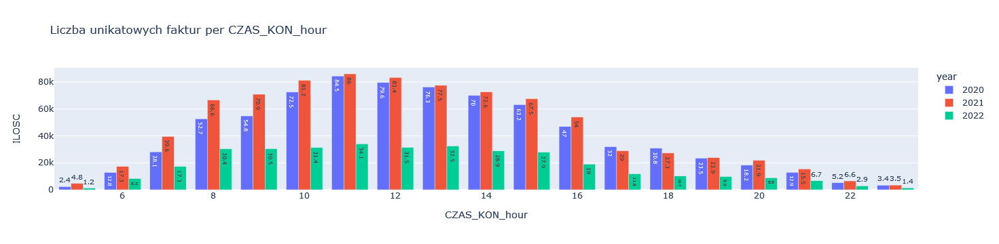

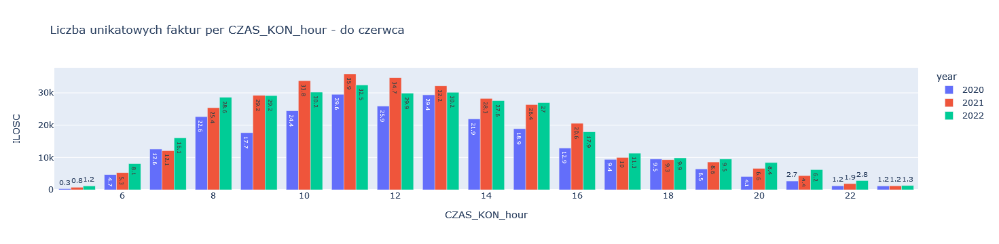

In [205]:
func_bar_plot(df, {'ILOSC':'sum'}, 'ILOSC',
              1000,
                    'CZAS_KON_hour','CZAS_KON_hour',
            'Liczba unikatowych faktur per CZAS_KON_hour')

### dlugosc materialu per faktura

## czasy rozpoczecia

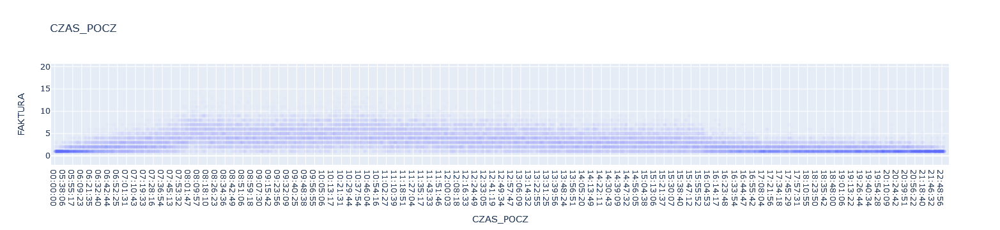

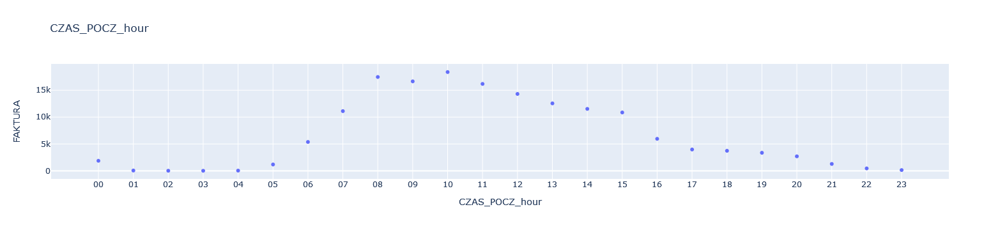

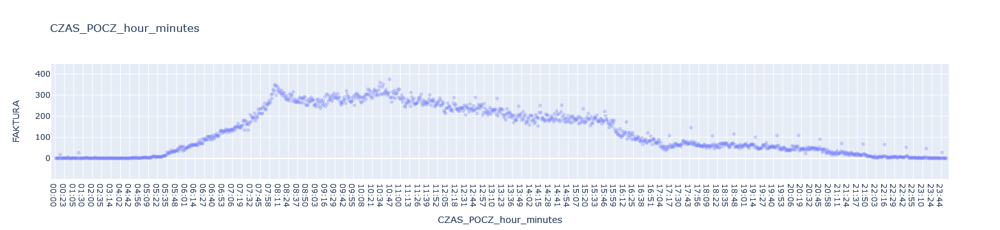

In [111]:
for i,opa in zip(['CZAS_POCZ', 'CZAS_POCZ_hour', 'CZAS_POCZ_hour_minutes'],
            [0.01,1,0.3]):
    fig=px.scatter(df.groupby(i).agg({'FAKTURA':'nunique'}).reset_index(),
           x=i, y='FAKTURA', opacity=opa,
              title=i)
    fig.show()

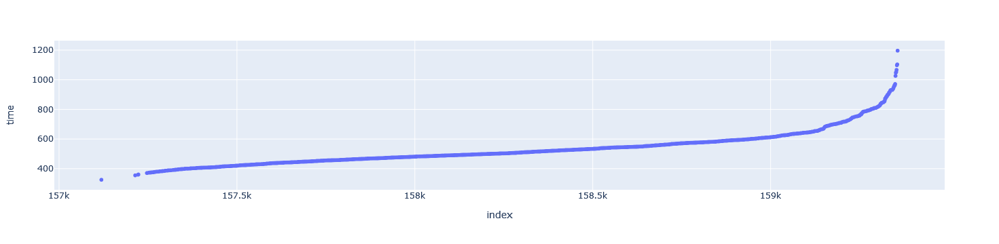

515.7166666666667


In [129]:
fig=px.scatter(df_with_time_per_fv.loc[df_with_time_per_fv['CZAS_POCZ_hour_minutes']=='00:00'],
           y='time')
fig.show()
print(df_with_time_per_fv.loc[df_with_time_per_fv['CZAS_POCZ_hour_minutes']=='00:00']['time'].median())

In [172]:
# fig=px.scatter(df_with_time_per_fv.loc[df_with_time_per_fv['CZAS_POCZ_hour_minutes']!='00:00'].\
#                                loc[df_with_time_per_fv['time']>0],
#            y='time')
# fig.show()
print(df_with_time_per_fv.loc[df_with_time_per_fv['CZAS_POCZ_hour_minutes']!='00:00'].\
                               loc[df_with_time_per_fv['time']>0]['time'].median())

10.666666666666666


## liczba unikatowych kodow tema

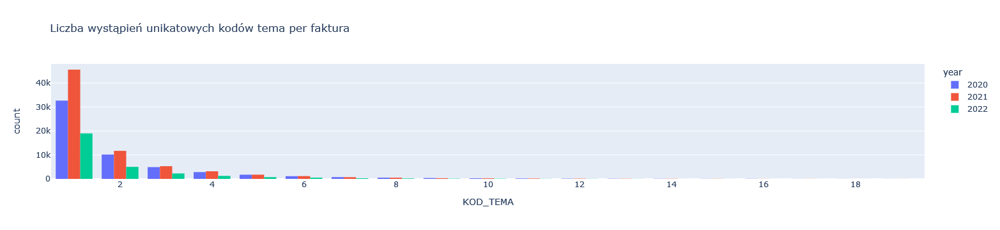

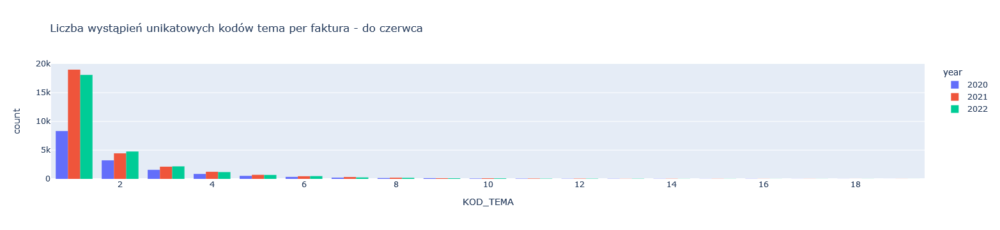

In [94]:
_=df.groupby(['FAKTURA','year']).agg({'KOD_TEMA':'count'}).reset_index()
fig=px.histogram(_.loc[_['KOD_TEMA']<20],
                 x='KOD_TEMA',
                 color='year',barmode='group',
                log_y=False,
                title='Liczba wystąpień unikatowych kodów tema per faktura')
fig.show()
_=df.loc[df['month']<=df.loc[df['year']==2022]['month'].max()-1].\
        groupby(['FAKTURA','year']).agg({'KOD_TEMA':'count'}).reset_index()
fig=px.histogram(_.loc[_['KOD_TEMA']<20],
                 x='KOD_TEMA',
                 color='year',barmode='group',
                log_y=False,
                title='Liczba wystąpień unikatowych kodów tema per faktura - do czerwca')
fig.show()

<AxesSubplot:xlabel='KOD_TEMA', ylabel='Count'>

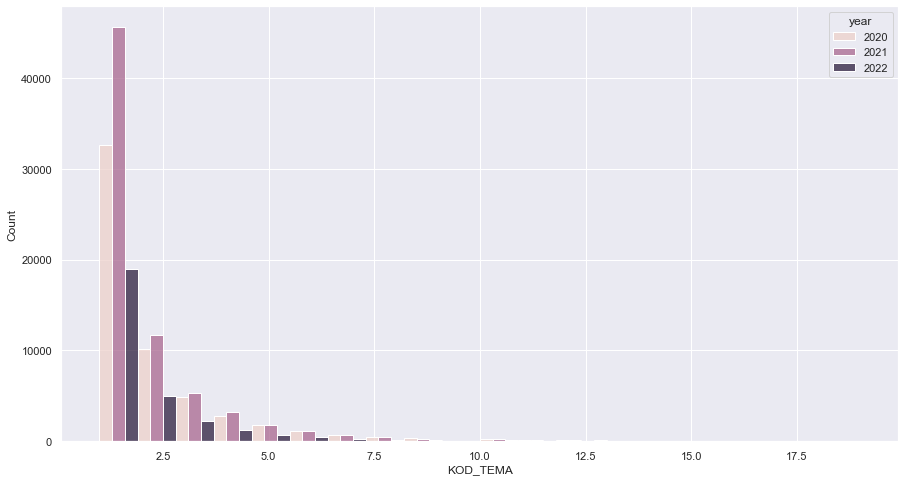

In [93]:
_=df.groupby(['FAKTURA','year']).agg({'KOD_TEMA':'count'}).reset_index()
sns.histplot(_.loc[_['KOD_TEMA']<20],
             x='KOD_TEMA',
            bins=20, log_scale=False,
            hue="year",
            multiple="dodge")#.groupby('KOD_TEMA').agg({'FAKTURA':'nunique'})

In [13]:
df.columns

Index(['FAKTURA', 'DOKUMENT', 'Z_DNIA', 'TYP_DOKUM', 'CZAS_POCZ', 'CZAS_KON',
       'CZAS_ZAPIS', 'NAZWA', 'RODZAJ', 'KOD_TEMA', 'ILOSC', 'TNACA1',
       'TNACA2', 'date_start', 'date_finish', 'year', 'CZAS_POCZ_hour',
       'CZAS_POCZ_minutes', 'CZAS_POCZ_hour_minutes', 'CZAS_KON_hour',
       'CZAS_KON_minutes', 'CZAS_KON_hour_minutes', 'TNACA1_NAZWISKO',
       'TNACA2_NAZWISKO', 'STOL', 'STOL_NAZWISKO', 'min_dzien_pracy_tnaca1',
       'max_dzien_pracy_tnaca1', 'liczba_unikatowych_dni_pracy_tnaca1'],
      dtype='object')

In [14]:
df_with_time_per_fv.columns

Index(['DOKUMENT', 'CZAS_POCZ_hour_minutes', 'TNACA2_NAZWISKO',
       'TNACA1_NAZWISKO', 'CZAS_KON_minutes', 'CZAS_KON_hour',
       'min_dzien_pracy_tnaca1', 'TNACA2', 'TNACA1', 'date_start', 'STOL',
       'CZAS_POCZ', 'CZAS_POCZ_hour', 'CZAS_KON',
       'liczba_unikatowych_dni_pracy_tnaca1', 'date_finish',
       'max_dzien_pracy_tnaca1', 'CZAS_POCZ_minutes', 'year', 'CZAS_ZAPIS',
       'FAKTURA', 'TYP_DOKUM', 'CZAS_KON_hour_minutes', 'Z_DNIA',
       'STOL_NAZWISKO', 'KOD_TEMA', 'ILOSC', 'time'],
      dtype='object')